In [1]:
import numpy as np 
from scipy.optimize import *

import matplotlib.pyplot as plt
import seaborn as sns

from parameters import *
from models.game_theory_model import *
from models.game import *
from plot_function import *

sns.set_style('ticks',  {"axes.grid" : "True", "grid.color": ".4", "grid.linestyle": ":"})
sns.set_context('paper')
plt.rcParams.update({'mathtext.default':  'regular' })
plt.rcParams['xtick.direction'] = 'out'
plt.rcParams['ytick.labelsize']  =15
plt.rcParams['xtick.labelsize']  =15
plt.rcParams['legend.fontsize']  = 16
plt.rcParams['axes.labelsize' ] = 16
plt.rcParams['font.size'] = 16
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['axes.formatter.useoffset'] = False

figsize = (8,5)

In [2]:
import pandas as pd

data = pd.read_csv('data/rcp_data.csv')
RCP_26 = data.loc[data['Scenario'] == 'RCP-2.6'].to_numpy()[0][8:] * co2_to_C**-1
RCP_85 = data.loc[data['Scenario'] == 'RCP-8.5'].to_numpy()[0][8:] * co2_to_C**-1
RCP_60 = data.loc[data['Scenario'] == 'RCP-6.0'].to_numpy()[0][8:] * co2_to_C**-1

temp_RCP26 = SCM.evaluate_trajectory(RCP_26)[-1]
temp_RCP85 = SCM.evaluate_trajectory(RCP_85)[-1]
temp_RCP60 = SCM.evaluate_trajectory(RCP_60)[-1]

In [3]:
# puissance de la fonction damage 

# Coefficients de la fonction dammage (pour un polynome de degré 2)


list_damage_coef = [np.array([0,1]), np.array([0,0,1.1450]), np.array([0,0,2,0])] #, np.array([0,0,0,0,1])]
list_damage_label = ['$T$', '$1.145T^2$ : [Howard 2017]', '$2T^2$'] #,  '$T^4$']

# Legende

In [18]:
one_shot_style = { 'marker' : '.' ,'markevery' : 5, 'ms' : 10, 'lw' : 2}
so_style = { 'ls' : '--' }
planning_style = { 'marker' : 's' ,'markevery' : 5}
alpha = 0.7

In the following, the solid lines represent the NE and the dashed line the SO optimum. 

Also, the one shot game is repsented with dots and the planning with squares.

# One shot game

## Concave polynomial

In [19]:
list_benefit_functions=BENEFITS_CONCAVE
case = 'concave_up'

### Update allowed

In [20]:
update_allowed = True

### Horizon = 2100

In [21]:
horizon = 2100

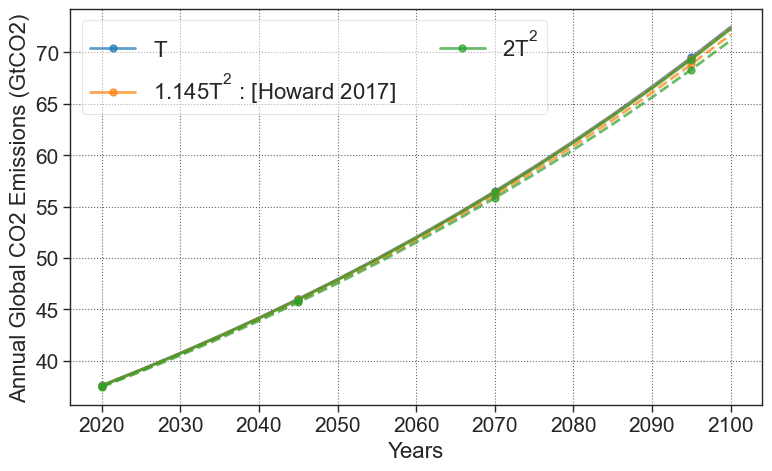

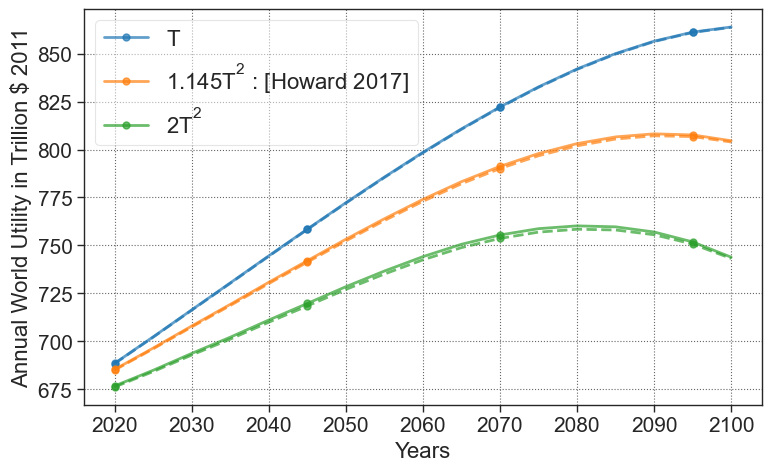

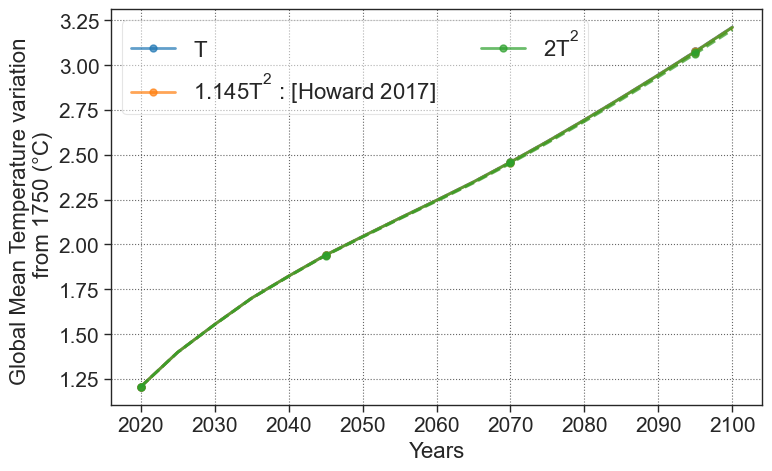

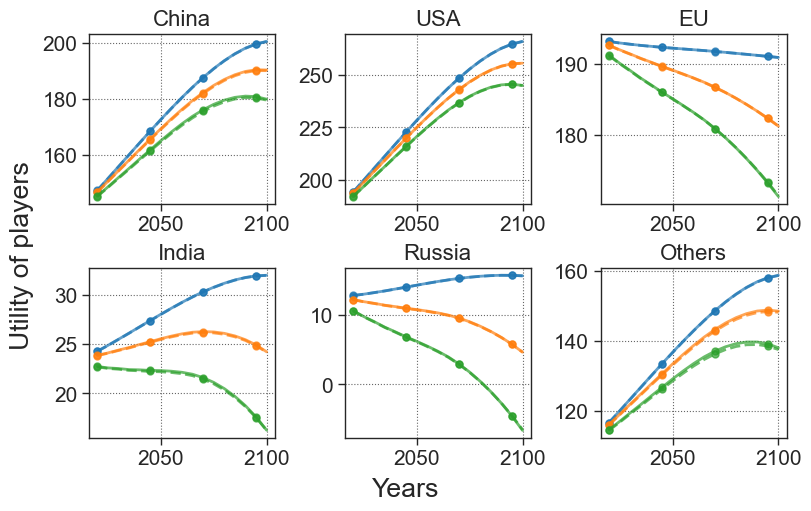

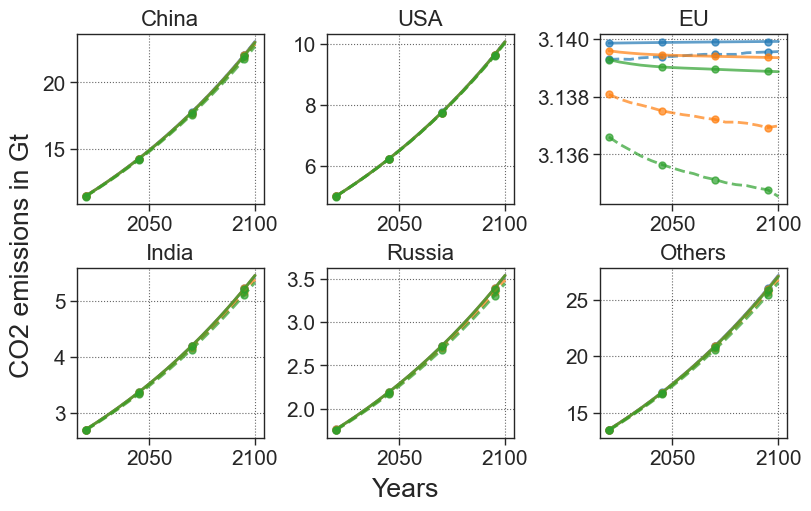

In [22]:
list_ne = []
list_ne_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_so = []
list_so_u = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []


for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, update_allowed=update_allowed)

    X = 2020 + np.arange(game.T)*5

    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    list_so.append(game.so_a_p)
    list_so_u.append(game.so_u_p)
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)


plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style , alpha = alpha, **one_shot_style)

# plt.plot(X[:len(RCP_26)], RCP_26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha, **one_shot_style)

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha, **one_shot_style)
# plt.plot(X[:len(temp_RCP26)], temp_RCP26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne_u, list_so_u):
        p = axes[k//3, k%3].plot(X, ne_u[k], alpha = alpha, **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style,alpha = alpha, **one_shot_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')

plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne, list_so):
        p = axes[k//3, k%3].plot(X, ne_u[k], alpha = alpha, **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style,alpha = alpha, **one_shot_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

### Horizon = 2200

In [9]:
horizon = 2200

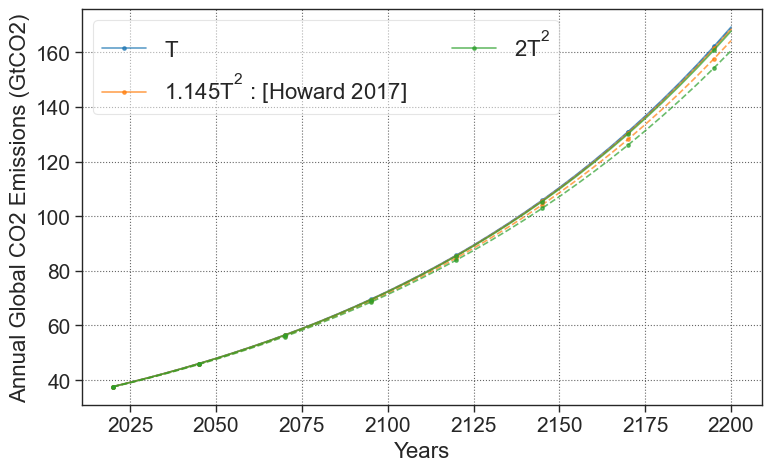

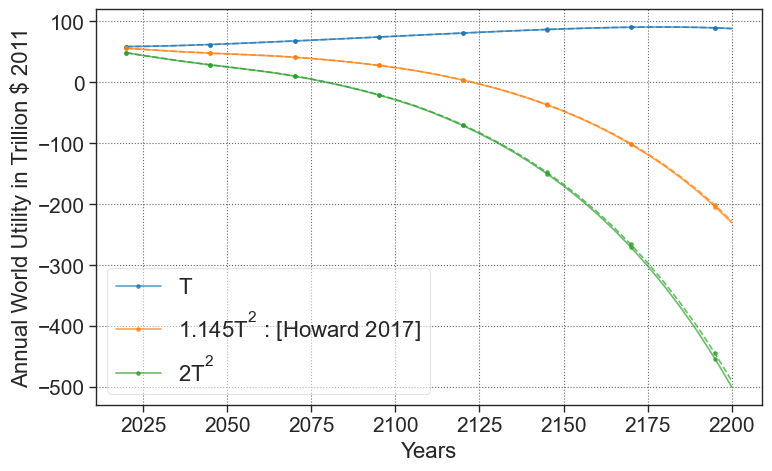

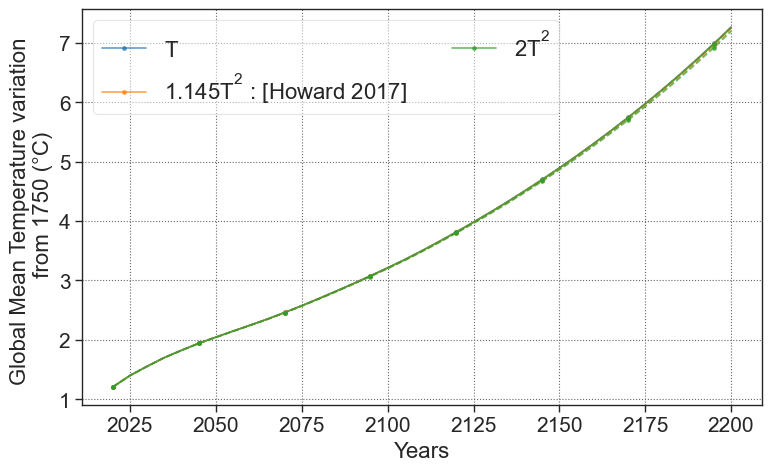

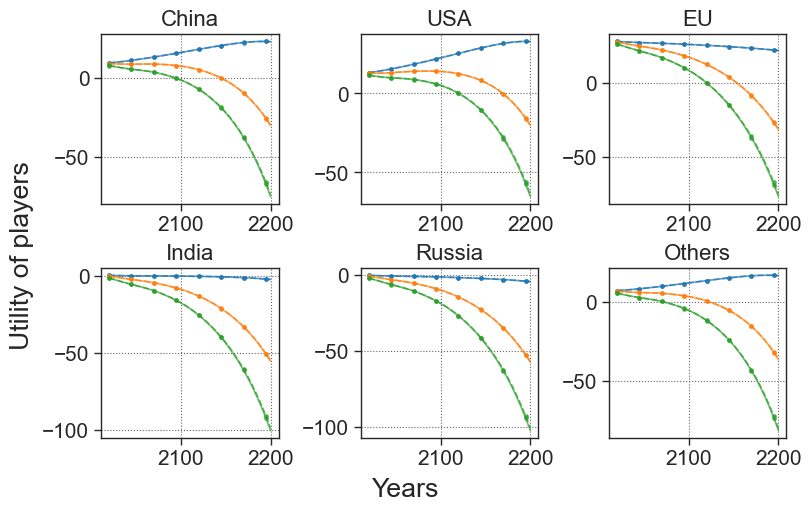

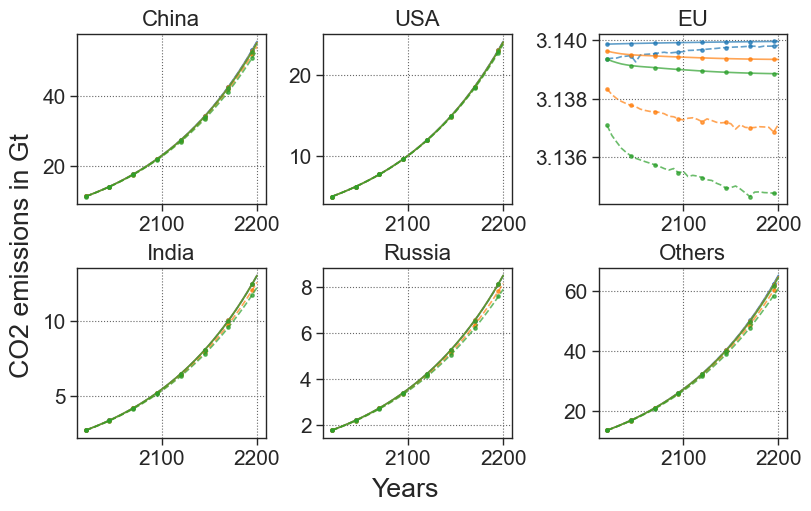

In [10]:
list_ne = []
list_ne_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_so = []
list_so_u = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, update_allowed=update_allowed)

    X = 2020 + np.arange(game.T)*5

    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    list_so.append(game.so_a_p)
    list_so_u.append(game.so_u_p)
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)


plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha, **one_shot_style)

# plt.plot(X[:len(RCP_26)], RCP_26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha, **one_shot_style)

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha, **one_shot_style)
# plt.plot(X[:len(temp_RCP26)], temp_RCP26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne_u, list_so_u):
        p = axes[k//3, k%3].plot(X, ne_u[k], alpha = alpha, **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style,alpha = alpha, **one_shot_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')

plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne, list_so):
        p = axes[k//3, k%3].plot(X, ne_u[k], alpha = alpha, **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style,alpha = alpha, **one_shot_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

### Update Not allowed

In [11]:
update_allowed = False
case ='concave_no_up'

### Horizon = 2100

In [12]:
horizon = 2100

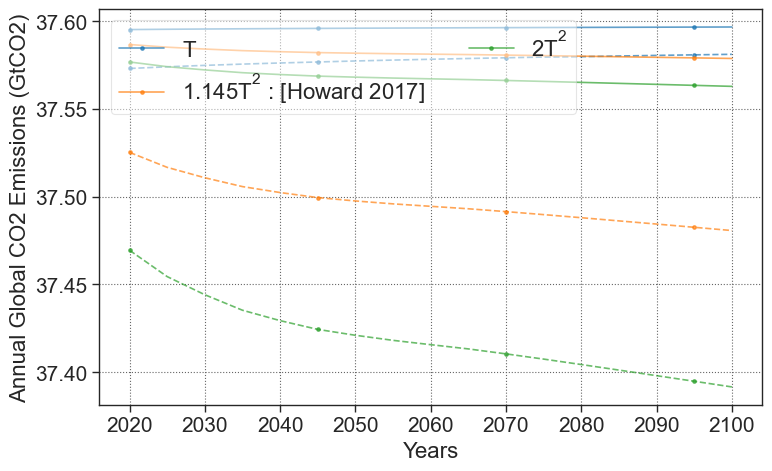

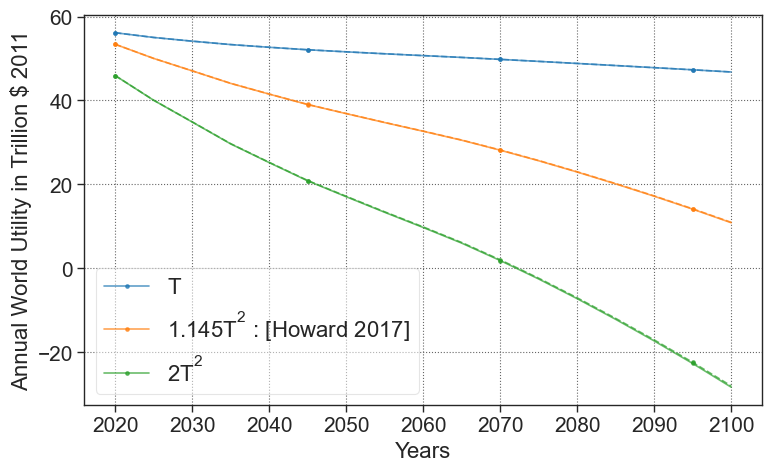

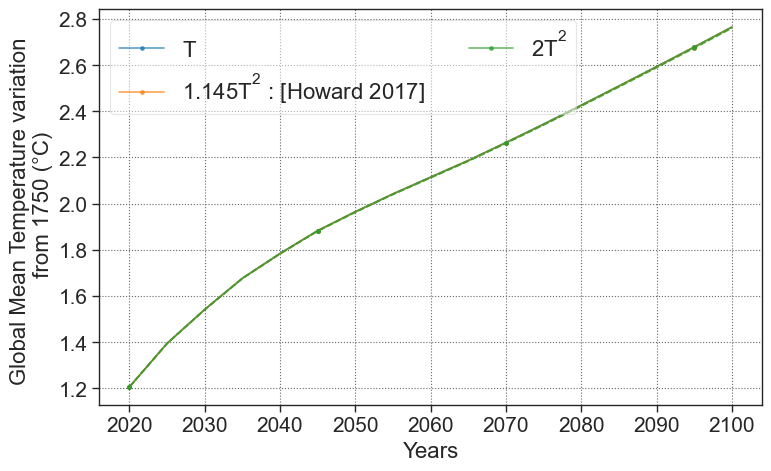

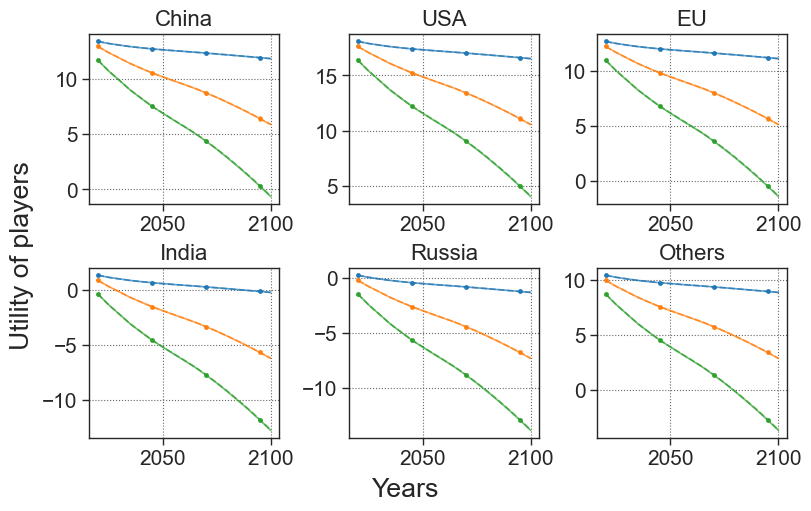

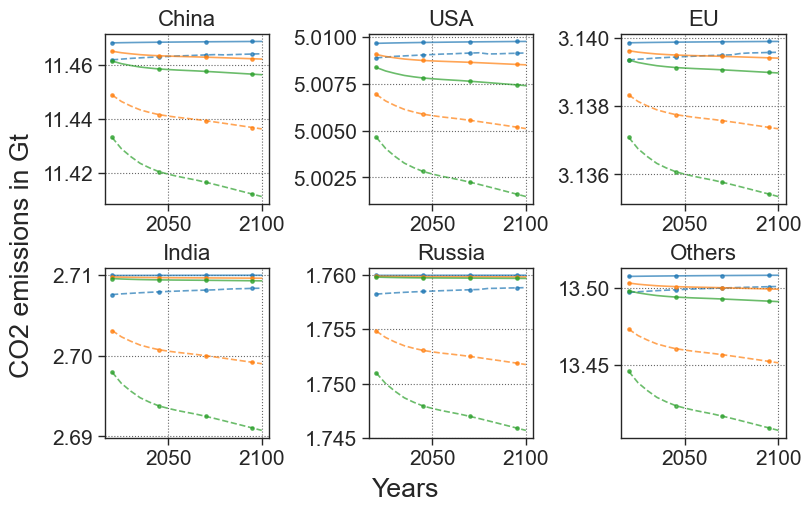

In [13]:
list_ne = []
list_ne_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_so = []
list_so_u = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, update_allowed=False)

    X = 2020 + np.arange(game.T)*5

    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    list_so.append(game.so_a_p)
    list_so_u.append(game.so_u_p)
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)


plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha, **one_shot_style)

# plt.plot(X[:len(RCP_26)], RCP_26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha, **one_shot_style)

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha, **one_shot_style)
# plt.plot(X[:len(temp_RCP26)], temp_RCP26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne_u, list_so_u):
        p = axes[k//3, k%3].plot(X, ne_u[k], alpha = alpha, **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style,alpha = alpha, **one_shot_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')

plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne, list_so):
        p = axes[k//3, k%3].plot(X, ne_u[k], alpha = alpha, **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style,alpha = alpha, **one_shot_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

### Horizon = 2200

In [14]:
horizon = 2200

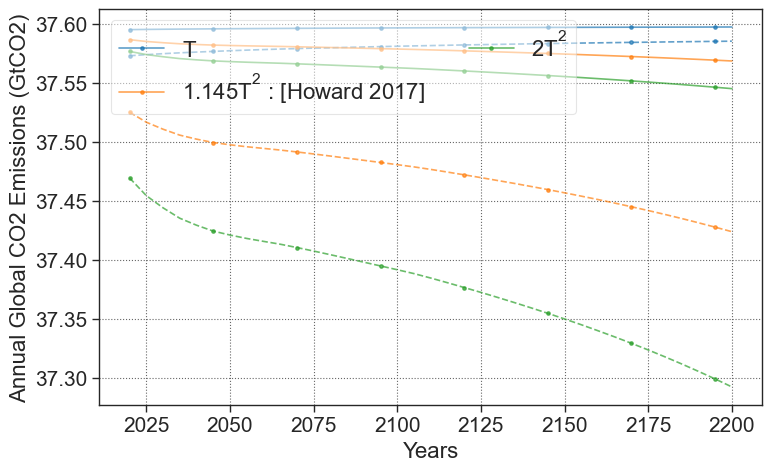

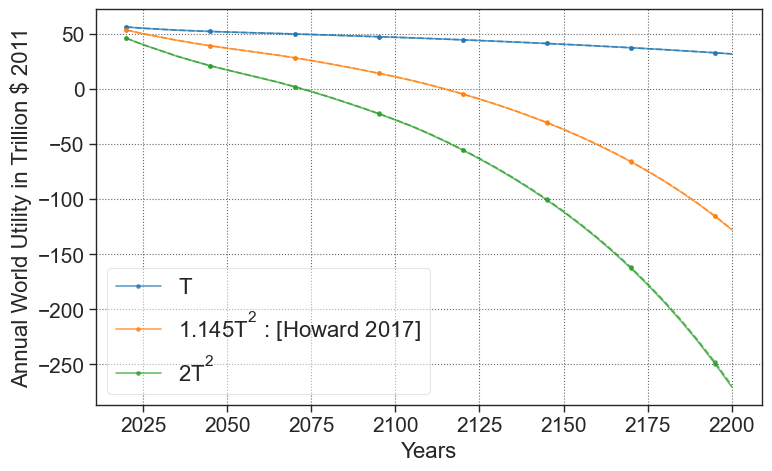

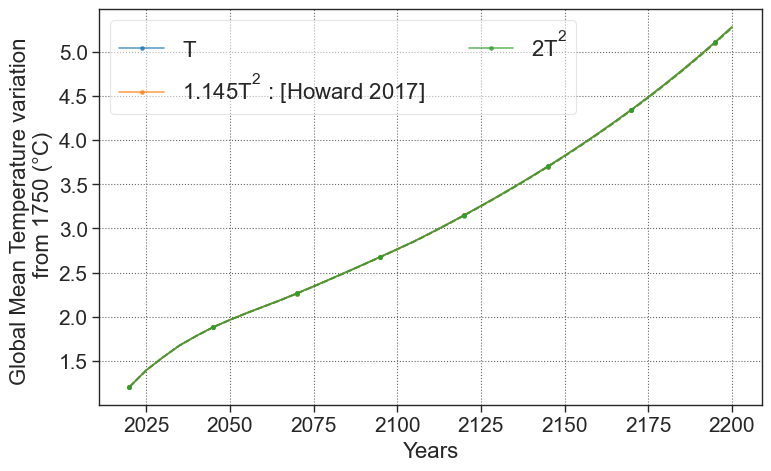

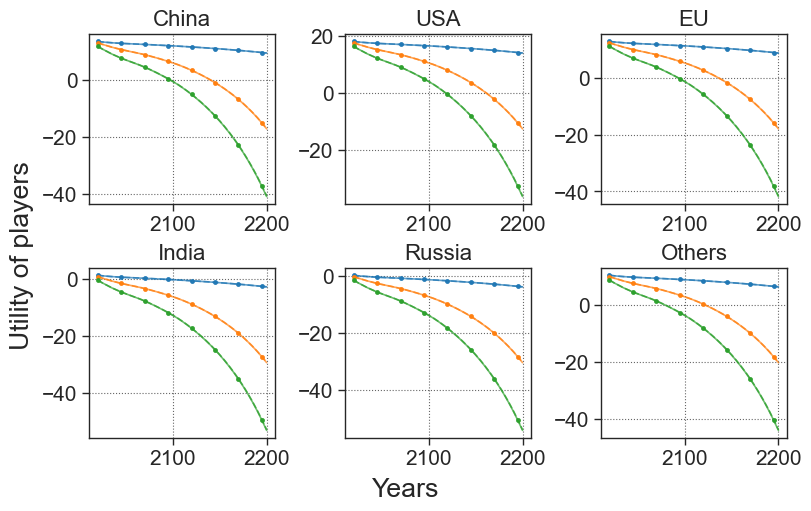

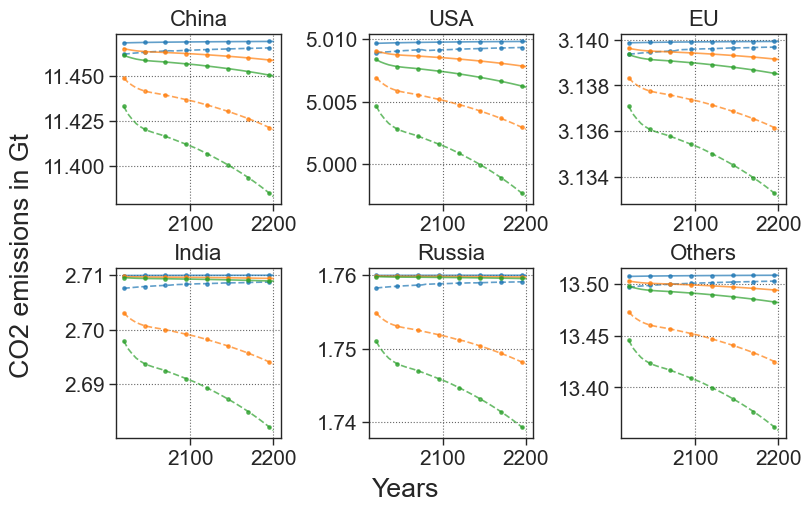

In [15]:
list_damage_coef = [np.array([0,1]), np.array([0,0,1.1450]), np.array([0,0,2])] #, np.array([0,0,0,0,1])]
list_damage_label = ['$T$', '$1.145T^2$ : [Howard 2017]', '$2T^2$'] #,  '$T^4$']

list_ne = []
list_ne_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_so = []
list_so_u = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, update_allowed=False)

    X = 2020 + np.arange(game.T)*5

    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    list_so.append(game.so_a_p)
    list_so_u.append(game.so_u_p)
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)


plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha, **one_shot_style)

# plt.plot(X[:len(RCP_26)], RCP_26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha, **one_shot_style)

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha, **one_shot_style)
# plt.plot(X[:len(temp_RCP26)], temp_RCP26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne_u, list_so_u):
        p = axes[k//3, k%3].plot(X, ne_u[k], alpha = alpha, **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style,alpha = alpha, **one_shot_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')

plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne, list_so):
        p = axes[k//3, k%3].plot(X, ne_u[k], alpha = alpha, **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style,alpha = alpha, **one_shot_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

## Concave log

In [16]:
list_benefit_functions = BENEFITS_LOG
case = 'log_up'

### Update allowed

In [17]:
update_allowed = True

### Horizon = 2100

In [18]:
horizon = 2100

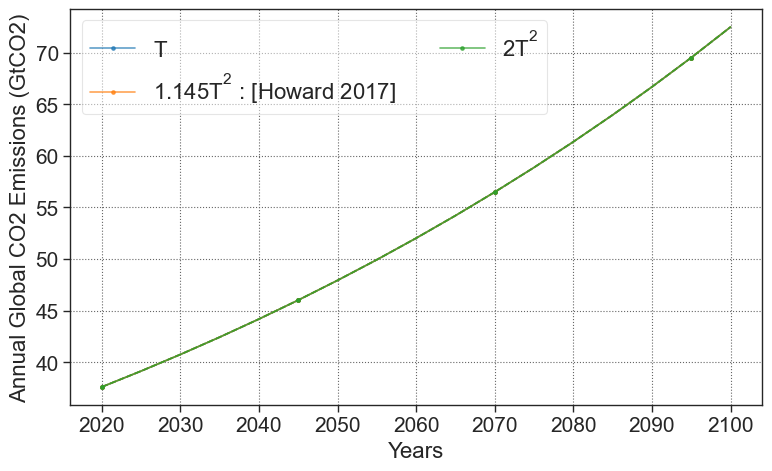

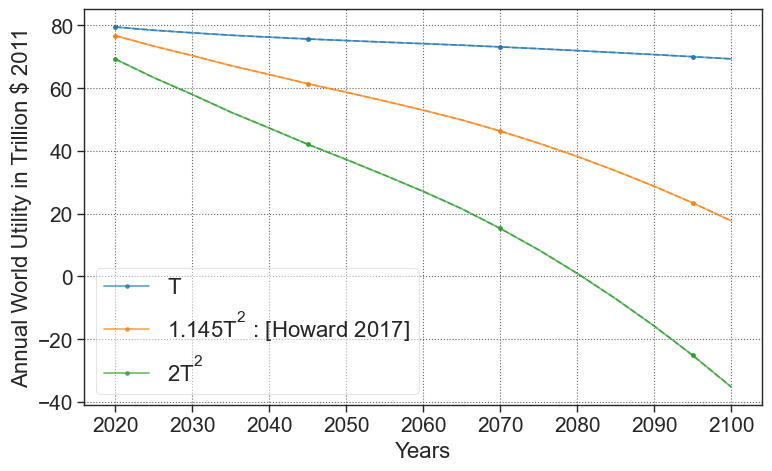

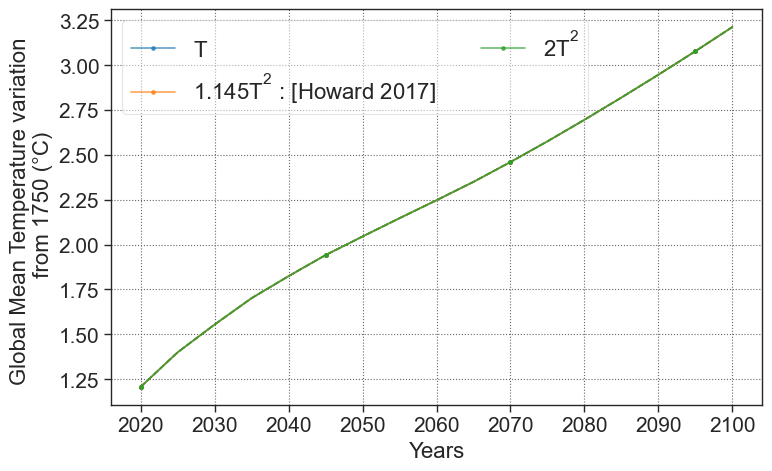

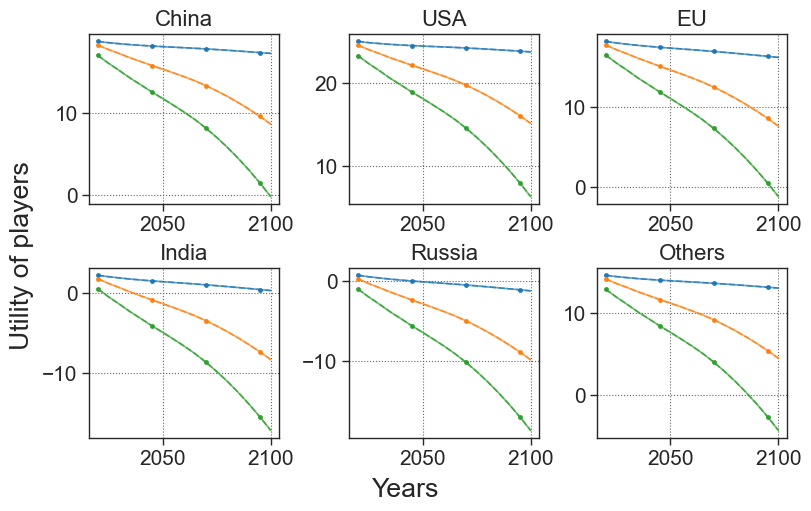

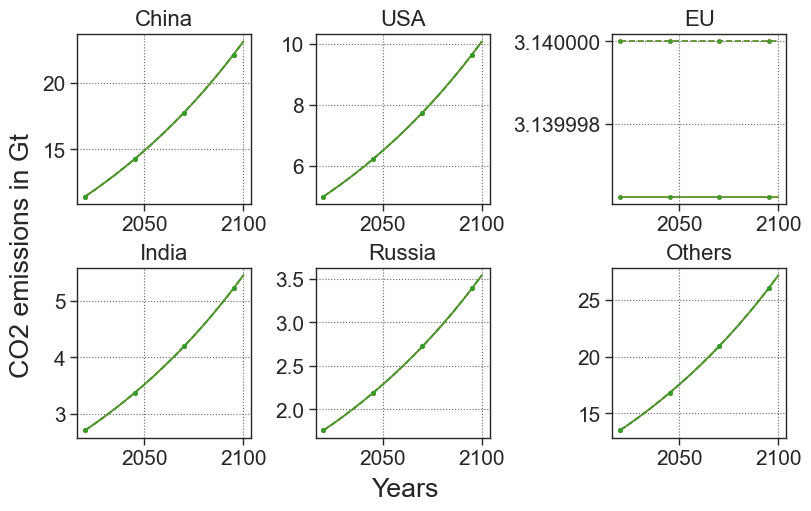

In [19]:
list_ne = []
list_ne_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_so = []
list_so_u = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []


for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, update_allowed=update_allowed)

    X = 2020 + np.arange(game.T)*5

    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    list_so.append(game.so_a_p)
    list_so_u.append(game.so_u_p)
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)


plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style , alpha = alpha, **one_shot_style)

# plt.plot(X[:len(RCP_26)], RCP_26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha, **one_shot_style)

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha, **one_shot_style)
# plt.plot(X[:len(temp_RCP26)], temp_RCP26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne_u, list_so_u):
        p = axes[k//3, k%3].plot(X, ne_u[k], alpha = alpha, **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style,alpha = alpha, **one_shot_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')

plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne, list_so):
        p = axes[k//3, k%3].plot(X, ne_u[k], alpha = alpha, **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style,alpha = alpha, **one_shot_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

### Horizon = 2200

In [20]:
horizon = 2200

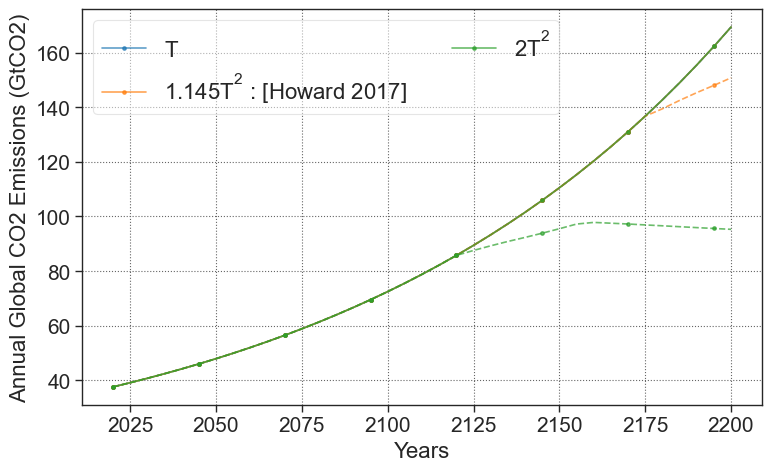

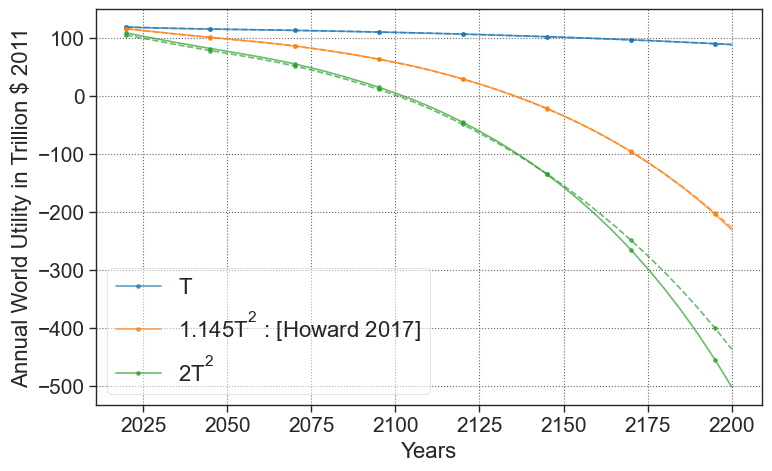

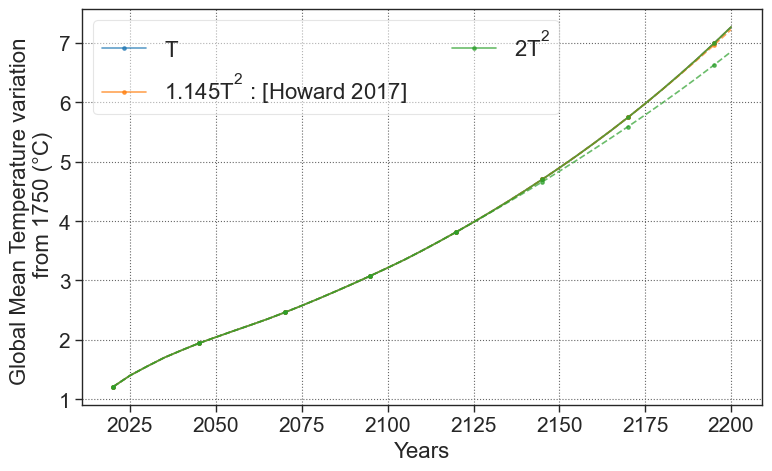

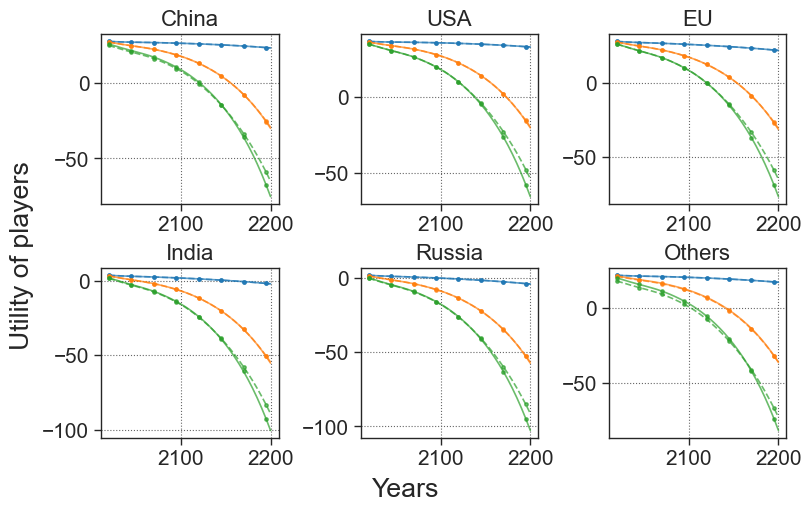

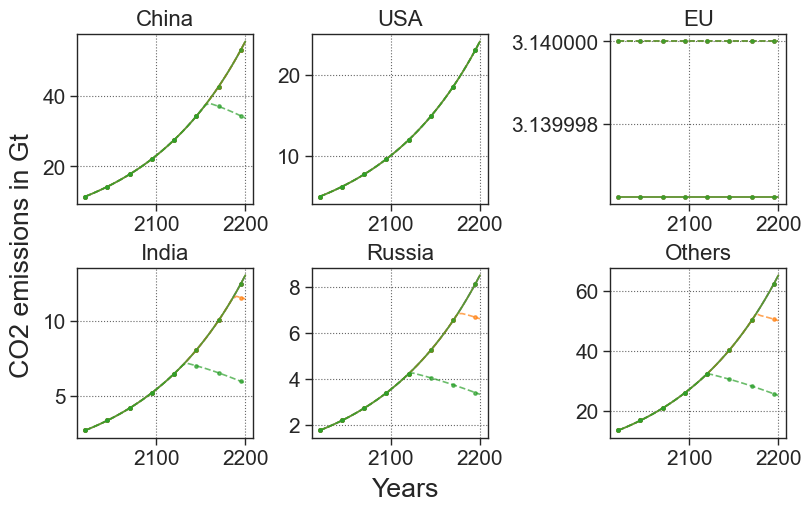

In [21]:
list_ne = []
list_ne_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_so = []
list_so_u = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, update_allowed=update_allowed)

    X = 2020 + np.arange(game.T)*5

    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    list_so.append(game.so_a_p)
    list_so_u.append(game.so_u_p)
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)


plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha, **one_shot_style)

# plt.plot(X[:len(RCP_26)], RCP_26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha, **one_shot_style)

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha, **one_shot_style)
# plt.plot(X[:len(temp_RCP26)], temp_RCP26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne_u, list_so_u):
        p = axes[k//3, k%3].plot(X, ne_u[k], alpha = alpha, **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style,alpha = alpha, **one_shot_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')

plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne, list_so):
        p = axes[k//3, k%3].plot(X, ne_u[k], alpha = alpha, **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style,alpha = alpha, **one_shot_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

### Update Not allowed

In [22]:
update_allowed = False
case = 'log_no_up'

### Horizon = 2100

In [23]:
horizon = 2100

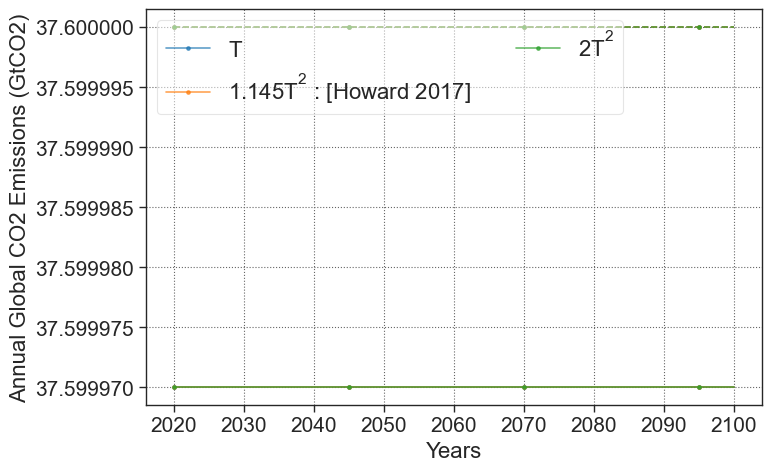

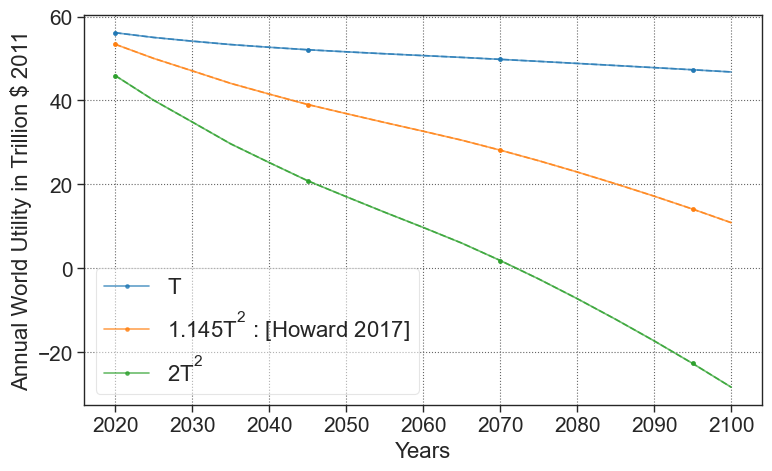

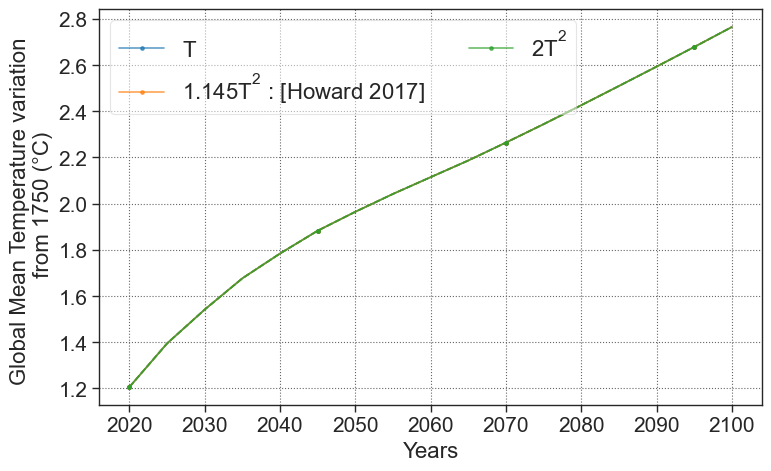

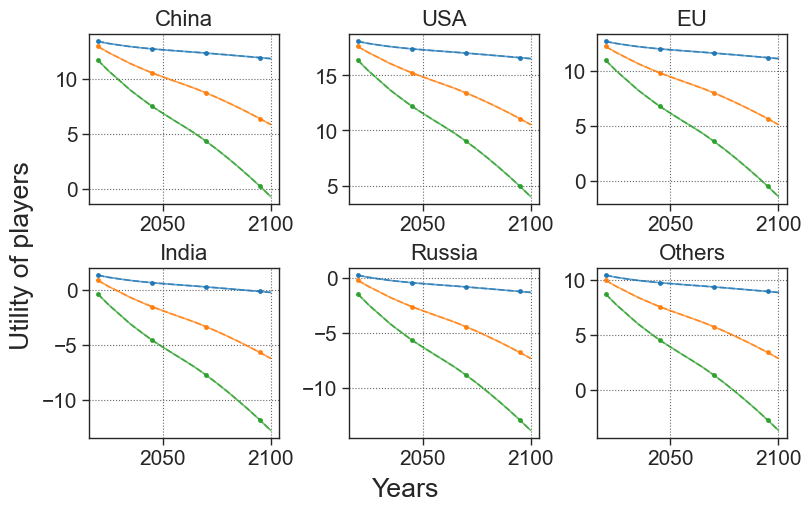

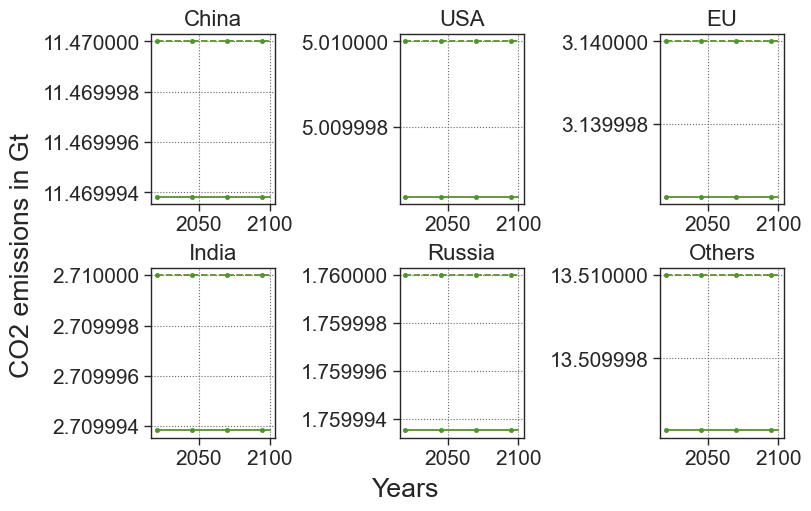

In [24]:
list_ne = []
list_ne_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_so = []
list_so_u = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, update_allowed=False)

    X = 2020 + np.arange(game.T)*5

    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    list_so.append(game.so_a_p)
    list_so_u.append(game.so_u_p)
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)


plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha, **one_shot_style)

# plt.plot(X[:len(RCP_26)], RCP_26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha, **one_shot_style)

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha, **one_shot_style)
# plt.plot(X[:len(temp_RCP26)], temp_RCP26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne_u, list_so_u):
        p = axes[k//3, k%3].plot(X, ne_u[k], alpha = alpha, **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style,alpha = alpha, **one_shot_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')

plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne, list_so):
        p = axes[k//3, k%3].plot(X, ne_u[k], alpha = alpha, **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style,alpha = alpha, **one_shot_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

### Horizon = 2200

In [25]:
horizon = 2200

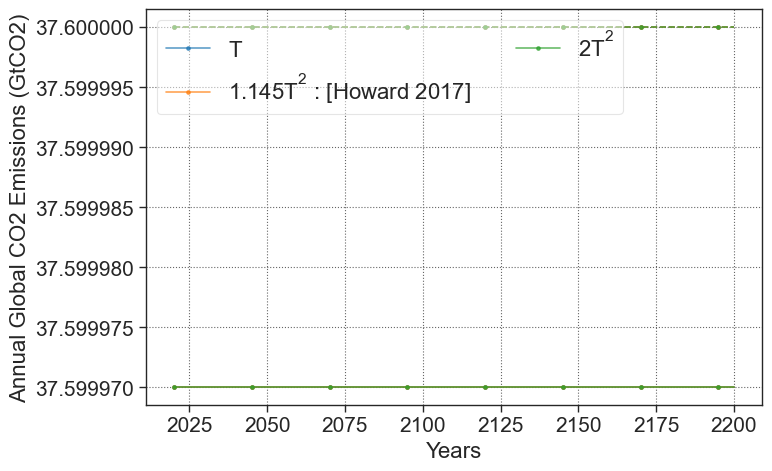

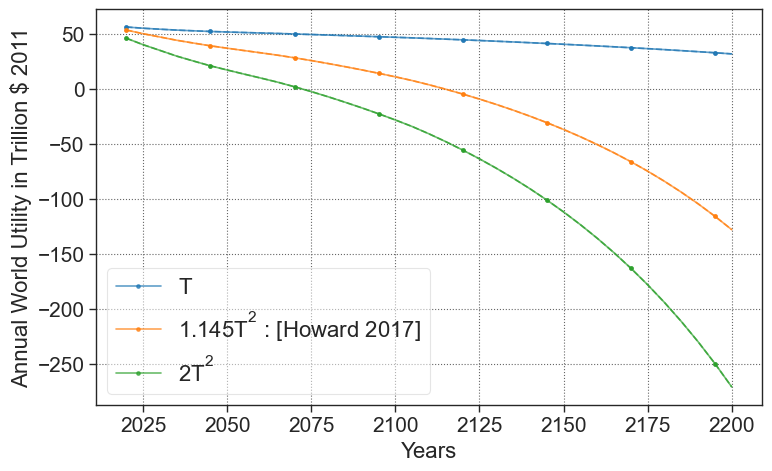

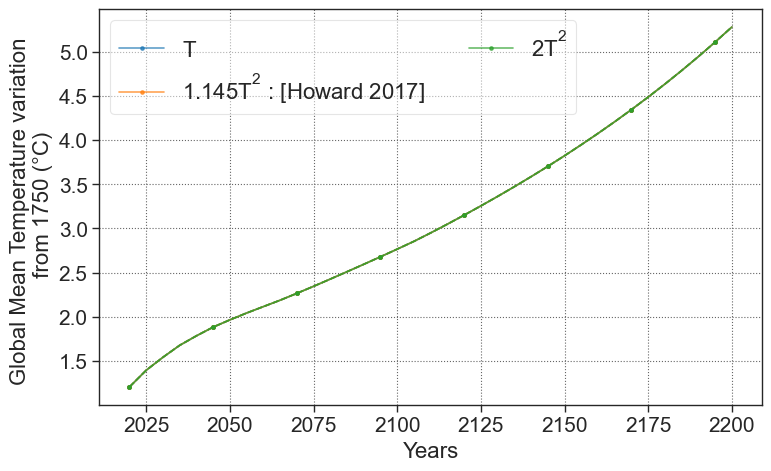

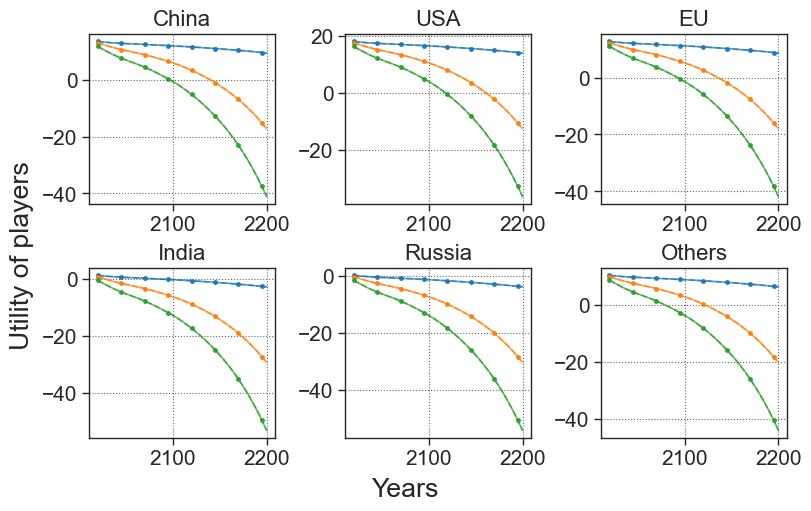

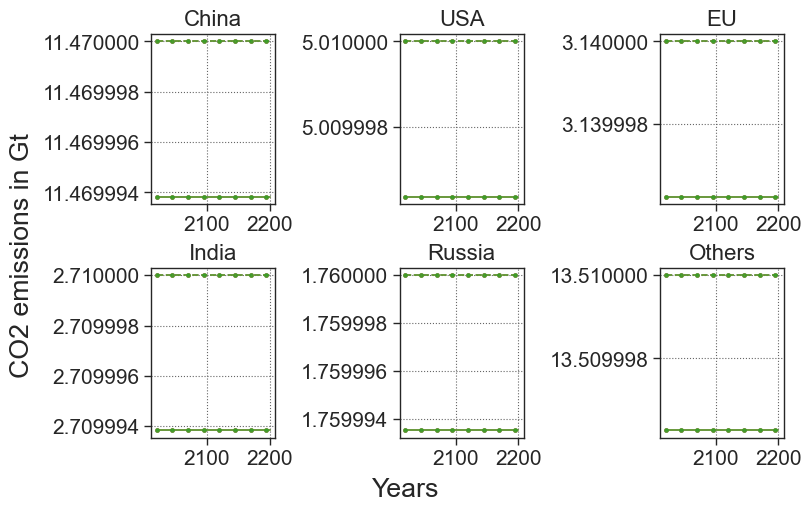

In [26]:
list_damage_coef = [np.array([0,1]), np.array([0,0,1.1450]), np.array([0,0,2])] #, np.array([0,0,0,0,1])]
list_damage_label = ['$T$', '$1.145T^2$ : [Howard 2017]', '$2T^2$'] #,  '$T^4$']

list_ne = []
list_ne_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_so = []
list_so_u = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, update_allowed=False)

    X = 2020 + np.arange(game.T)*5

    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    list_so.append(game.so_a_p)
    list_so_u.append(game.so_u_p)
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)


plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha, **one_shot_style)

# plt.plot(X[:len(RCP_26)], RCP_26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha, **one_shot_style)

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha, **one_shot_style)
# plt.plot(X[:len(temp_RCP26)], temp_RCP26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne_u, list_so_u):
        p = axes[k//3, k%3].plot(X, ne_u[k], alpha = alpha, **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style,alpha = alpha, **one_shot_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')

plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne, list_so):
        p = axes[k//3, k%3].plot(X, ne_u[k], alpha = alpha, **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style,alpha = alpha, **one_shot_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

## Convexe

In [27]:
list_benefit_functions = BENEFITS_CONVEX
case = 'convex'

### Update allowed

In [28]:
update_allowed = True

### Horizon = 2100

In [29]:
horizon = 2100

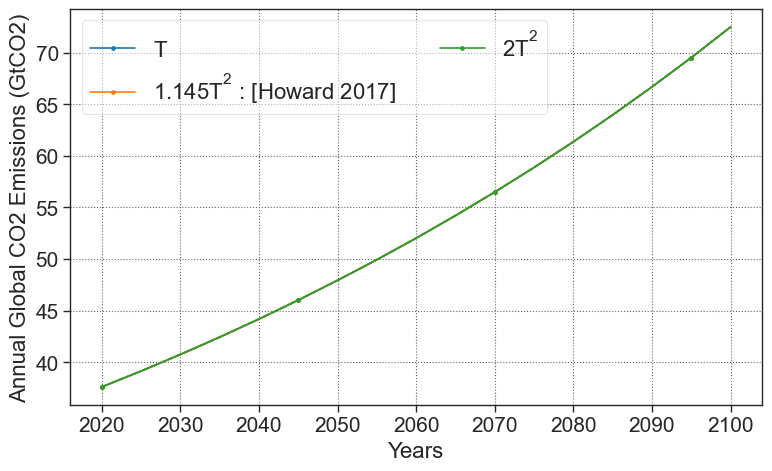

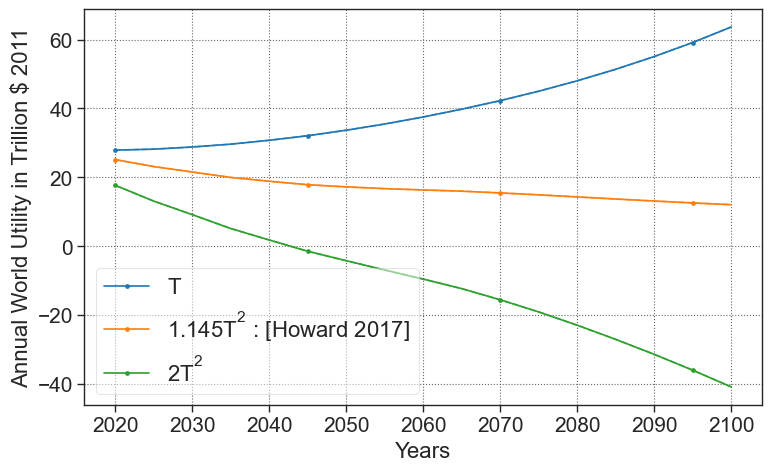

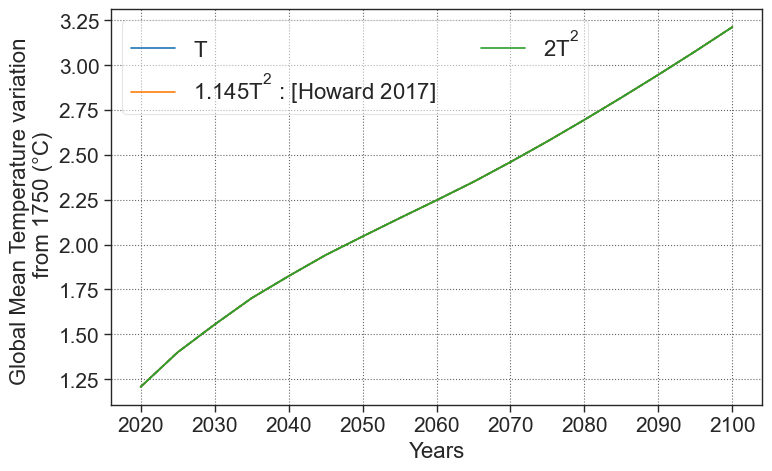

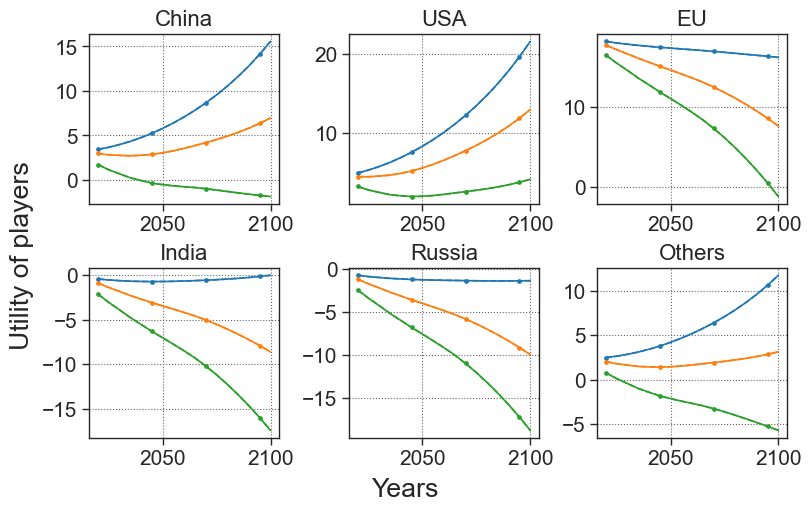

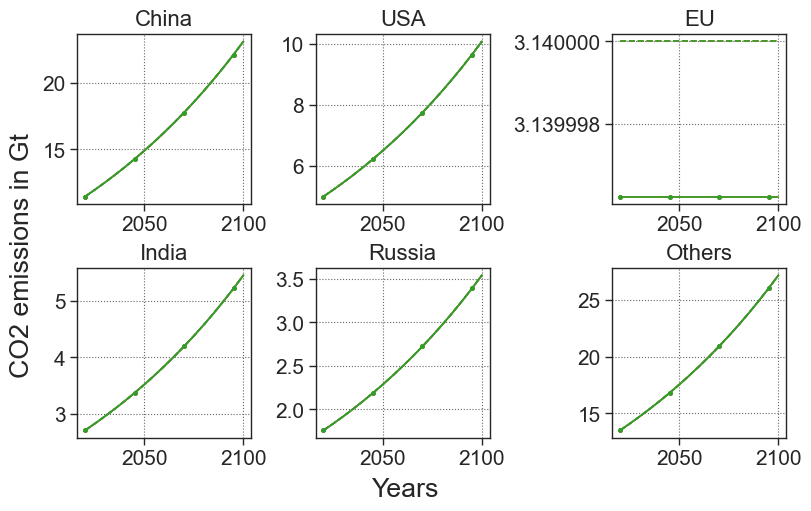

In [30]:
list_ne = []
list_ne_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_so = []
list_so_u = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon = horizon, update_allowed=update_allowed)

    X = 2020 + np.arange(game.T)*5

    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    list_so.append(game.so_a_p)
    list_so_u.append(game.so_u_p)
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)


plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)

# plt.plot(X[:len(RCP_26)], RCP_26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()



plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne_u, list_so_u):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne, list_so):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

### Horizon = 2200

In [31]:
horizon = 2200

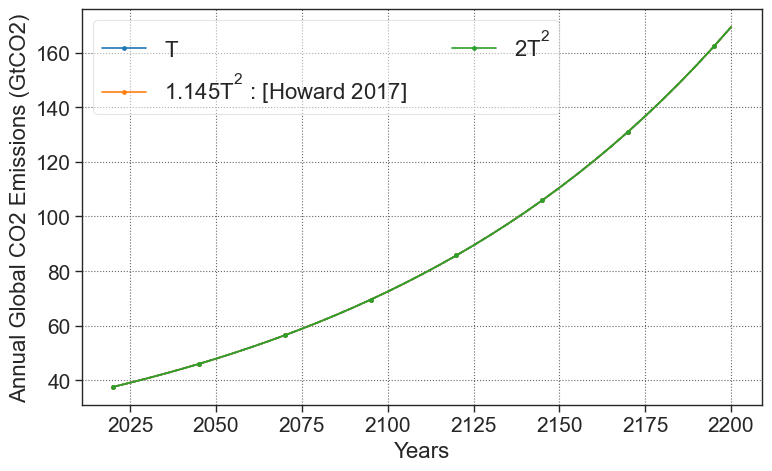

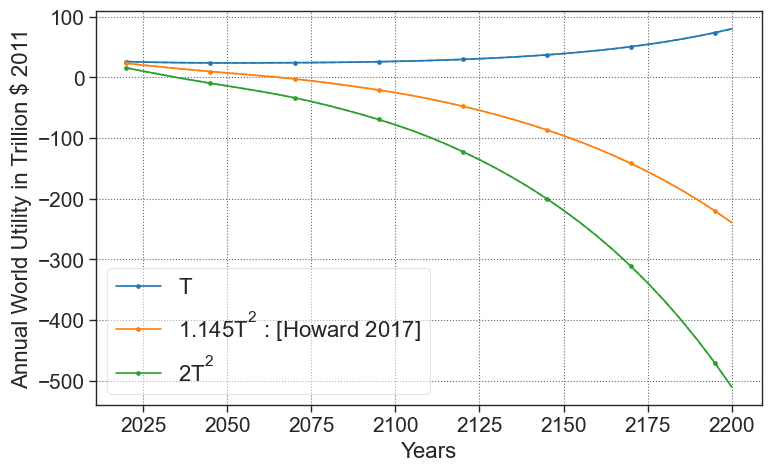

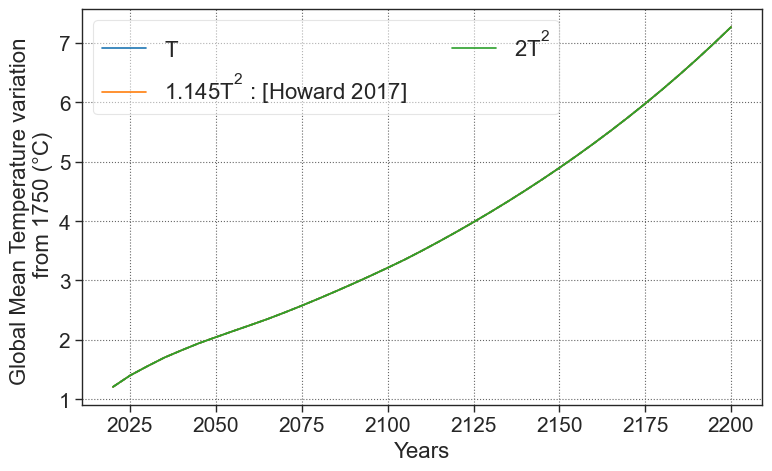

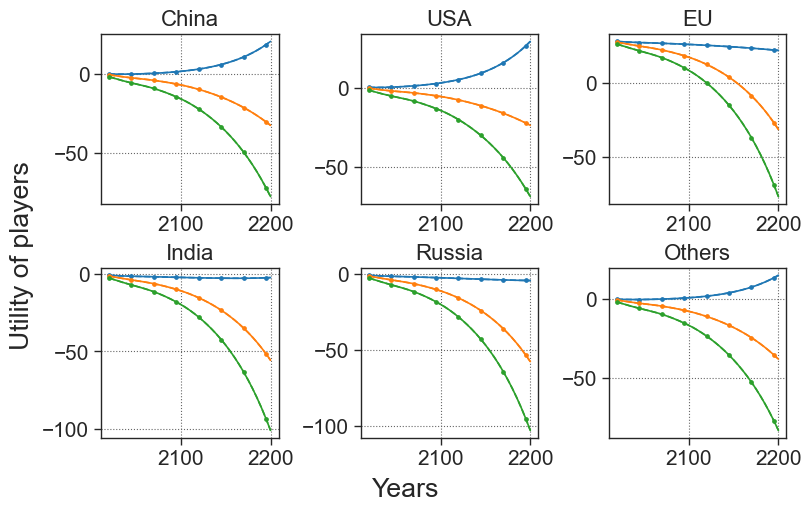

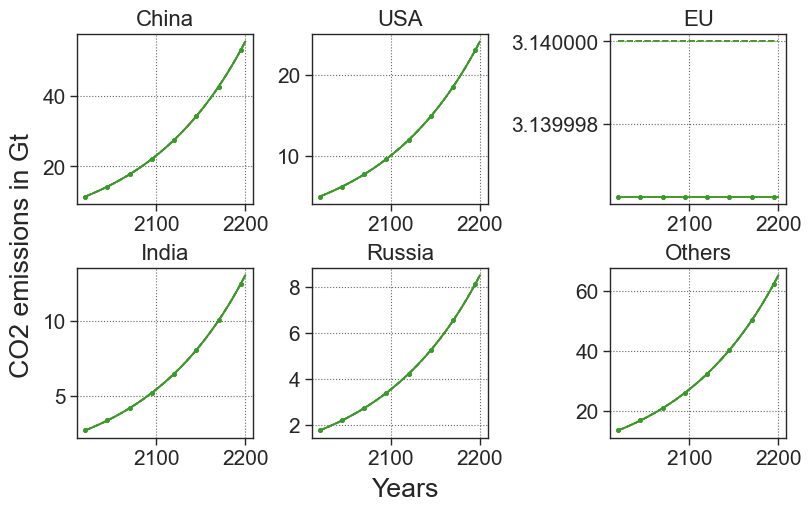

In [32]:
list_ne = []
list_ne_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_so = []
list_so_u = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon = horizon, update_allowed=update_allowed)

    X = 2020 + np.arange(game.T)*5

    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    list_so.append(game.so_a_p)
    list_so_u.append(game.so_u_p)
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)


plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)

# plt.plot(X[:len(RCP_26)], RCP_26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()



plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne_u, list_so_u):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne, list_so):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

### Update not allowed

In [33]:
update_allowed = False

### Horizon = 2100

In [34]:
horizon = 2100

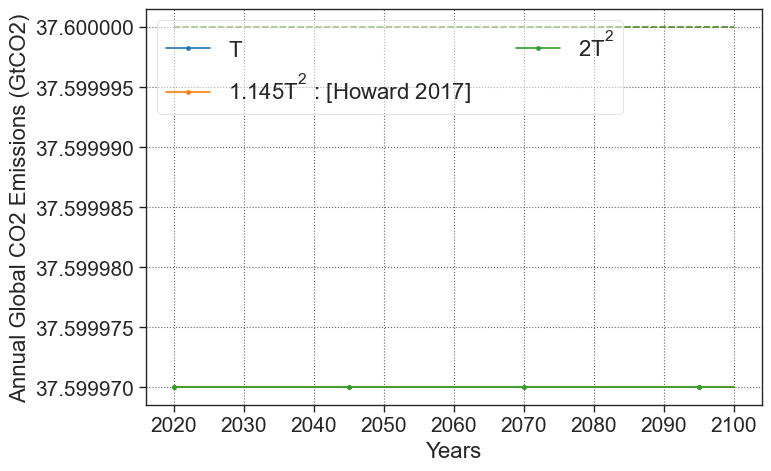

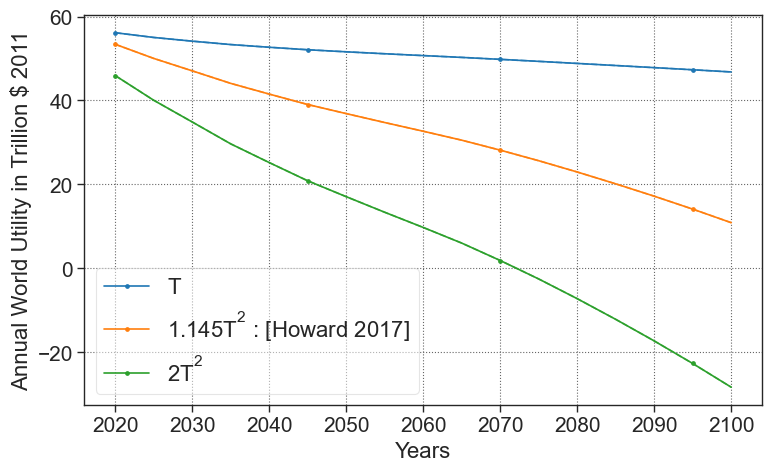

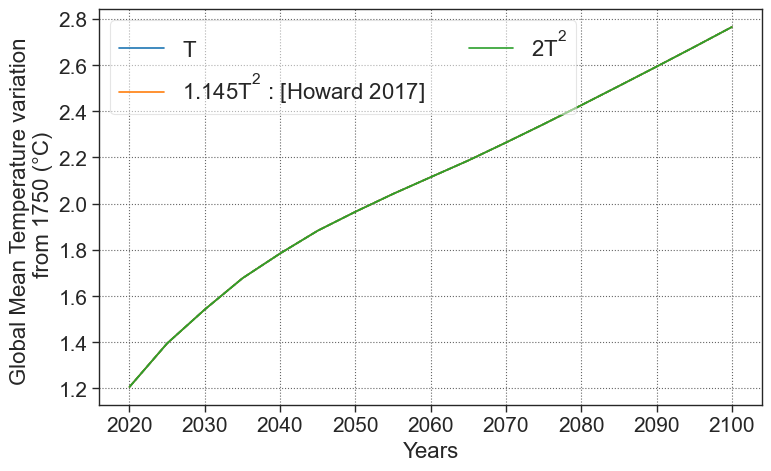

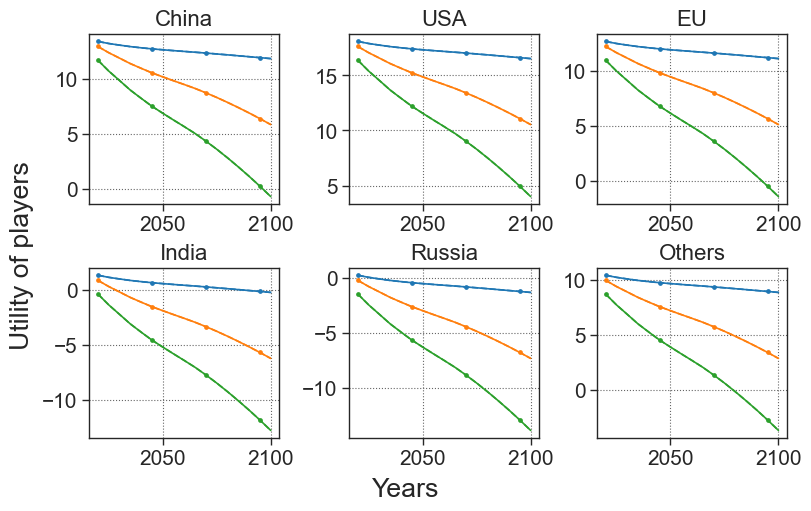

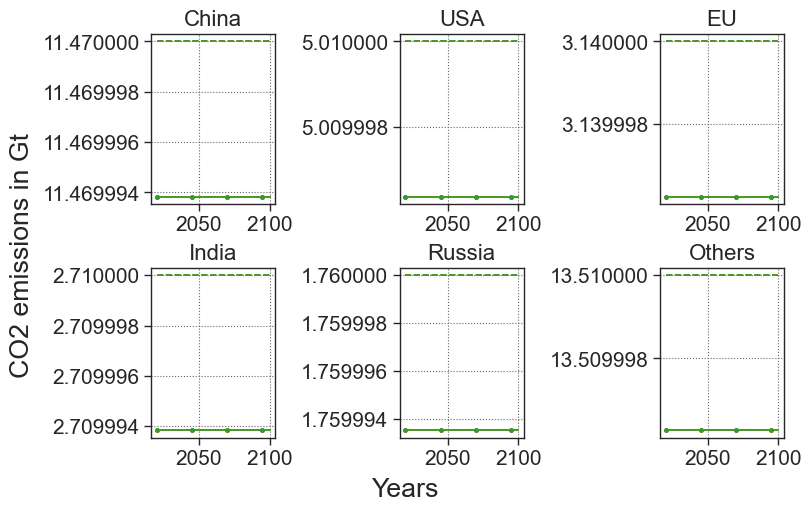

In [35]:
list_ne = []
list_ne_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_so = []
list_so_u = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon = horizon, update_allowed=update_allowed)

    X = 2020 + np.arange(game.T)*5

    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    list_so.append(game.so_a_p)
    list_so_u.append(game.so_u_p)
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)


plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)

# plt.plot(X[:len(RCP_26)], RCP_26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()



plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne_u, list_so_u):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne, list_so):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

### Horizon = 2200

In [36]:
horizon = 2200

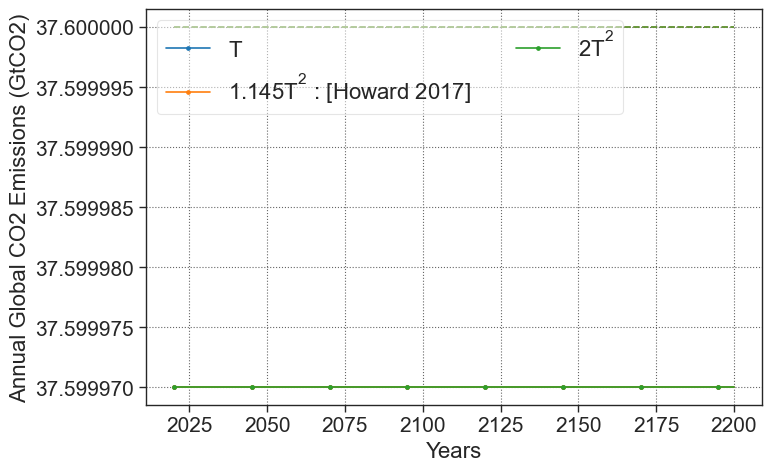

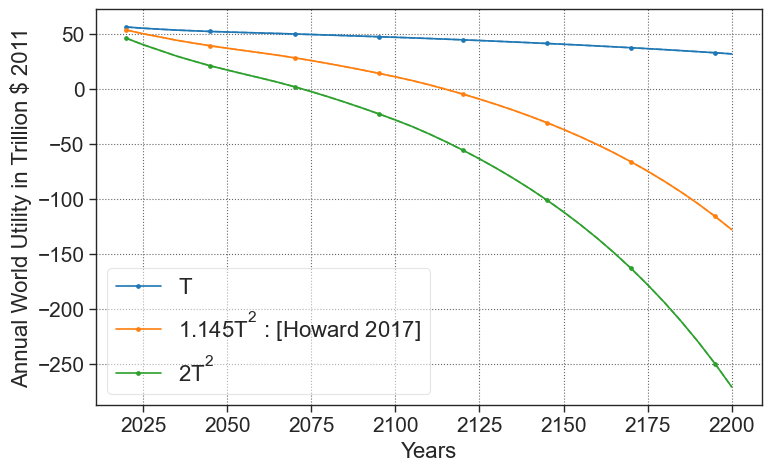

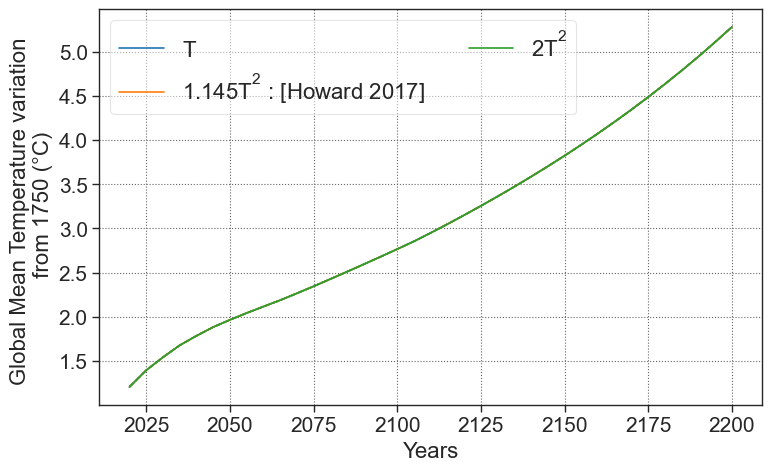

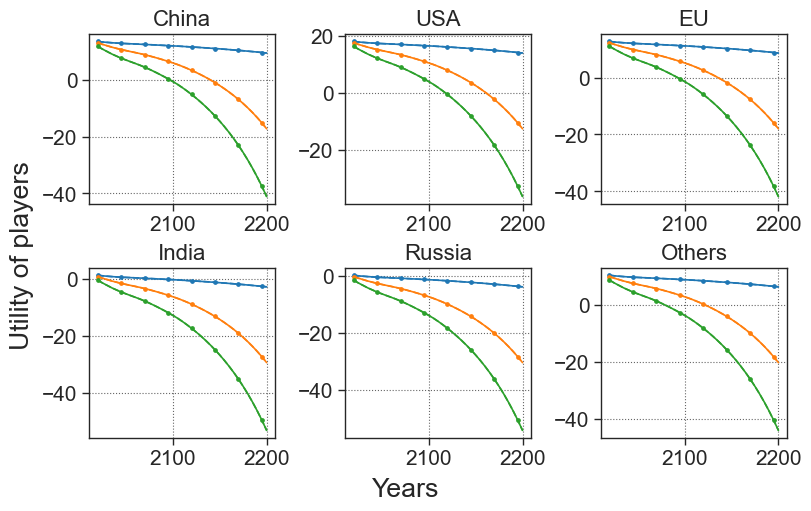

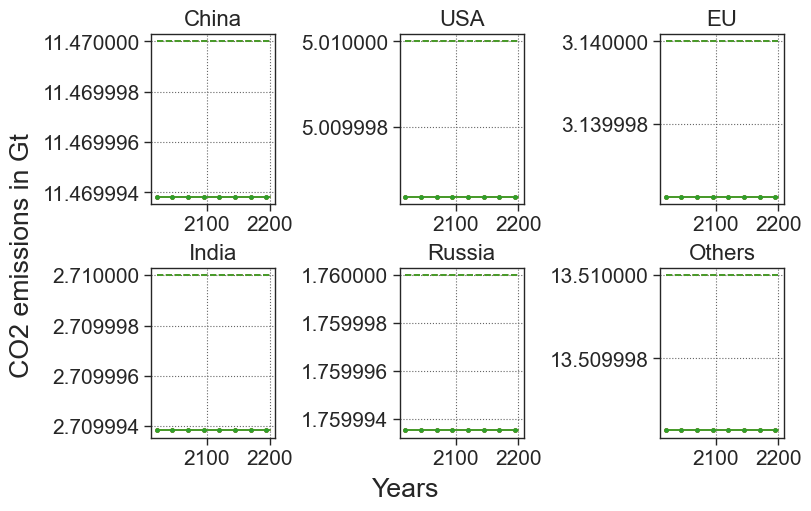

In [37]:
list_ne = []
list_ne_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_so = []
list_so_u = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon = horizon, update_allowed=update_allowed)

    X = 2020 + np.arange(game.T)*5

    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    list_so.append(game.so_a_p)
    list_so_u.append(game.so_u_p)
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)


plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)

# plt.plot(X[:len(RCP_26)], RCP_26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()



plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne_u, list_so_u):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne, list_so):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

## Sigmoid

In [90]:
list_benefit_functions = BENEFITS_SIGMOID
case = 'sigmoid'

### Update allowed

In [97]:
update_allowed = False

### Horizon = 2100

In [98]:
horizon = 2100

In [99]:
# puissance de la fonction damage 

# Coefficients de la fonction dammage (pour un polynome de degré 2)


list_damage_coef = [np.array([0,1]), np.array([0,0,1.1450])]#, np.array([0,0,2,0])] #, np.array([0,0,0,0,1])]
list_damage_label = ['$T$', '$1.145T^2$']#, '$2T^2$'] #,  '$T^4$']
list_marker = ['x', 's', 'o']

In [100]:
one_shot_style = { 'marker' : '.' ,'markevery' : 5, 'ms' : 10, 'lw' : 2}
so_style = { 'ls' : '--' }
planning_style = { 'marker' : 's' ,'markevery' : 5}
alpha = 0.7

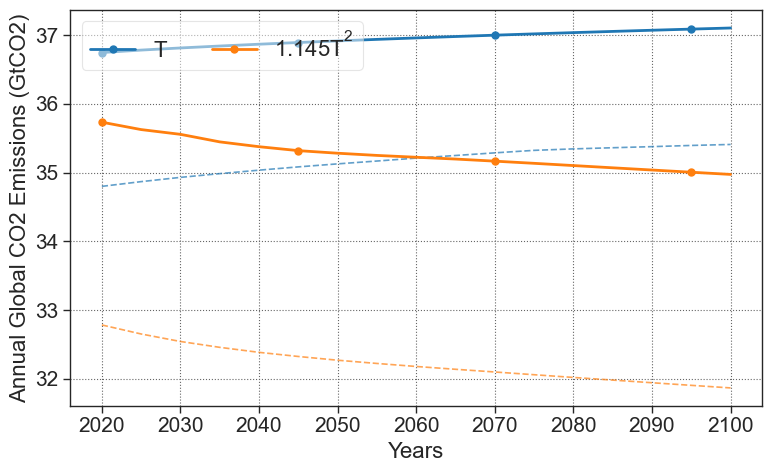

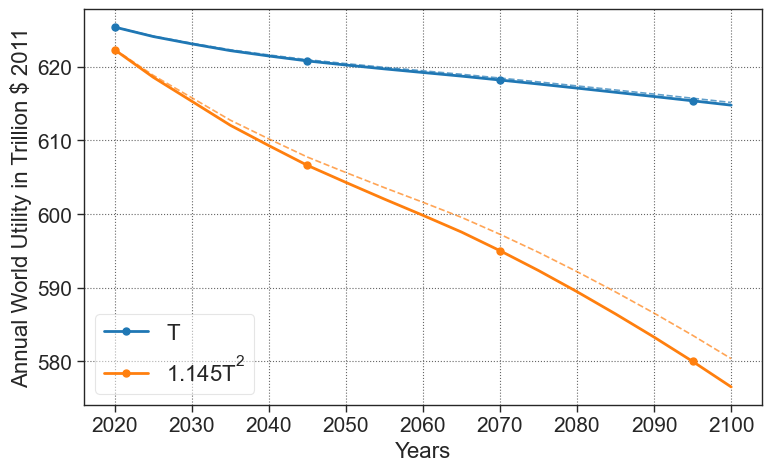

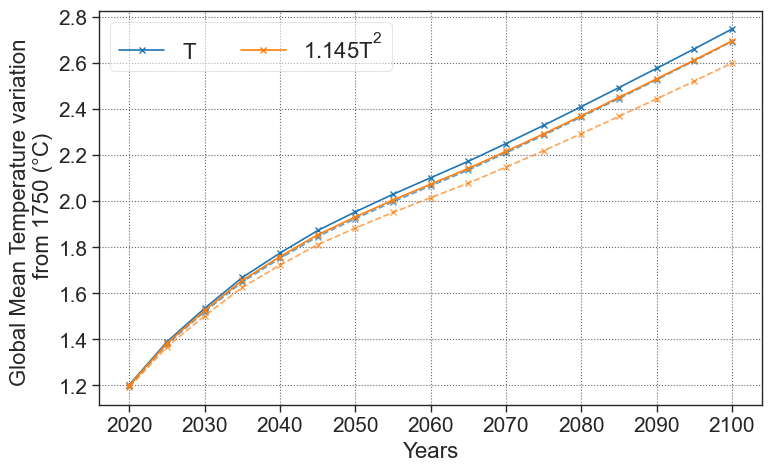

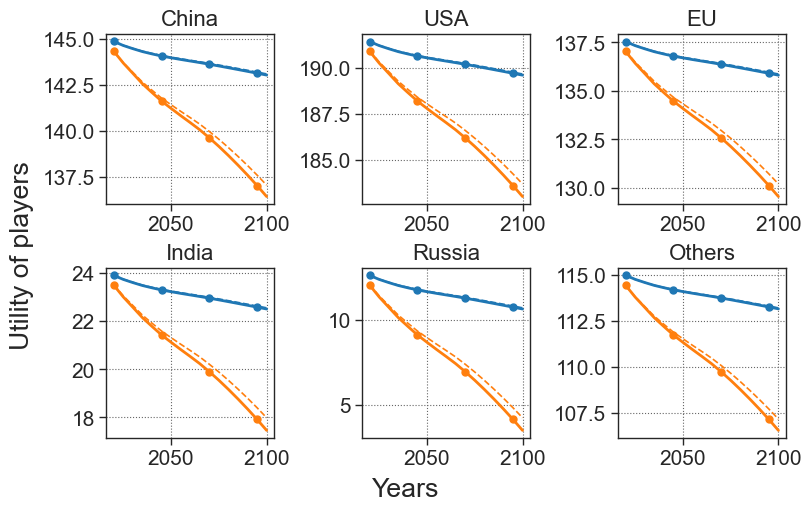

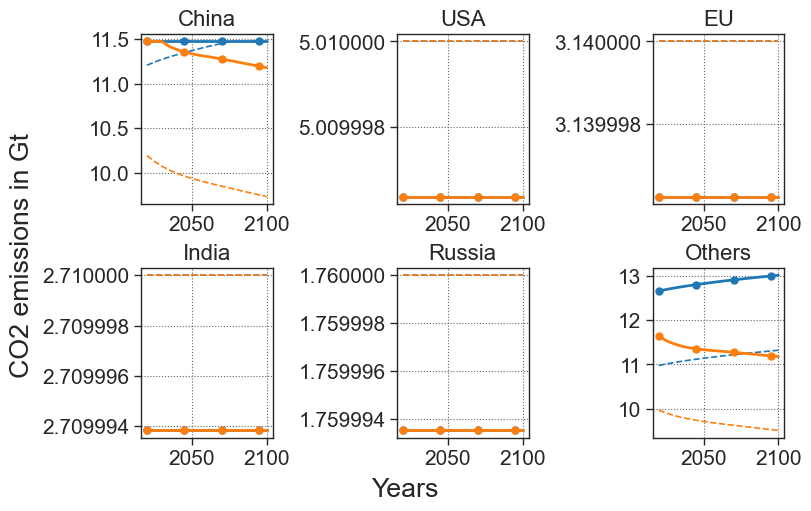

In [101]:
list_ne = []
list_ne_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_so = []
list_so_u = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_alpha = [1]
for a in list_alpha:
    for damage_coef in list_damage_coef :
        list_players = create_players(alpha = a, list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1, damage_in_percentage=True)

        game = Game(list_players, horizon = horizon, update_allowed=update_allowed)

        X = 2020 + np.arange(game.T)*5

        game.repeated_one_shot_game_NE()
        game.reset()

        game.repeated_one_shot_game_SO()
        list_ne.append(game.ne_a_p)
        list_ne_u.append(game.ne_u_p)
        list_sum_action.append(game.ne_sum_a_p)
        list_temp.append(game.ne_temp_p)
        list_sum_utilities.append(game.ne_sum_u_p)
        list_so.append(game.so_a_p)
        list_so_u.append(game.so_u_p)
        list_sum_action_so.append(game.so_sum_a_p)
        list_temp_so.append(game.so_temp_p)
        list_sum_utilities_so.append(game.so_sum_u_p)


plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)

# plt.plot(X[:len(RCP_26)], RCP_26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()



plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_temp) :   
    if idx%len(list_damage_coef) ==0 and idx !=0:
        plt.gca().set_prop_cycle(None)
    if idx < len(list_damage_coef) :
        p = plt.plot(X, list_temp[idx], label=list_damage_label[idx%len(list_damage_coef)], marker = list_marker[idx//len(list_damage_coef)])
        plt.plot(X, list_temp_so[idx], color= p[0].get_color(),marker = list_marker[idx//len(list_damage_coef)], **so_style, alpha = alpha)
    else:
        p = plt.plot(X, list_temp[idx],  marker = list_marker[idx//len(list_damage_coef)])
        plt.plot(X, list_temp_so[idx], color= p[0].get_color(),marker = list_marker[idx//len(list_damage_coef)],  **so_style, alpha = alpha)

# plt.plot(X[:len(temp_RCP26)], temp_RCP26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne_u, list_so_u):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne, list_so):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

In [102]:
# puissance de la fonction damage 

# Coefficients de la fonction dammage (pour un polynome de degré 2)


list_damage_coef = [np.array([0,1]), np.array([0,0,1.2])]#, np.array([0,0,2,0])] #, np.array([0,0,0,0,1])]
list_damage_label = ['T', '1.2T^2']#, '$2T^2$'] #,  '$T^4$']
list_marker = ['x', 's', 'o']

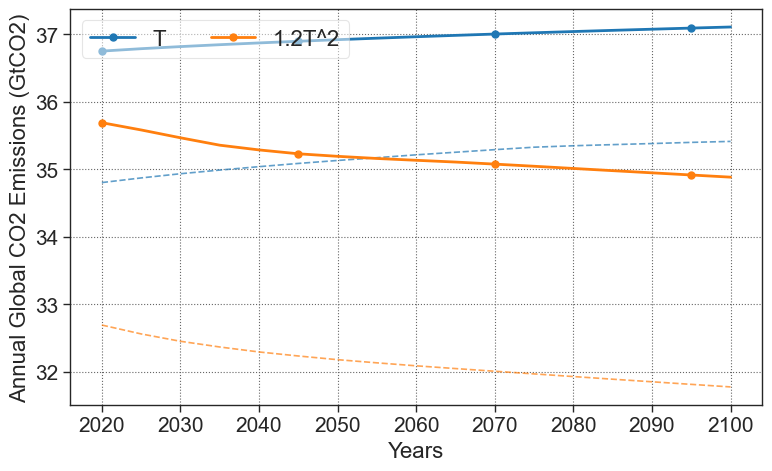

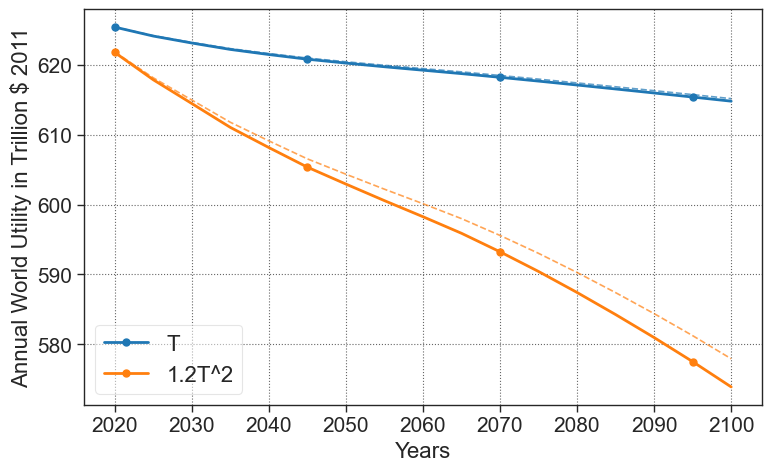

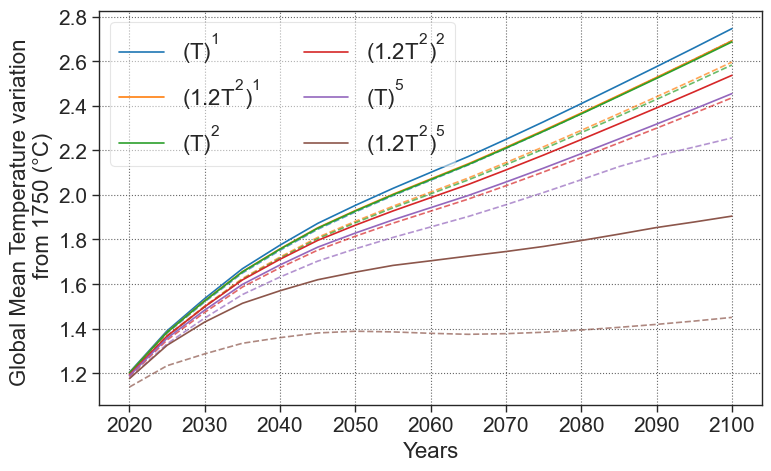

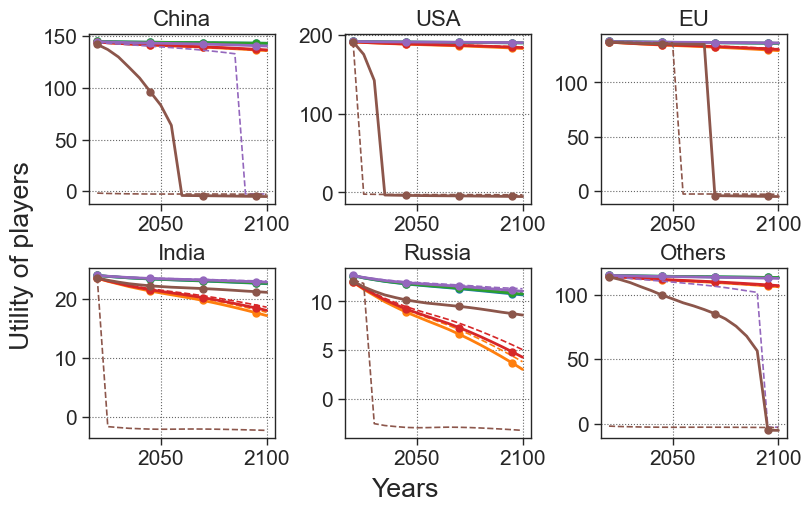

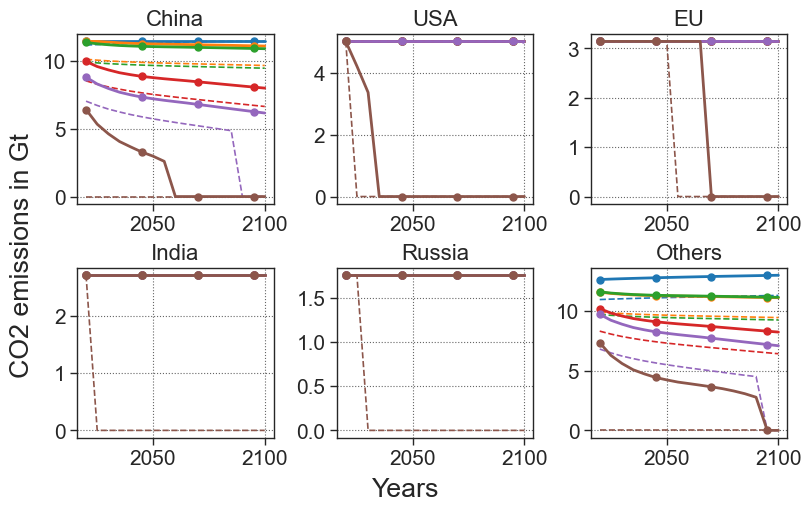

In [103]:
list_ne = []
list_ne_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_so = []
list_so_u = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []

list_alpha = [1,2,5]
for a in list_alpha:
    for damage_coef in list_damage_coef :
        list_players = create_players(alpha = a, list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

        game = Game(list_players, horizon = horizon, update_allowed=update_allowed)

        X = 2020 + np.arange(game.T)*5

        game.repeated_one_shot_game_NE()
        game.reset()

        game.repeated_one_shot_game_SO()
        list_ne.append(game.ne_a_p)
        list_ne_u.append(game.ne_u_p)
        list_sum_action.append(game.ne_sum_a_p)
        list_temp.append(game.ne_temp_p)
        list_sum_utilities.append(game.ne_sum_u_p)
        list_so.append(game.so_a_p)
        list_so_u.append(game.so_u_p)
        list_sum_action_so.append(game.so_sum_a_p)
        list_temp_so.append(game.so_temp_p)
        list_sum_utilities_so.append(game.so_sum_u_p)


plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)

# plt.plot(X[:len(RCP_26)], RCP_26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()



plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_temp) :   
    p = plt.plot(X, list_temp[idx], label=r'$({})^{}$'.format(list_damage_label[idx%len(list_damage_coef)], list_alpha[(idx)//
                                                                                                                       len(list_damage_coef)]))#, marker = list_marker[idx%len(list_damage_coef)])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne_u, list_so_u):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne, list_so):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

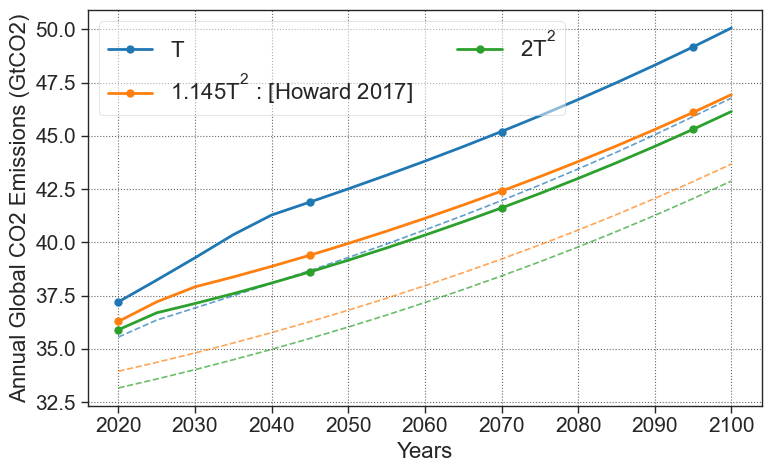

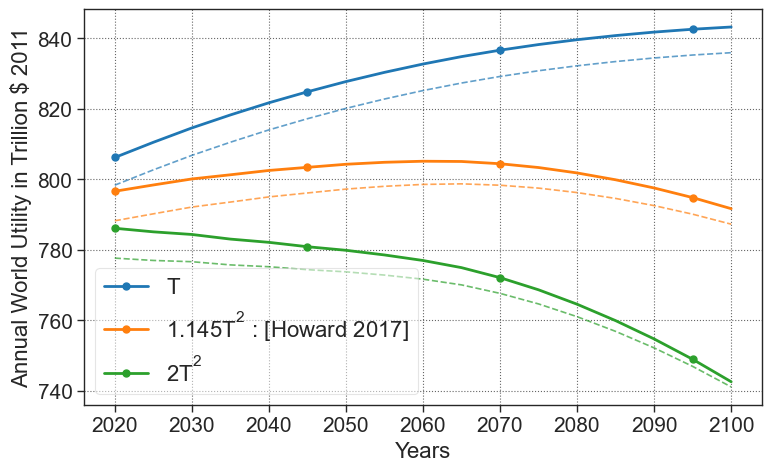

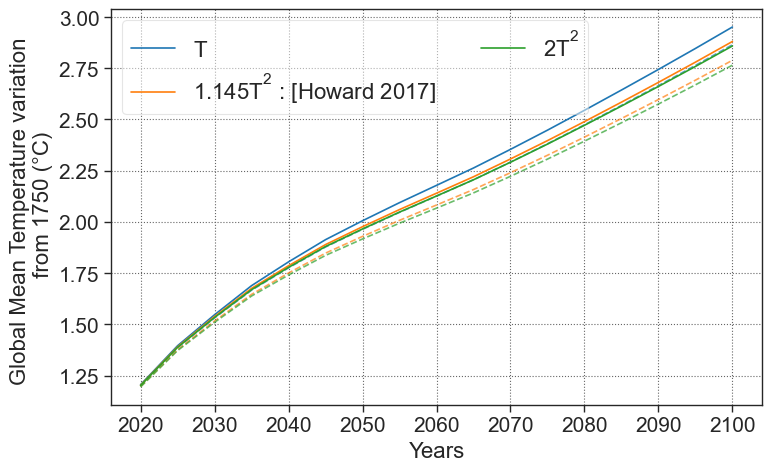

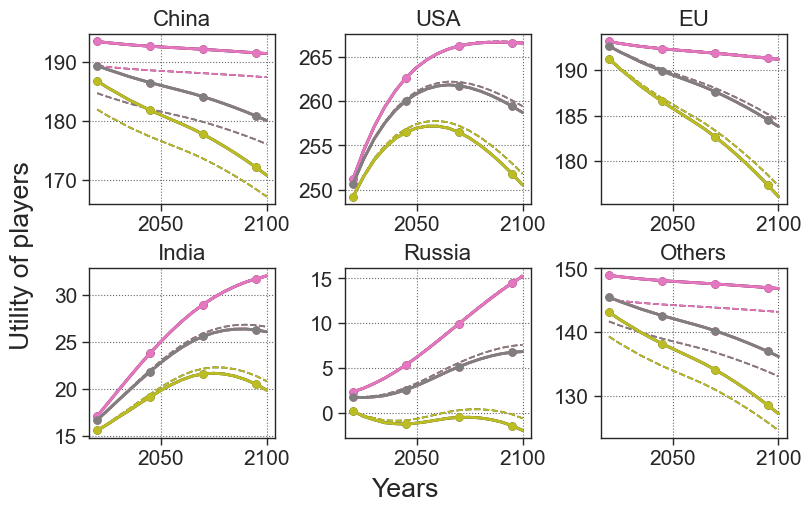

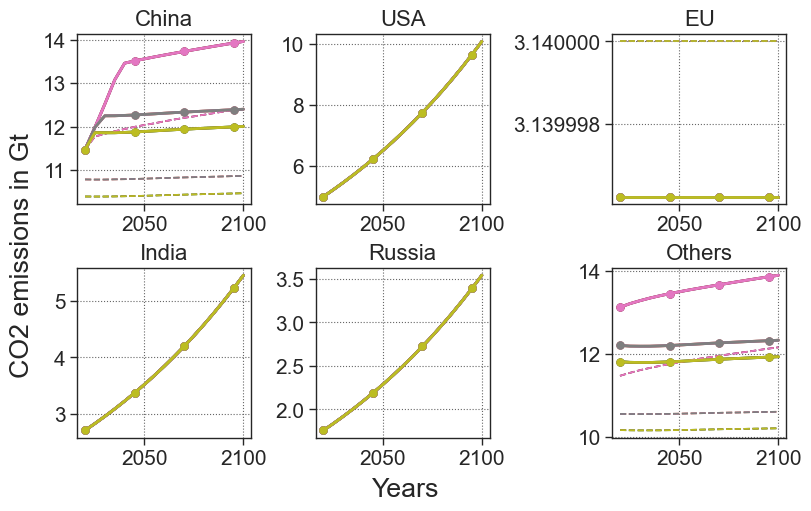

In [ ]:
list_ne = []
list_ne_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_so = []
list_so_u = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
for a in [1,2,5]:
    for damage_coef in list_damage_coef :
        list_players = create_players(alpha = alpha, list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

        game = Game(list_players, horizon = horizon, update_allowed=update_allowed)

        X = 2020 + np.arange(game.T)*5

        game.repeated_one_shot_game_NE()
        game.reset()

        game.repeated_one_shot_game_SO()
        list_ne.append(game.ne_a_p)
        list_ne_u.append(game.ne_u_p)
        list_sum_action.append(game.ne_sum_a_p)
        list_temp.append(game.ne_temp_p)
        list_sum_utilities.append(game.ne_sum_u_p)
        list_so.append(game.so_a_p)
        list_so_u.append(game.so_u_p)
        list_sum_action_so.append(game.so_sum_a_p)
        list_temp_so.append(game.so_temp_p)
        list_sum_utilities_so.append(game.so_sum_u_p)


plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)

# plt.plot(X[:len(RCP_26)], RCP_26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()



plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne_u, list_so_u):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne, list_so):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

### Horizon = 2200

In [32]:
horizon = 2200

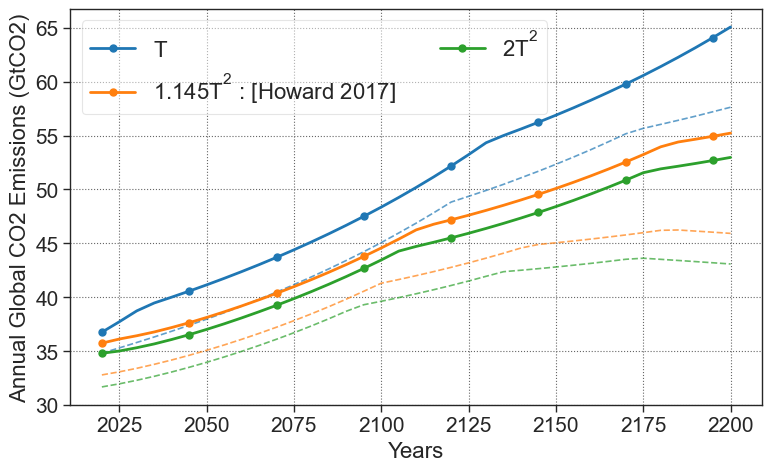

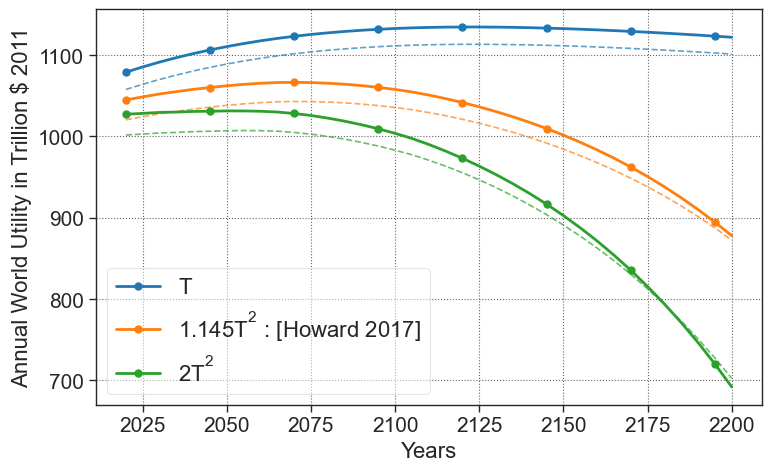

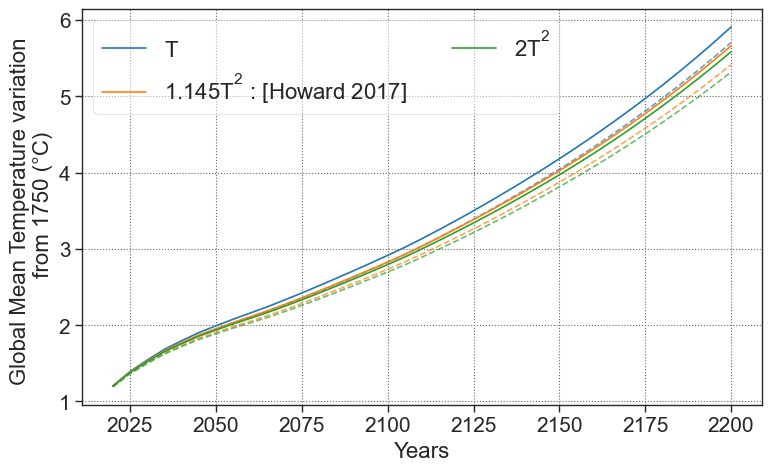

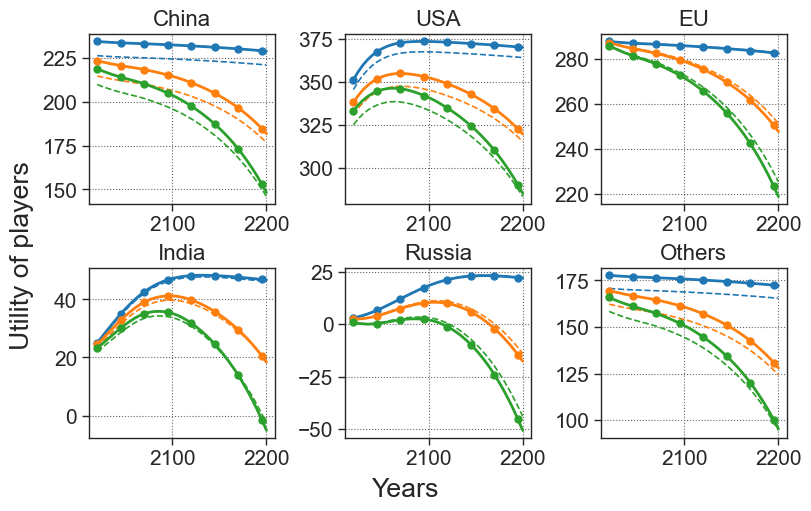

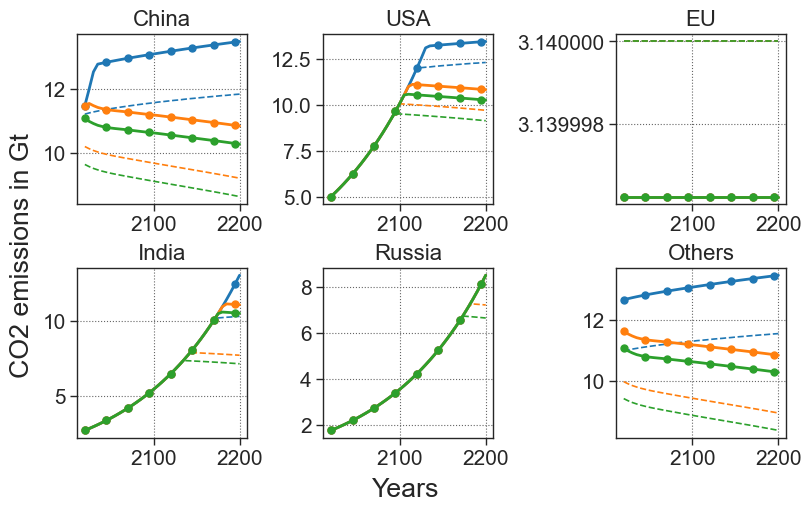

In [33]:
list_ne = []
list_ne_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_so = []
list_so_u = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon = horizon, update_allowed=update_allowed)

    X = 2020 + np.arange(game.T)*5

    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    list_so.append(game.so_a_p)
    list_so_u.append(game.so_u_p)
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)


plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)

# plt.plot(X[:len(RCP_26)], RCP_26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()



plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne_u, list_so_u):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne, list_so):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

### Update not allowed

In [44]:
update_allowed = False

### Horizon = 2100

In [45]:
horizon = 2100

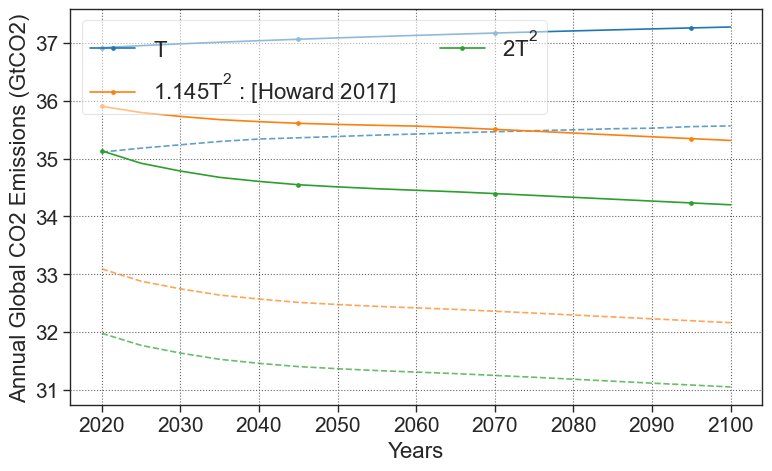

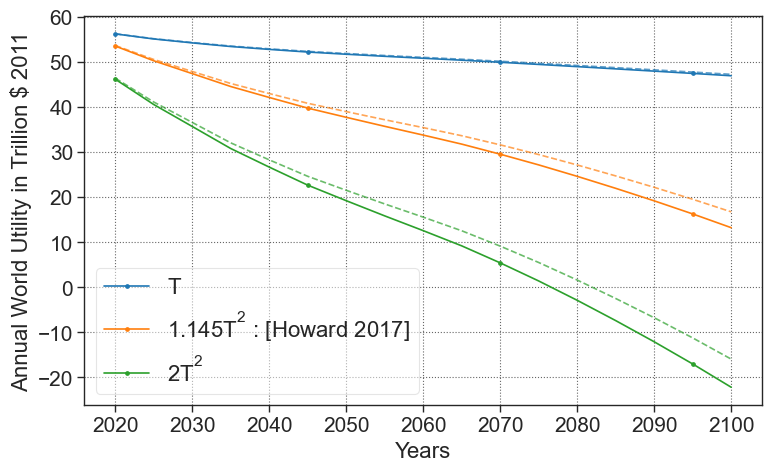

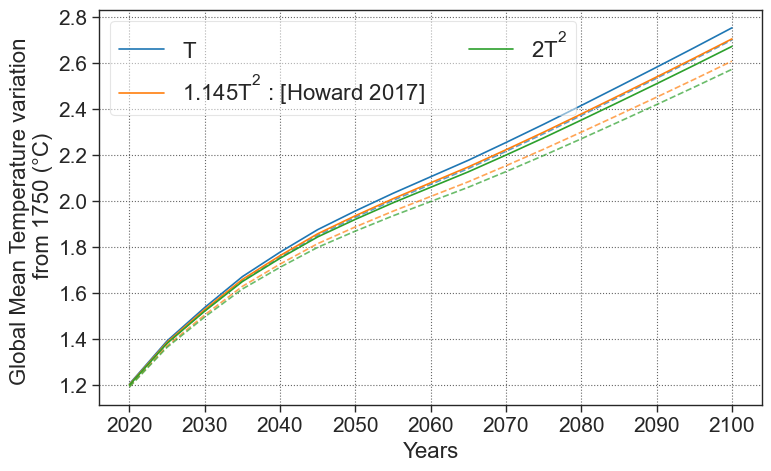

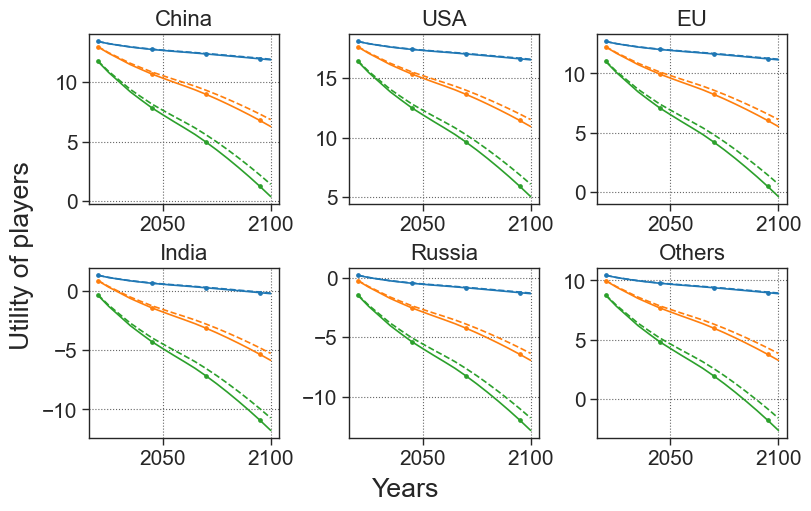

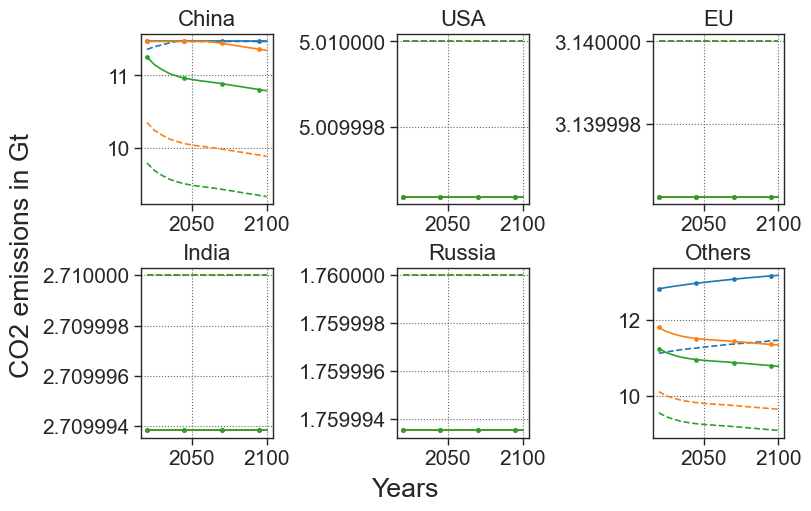

In [46]:
list_ne = []
list_ne_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_so = []
list_so_u = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon = horizon, update_allowed=update_allowed)

    X = 2020 + np.arange(game.T)*5

    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    list_so.append(game.so_a_p)
    list_so_u.append(game.so_u_p)
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)


plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)

# plt.plot(X[:len(RCP_26)], RCP_26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()



plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne_u, list_so_u):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne, list_so):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

### Horizon = 2200

In [47]:
horizon = 2200

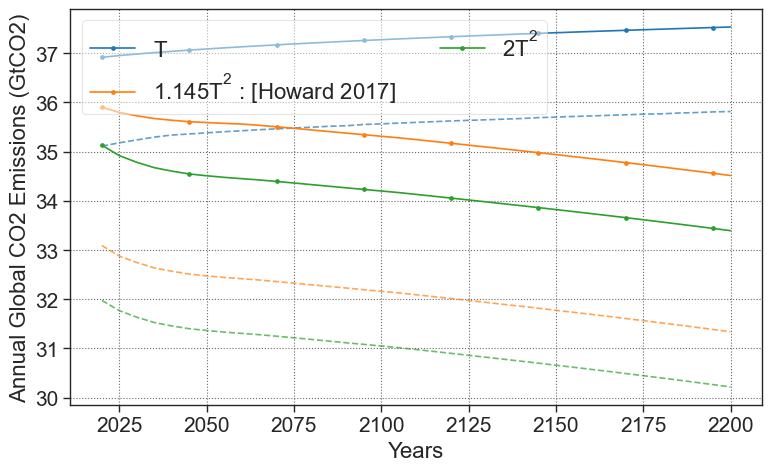

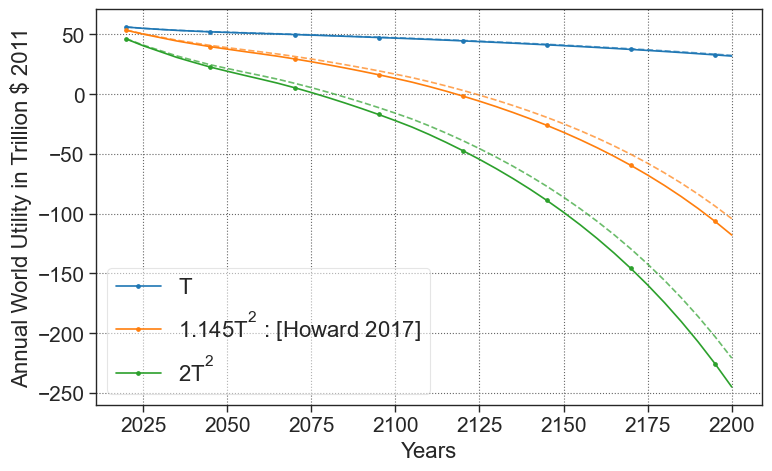

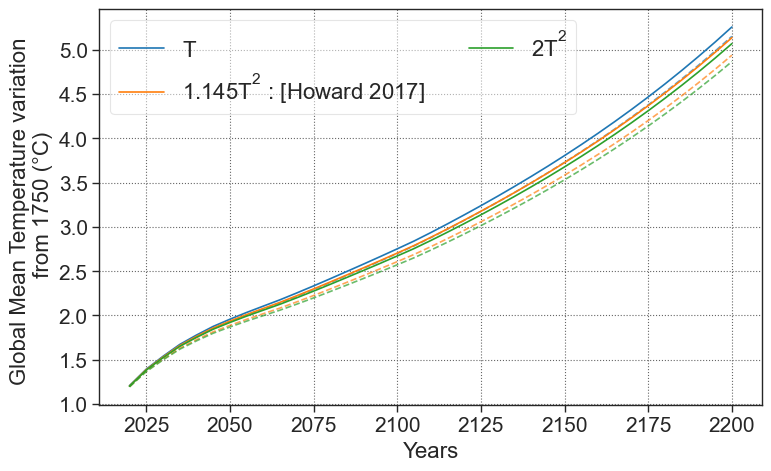

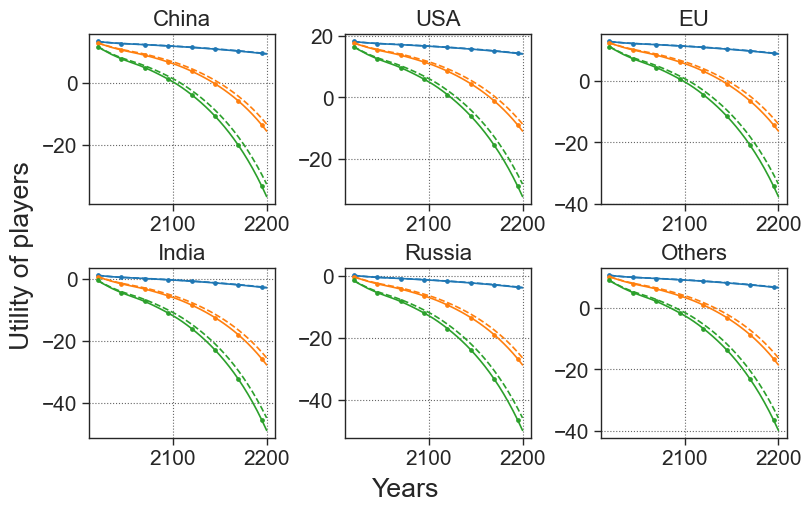

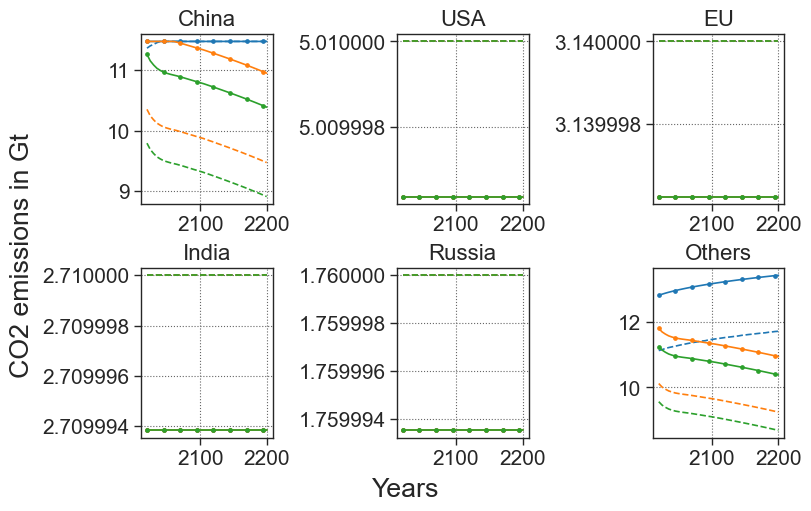

In [48]:
list_ne = []
list_ne_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_so = []
list_so_u = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon = horizon, update_allowed=update_allowed)

    X = 2020 + np.arange(game.T)*5

    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    list_so.append(game.so_a_p)
    list_so_u.append(game.so_u_p)
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)


plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)

# plt.plot(X[:len(RCP_26)], RCP_26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()



plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne_u, list_so_u):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne, list_so):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

# Planning

In [49]:
temperature_target = None
final_multiplier = 0

## Concave

In [50]:
list_benefit_functions=BENEFITS_CONCAVE
case = 'concave'

### Horizon = 2100

In [51]:
horizon = 2100

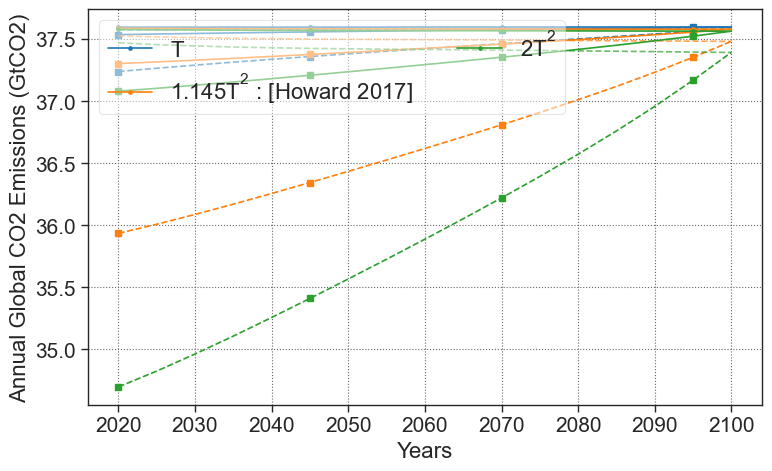

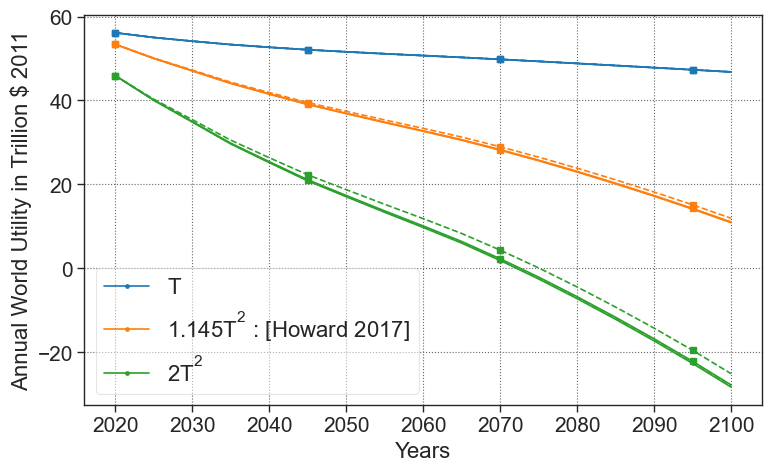

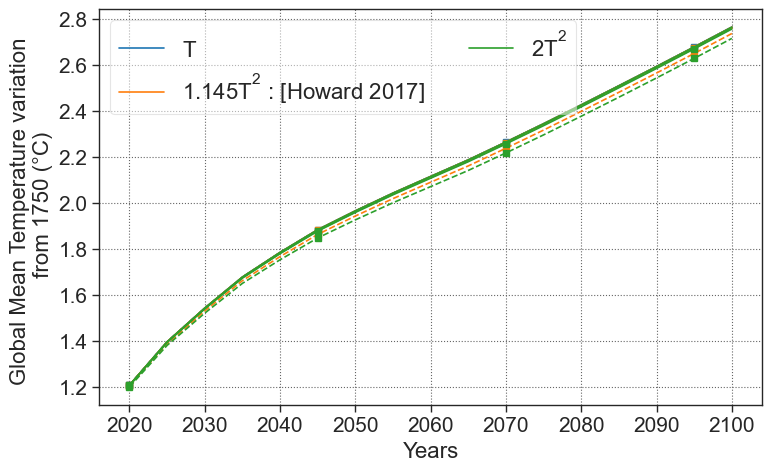

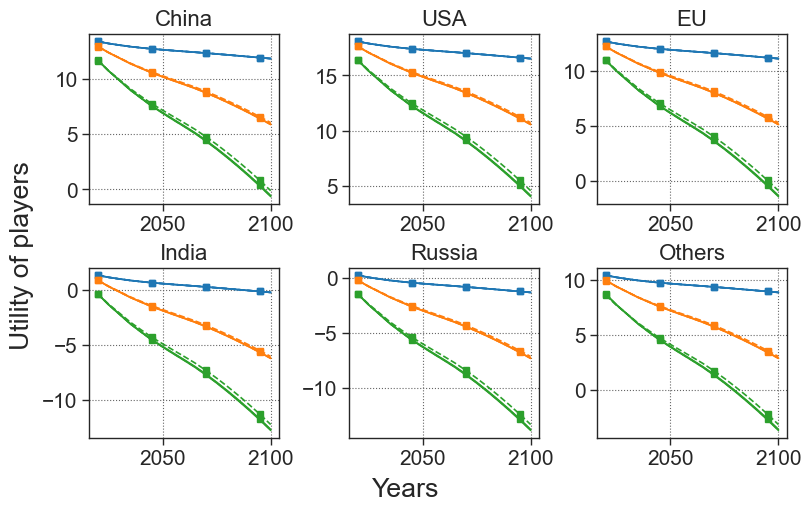

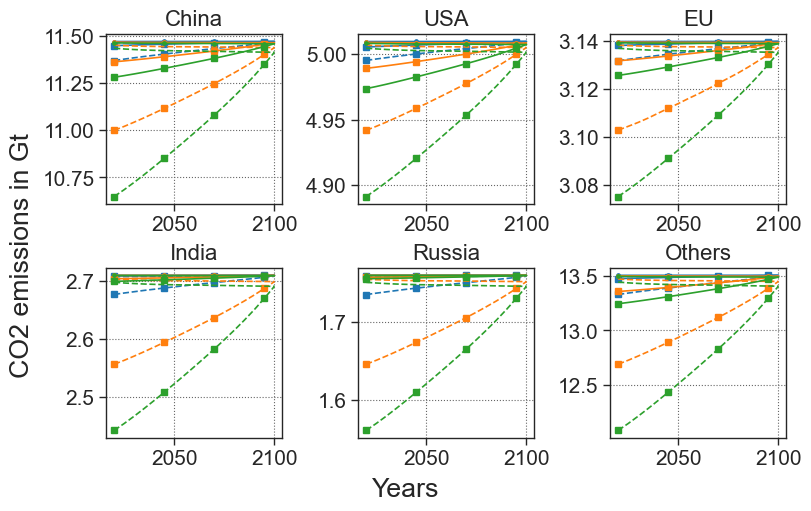

In [52]:
list_ne = []
list_so = []
list_ne_u = []
list_so_u = []
list_ne_planning_u = []
list_so_planning_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
list_ne_planning = []
list_so_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, temperature_target=temperature_target, final_multiplier = final_multiplier)

    X = 2020 + np.arange(game.T)*5
    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    game.reset()
    
    game.planning_BRD()
    game.planning_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_ne_planning_u.append(game.ne_u_planning_brd)
    
    list_so.append(game.so_a_p)

    list_so_u.append(game.so_u_p)
    list_so_planning_u.append(game.so_u_planning)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)

    list_ne_planning.append(game.ne_a_planning_brd)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd)
    list_temp_planning.append(game.ne_temp_planning_brd)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd)

    list_so_planning.append(game.so_a_planning)

    list_sum_action_planning_so.append(game.so_sum_a_planning)
    list_temp_planning_so.append(game.so_temp_planning)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning)

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne_u, list_so_u, list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne, list_so, list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

### Horizon = 2200

In [53]:
horizon = 2200

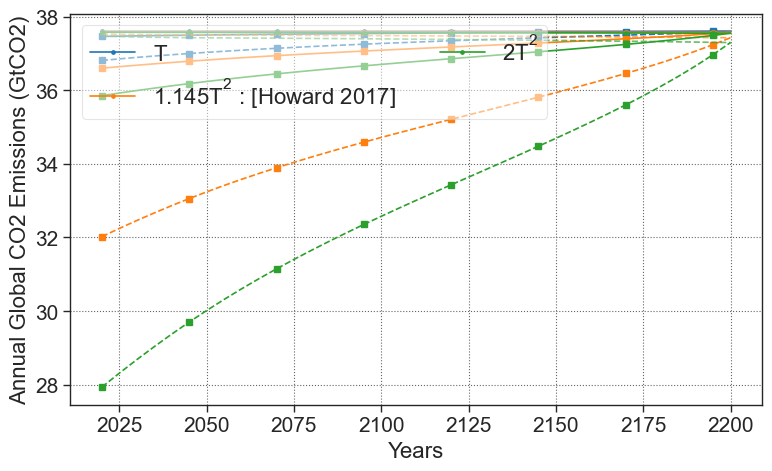

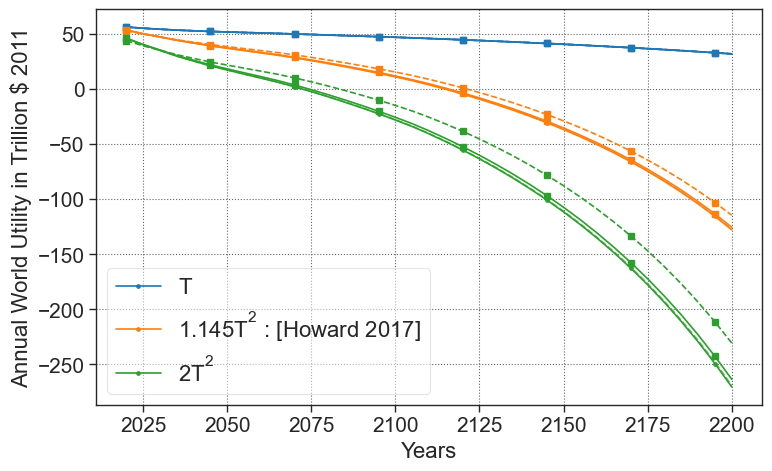

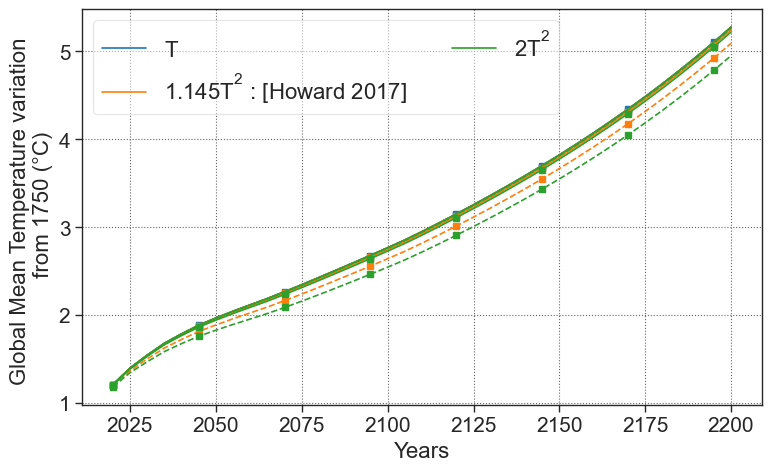

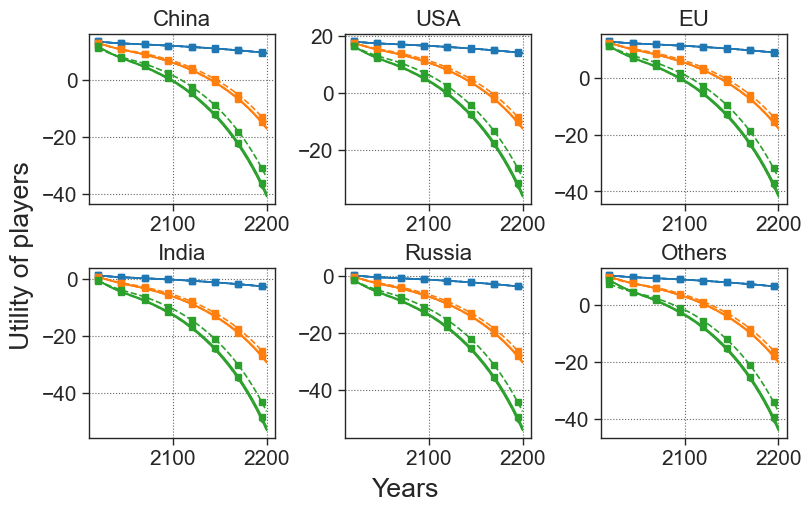

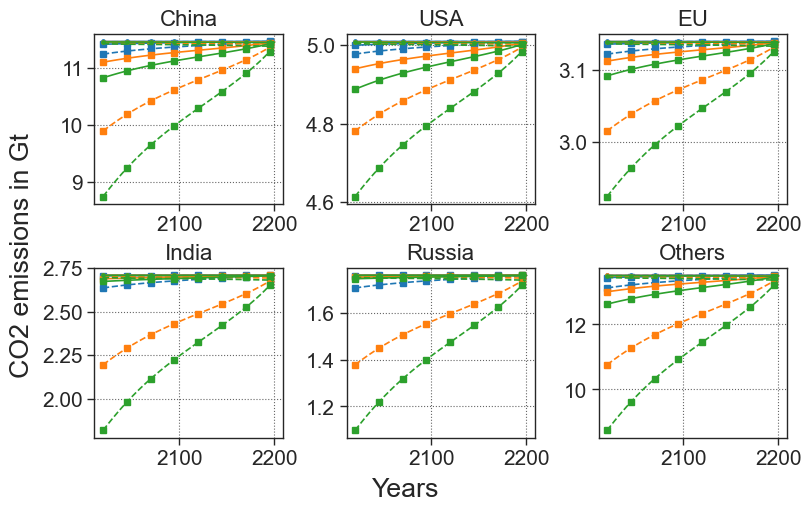

In [54]:
list_ne = []
list_so = []
list_ne_u = []
list_so_u = []
list_ne_planning_u = []
list_so_planning_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
list_ne_planning = []
list_so_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, temperature_target=temperature_target, final_multiplier = final_multiplier)

    X = 2020 + np.arange(game.T)*5
    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    game.reset()
    
    game.planning_BRD()
    game.planning_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_ne_planning_u.append(game.ne_u_planning_brd)
    
    list_so.append(game.so_a_p)

    list_so_u.append(game.so_u_p)
    list_so_planning_u.append(game.so_u_planning)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)

    list_ne_planning.append(game.ne_a_planning_brd)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd)
    list_temp_planning.append(game.ne_temp_planning_brd)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd)

    list_so_planning.append(game.so_a_planning)

    list_sum_action_planning_so.append(game.so_sum_a_planning)
    list_temp_planning_so.append(game.so_temp_planning)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning)

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne_u, list_so_u, list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne, list_so, list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

## Concave Log

In [55]:
list_benefit_functions = BENEFITS_LOG
case = 'log'

### Horizon = 2100

In [56]:
horizon = 2100

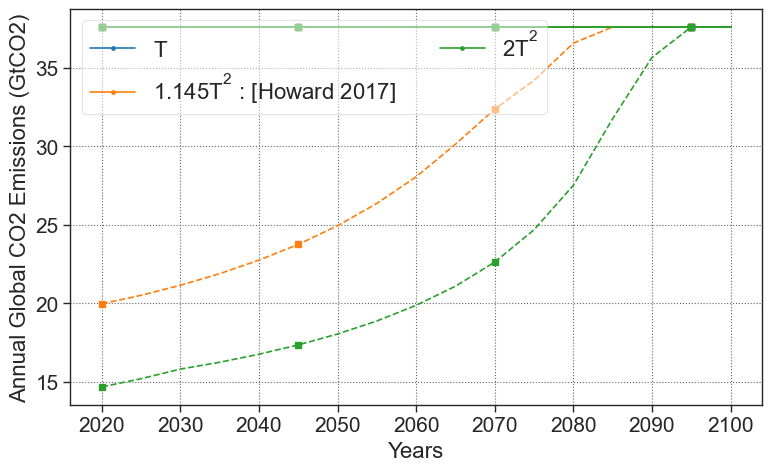

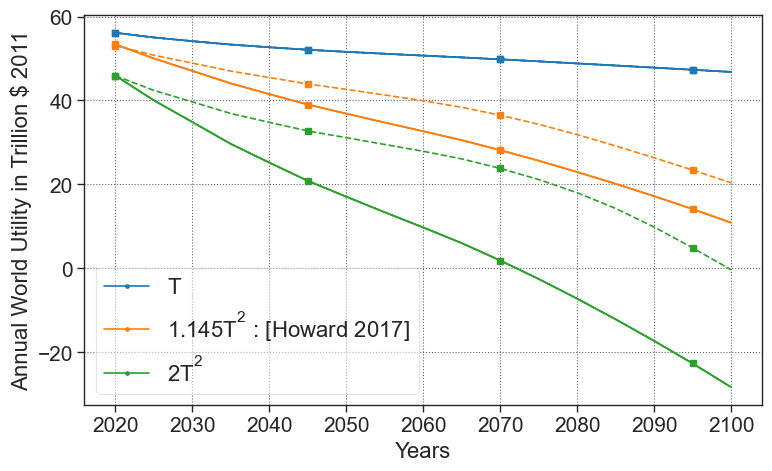

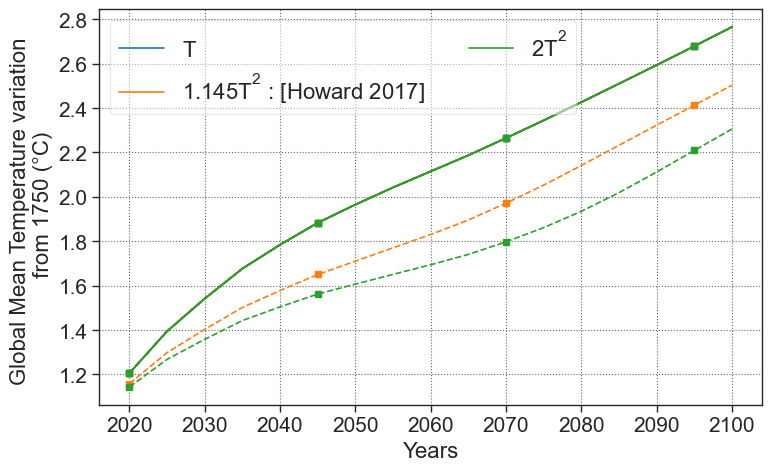

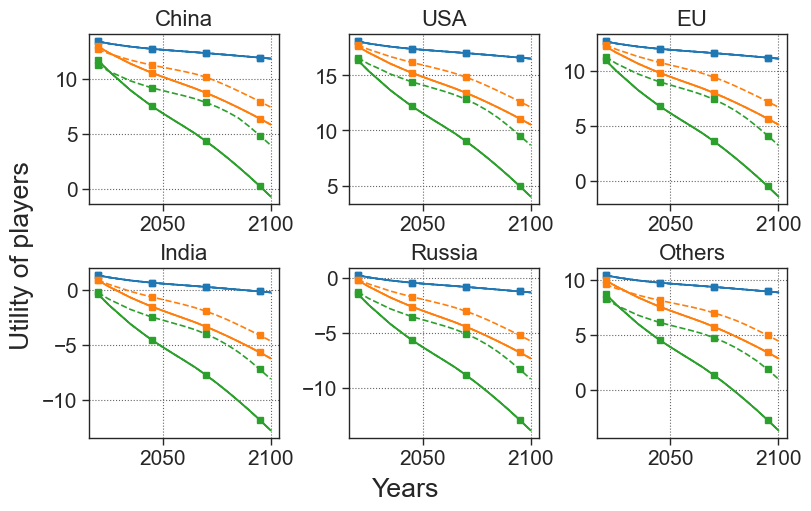

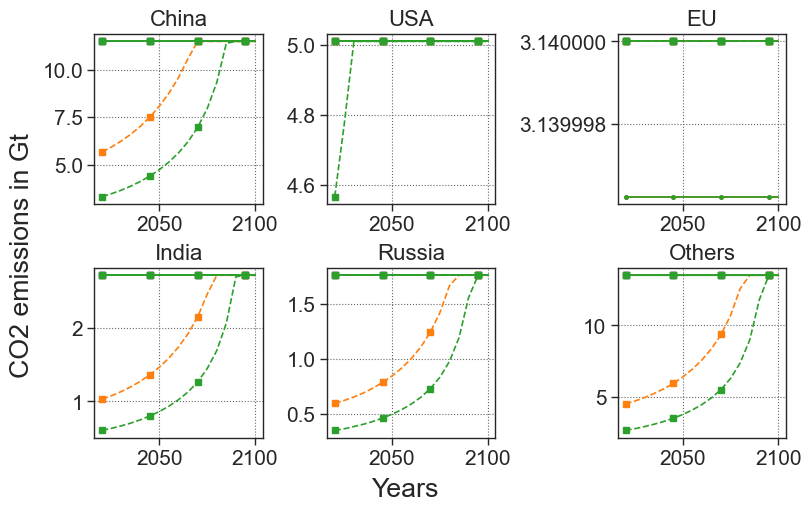

In [57]:
list_ne = []
list_so = []
list_ne_u = []
list_so_u = []
list_ne_planning_u = []
list_so_planning_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
list_ne_planning = []
list_so_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, temperature_target=temperature_target, final_multiplier = final_multiplier)

    X = 2020 + np.arange(game.T)*5
    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    game.reset()
    
    game.planning_BRD()
    game.planning_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_ne_planning_u.append(game.ne_u_planning_brd)
    
    list_so.append(game.so_a_p)

    list_so_u.append(game.so_u_p)
    list_so_planning_u.append(game.so_u_planning)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)

    list_ne_planning.append(game.ne_a_planning_brd)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd)
    list_temp_planning.append(game.ne_temp_planning_brd)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd)

    list_so_planning.append(game.so_a_planning)

    list_sum_action_planning_so.append(game.so_sum_a_planning)
    list_temp_planning_so.append(game.so_temp_planning)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning)

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne_u, list_so_u, list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne, list_so, list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

### Horizon = 2200

In [58]:
horizon = 2200

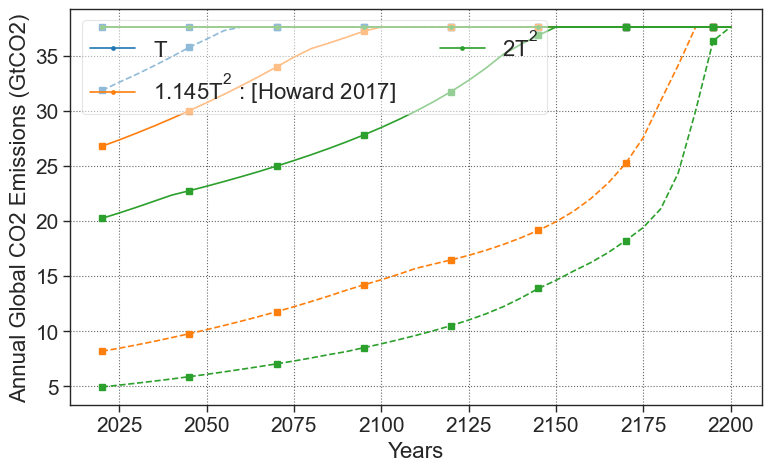

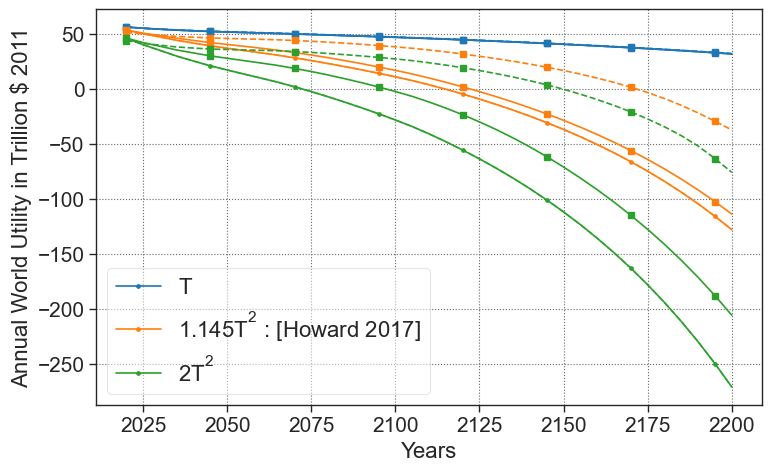

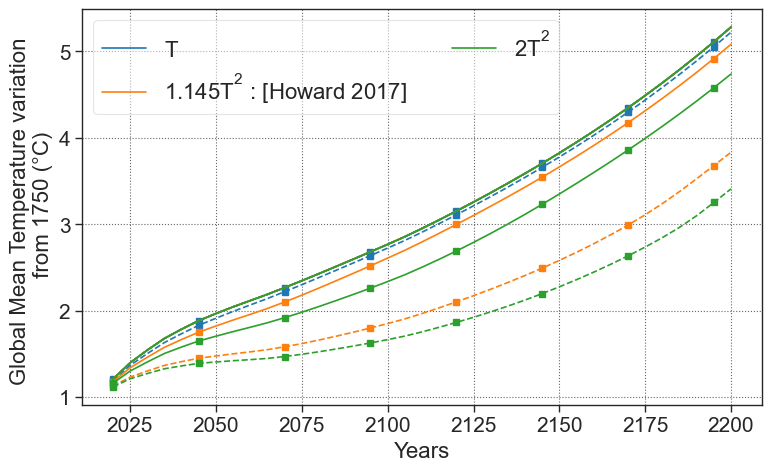

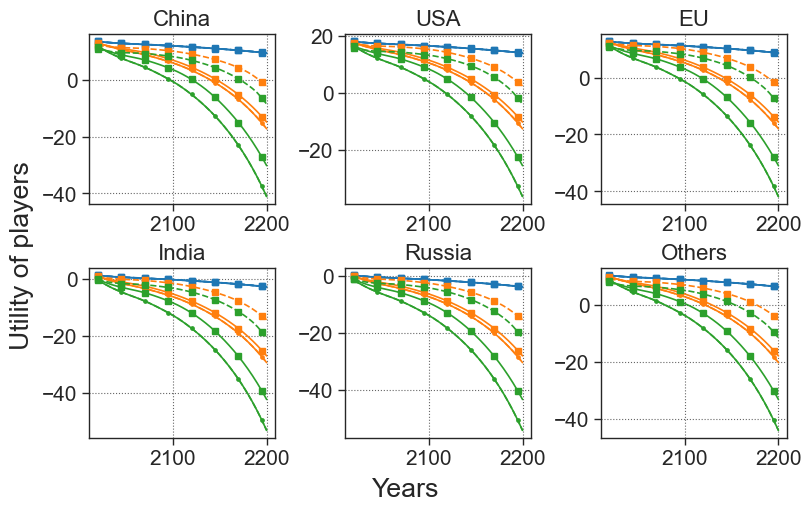

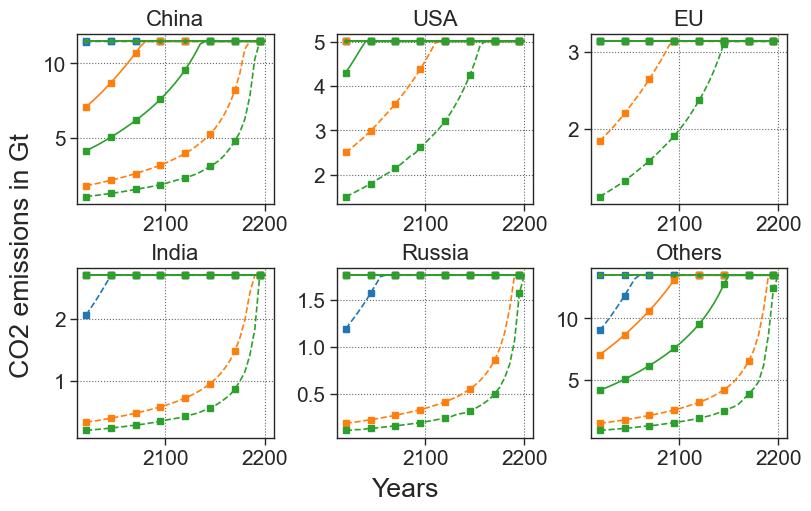

In [59]:
list_ne = []
list_so = []
list_ne_u = []
list_so_u = []
list_ne_planning_u = []
list_so_planning_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
list_ne_planning = []
list_so_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, temperature_target=temperature_target, final_multiplier = final_multiplier)

    X = 2020 + np.arange(game.T)*5
    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    game.reset()
    
    game.planning_BRD()
    game.planning_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_ne_planning_u.append(game.ne_u_planning_brd)
    
    list_so.append(game.so_a_p)

    list_so_u.append(game.so_u_p)
    list_so_planning_u.append(game.so_u_planning)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)

    list_ne_planning.append(game.ne_a_planning_brd)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd)
    list_temp_planning.append(game.ne_temp_planning_brd)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd)

    list_so_planning.append(game.so_a_planning)

    list_sum_action_planning_so.append(game.so_sum_a_planning)
    list_temp_planning_so.append(game.so_temp_planning)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning)

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne_u, list_so_u, list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne, list_so, list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

## Convex

In [60]:
list_benefit_functions=BENEFITS_CONVEX
case = 'convex'

### Horizon = 2100

In [61]:
horizon = 2100

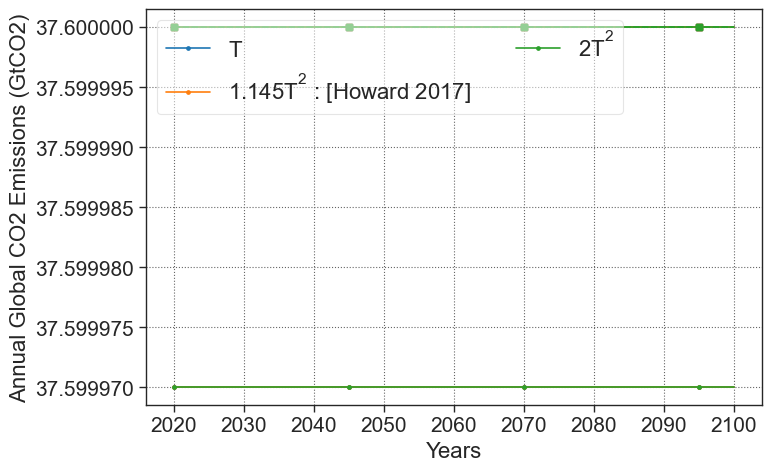

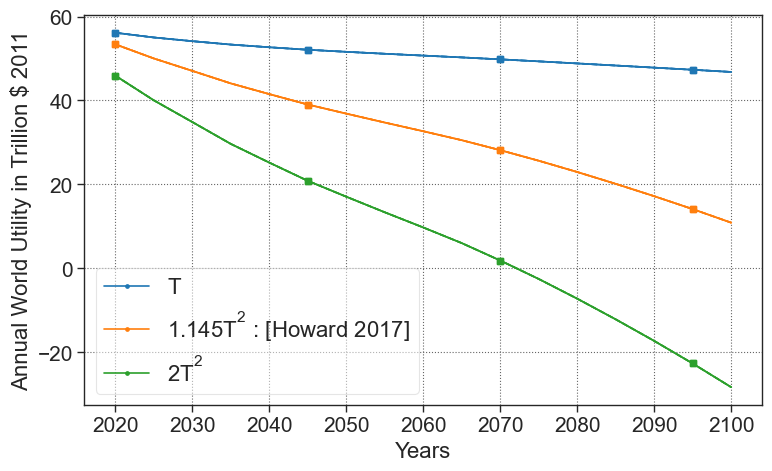

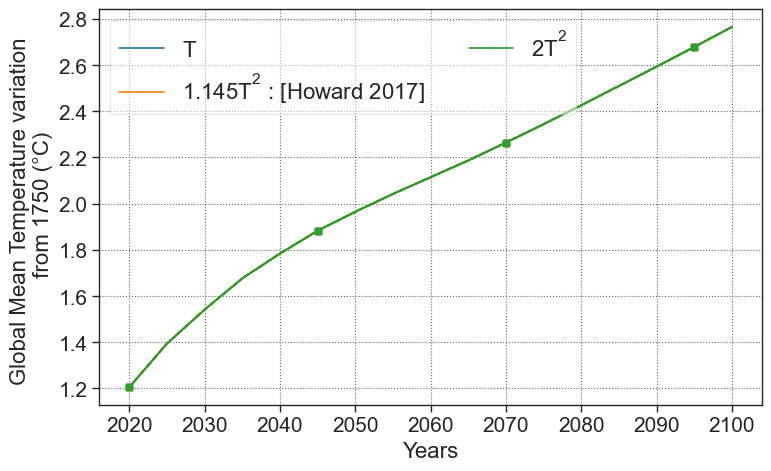

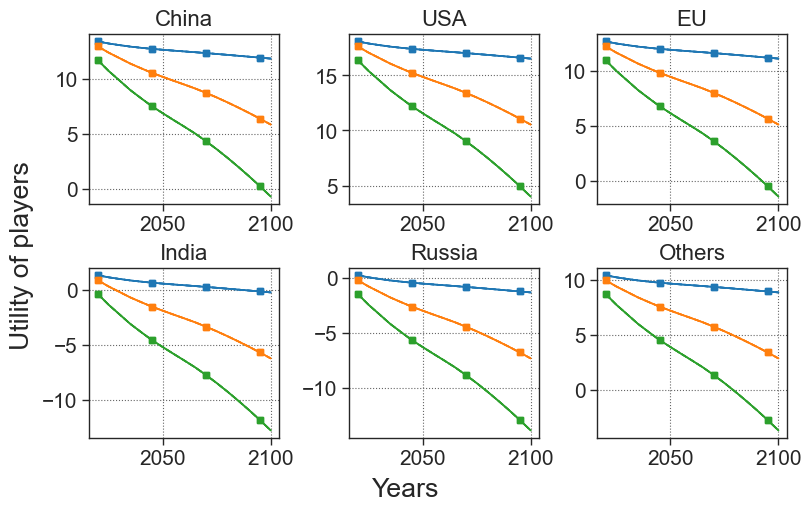

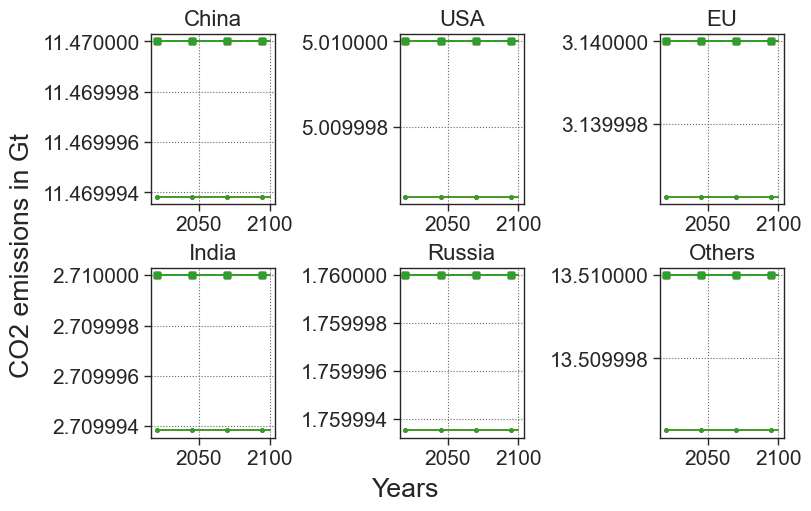

In [62]:
list_ne = []
list_so = []
list_ne_u = []
list_so_u = []
list_ne_planning_u = []
list_so_planning_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
list_ne_planning = []
list_so_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, temperature_target=temperature_target, final_multiplier = final_multiplier)

    X = 2020 + np.arange(game.T)*5
    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    game.reset()
    
    game.planning_BRD()
    game.planning_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_ne_planning_u.append(game.ne_u_planning_brd)
    
    list_so.append(game.so_a_p)

    list_so_u.append(game.so_u_p)
    list_so_planning_u.append(game.so_u_planning)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)

    list_ne_planning.append(game.ne_a_planning_brd)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd)
    list_temp_planning.append(game.ne_temp_planning_brd)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd)

    list_so_planning.append(game.so_a_planning)

    list_sum_action_planning_so.append(game.so_sum_a_planning)
    list_temp_planning_so.append(game.so_temp_planning)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning)

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne_u, list_so_u, list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne, list_so, list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

### Horizon = 2200

In [63]:
horizon = 2200

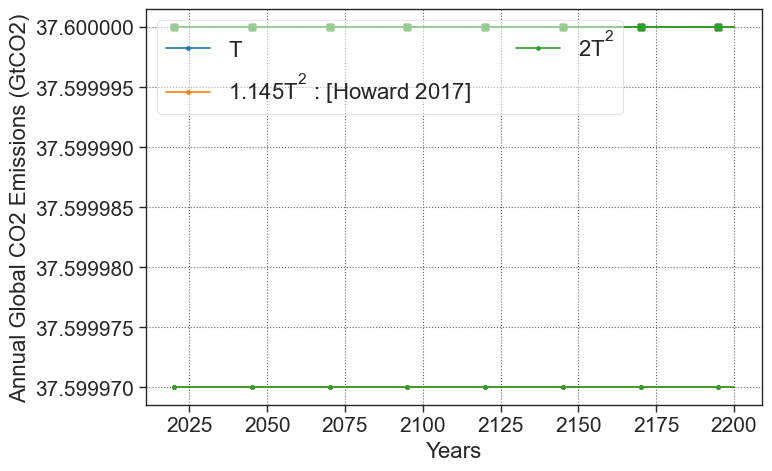

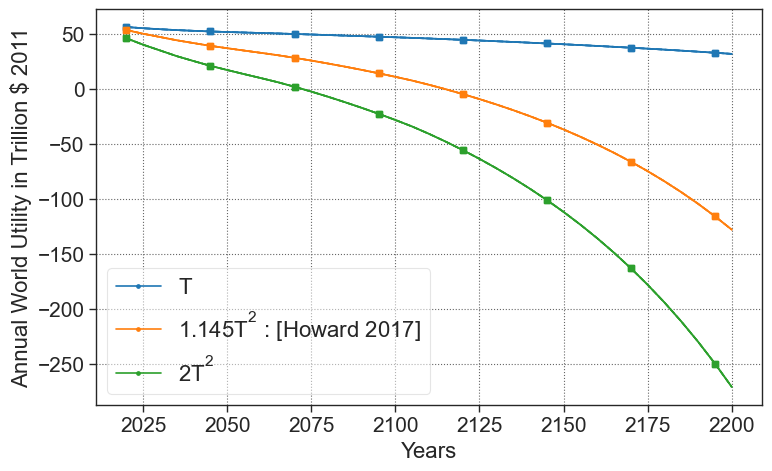

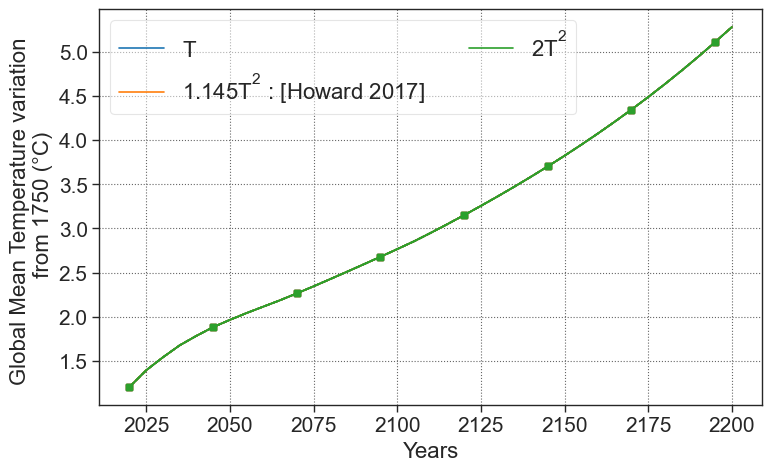

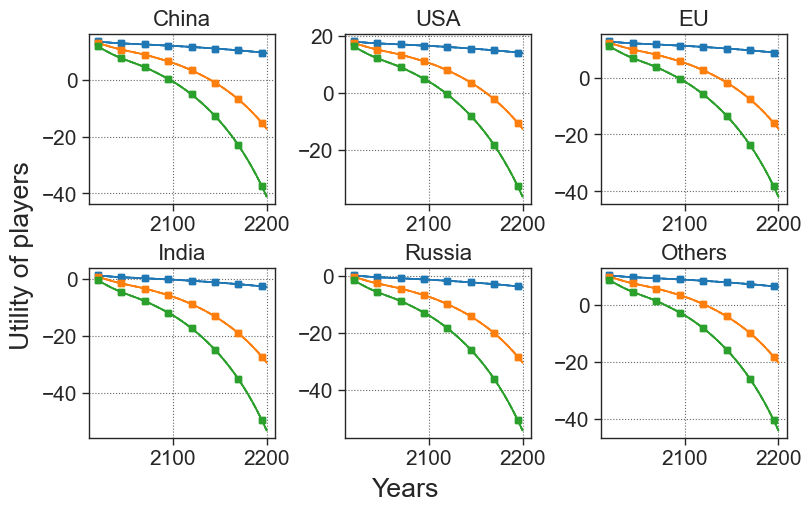

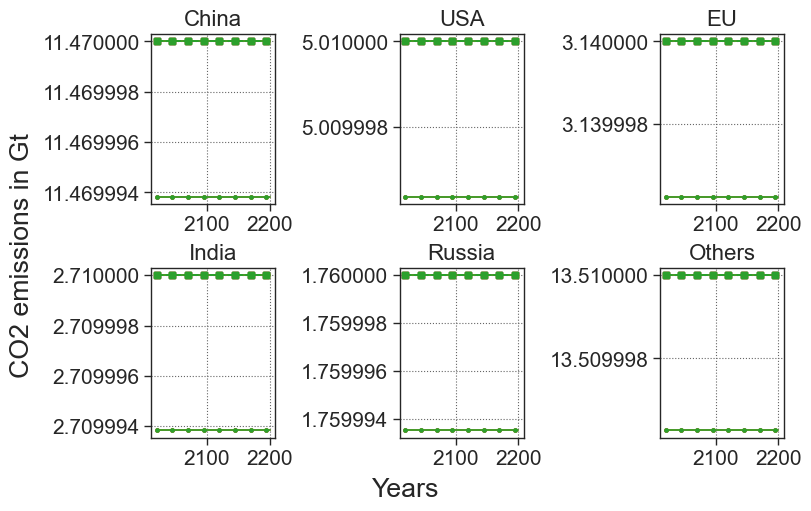

In [64]:
list_ne = []
list_so = []
list_ne_u = []
list_so_u = []
list_ne_planning_u = []
list_so_planning_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
list_ne_planning = []
list_so_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, temperature_target=temperature_target, final_multiplier = final_multiplier)

    X = 2020 + np.arange(game.T)*5
    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    game.reset()
    
    game.planning_BRD()
    game.planning_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_ne_planning_u.append(game.ne_u_planning_brd)
    
    list_so.append(game.so_a_p)

    list_so_u.append(game.so_u_p)
    list_so_planning_u.append(game.so_u_planning)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)

    list_ne_planning.append(game.ne_a_planning_brd)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd)
    list_temp_planning.append(game.ne_temp_planning_brd)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd)

    list_so_planning.append(game.so_a_planning)

    list_sum_action_planning_so.append(game.so_sum_a_planning)
    list_temp_planning_so.append(game.so_temp_planning)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning)

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne_u, list_so_u, list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne, list_so, list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

## Sigmoid


In [24]:
list_benefit_functions=BENEFITS_SIGMOID
case = 'sigmoid'

### Horizon = 2100

In [25]:
horizon = 2100

In [26]:
list_ne = []
list_so = []
list_ne_u = []
list_so_u = []
list_ne_planning_u = []
list_so_planning_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
list_ne_planning = []
list_so_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, temperature_target=temperature_target, final_multiplier = final_multiplier)

    X = 2020 + np.arange(game.T)*5
    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    game.reset()
    
    game.planning_BRD()
    game.planning_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_ne_planning_u.append(game.ne_u_planning_brd)
    
    list_so.append(game.so_a_p)

    list_so_u.append(game.so_u_p)
    list_so_planning_u.append(game.so_u_planning)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)

    list_ne_planning.append(game.ne_a_planning_brd)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd)
    list_temp_planning.append(game.ne_temp_planning_brd)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd)

    list_so_planning.append(game.so_a_planning)

    list_sum_action_planning_so.append(game.so_sum_a_planning)
    list_temp_planning_so.append(game.so_temp_planning)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning)

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne_u, list_so_u, list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne, list_so, list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

NameError: name 'temperature_target' is not defined

### Horizon = 2200

In [ ]:
horizon = 2200

In [27]:
list_ne = []
list_so = []
list_ne_u = []
list_so_u = []
list_ne_planning_u = []
list_so_planning_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
list_ne_planning = []
list_so_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, temperature_target=temperature_target, final_multiplier = final_multiplier)

    X = 2020 + np.arange(game.T)*5
    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    game.reset()
    
    game.planning_BRD()
    game.planning_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_ne_planning_u.append(game.ne_u_planning_brd)
    
    list_so.append(game.so_a_p)

    list_so_u.append(game.so_u_p)
    list_so_planning_u.append(game.so_u_planning)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)

    list_ne_planning.append(game.ne_a_planning_brd)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd)
    list_temp_planning.append(game.ne_temp_planning_brd)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd)

    list_so_planning.append(game.so_a_planning)

    list_sum_action_planning_so.append(game.so_sum_a_planning)
    list_temp_planning_so.append(game.so_temp_planning)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning)

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne_u, list_so_u, list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne, list_so, list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

NameError: name 'temperature_target' is not defined

# With temperature Target = 1.5

In [70]:
temperature_target = 1.5
final_multiplier = 1e2

## Concave

In [71]:
list_benefit_functions=BENEFITS_CONCAVE
case = 'concave_temp_target'

### Horizon = 2100

In [72]:
horizon = 2100

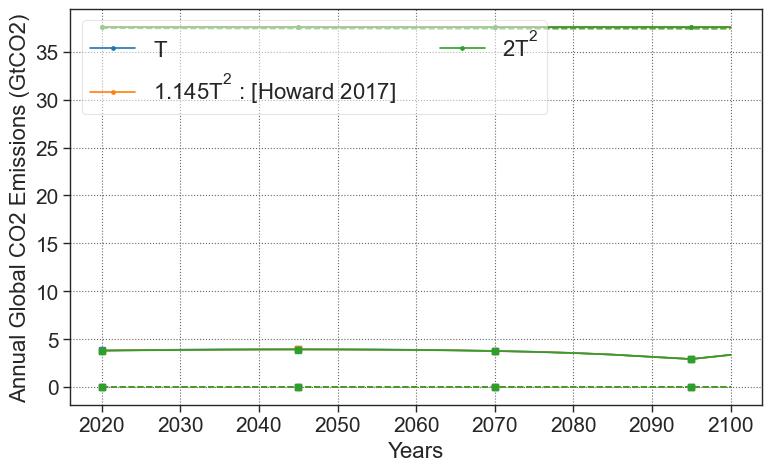

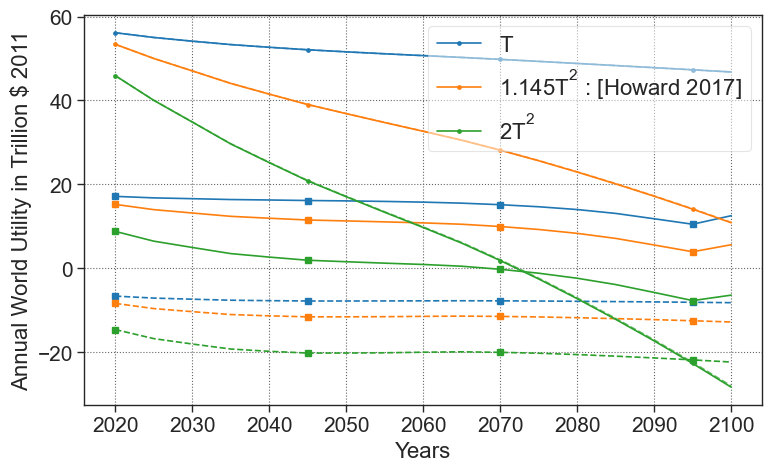

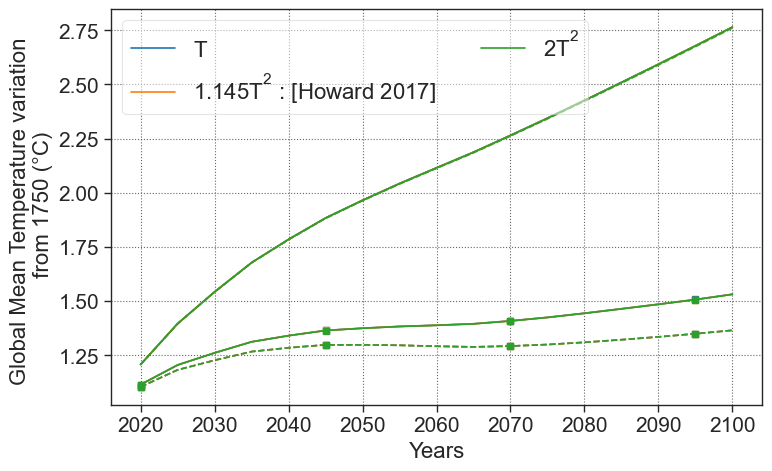

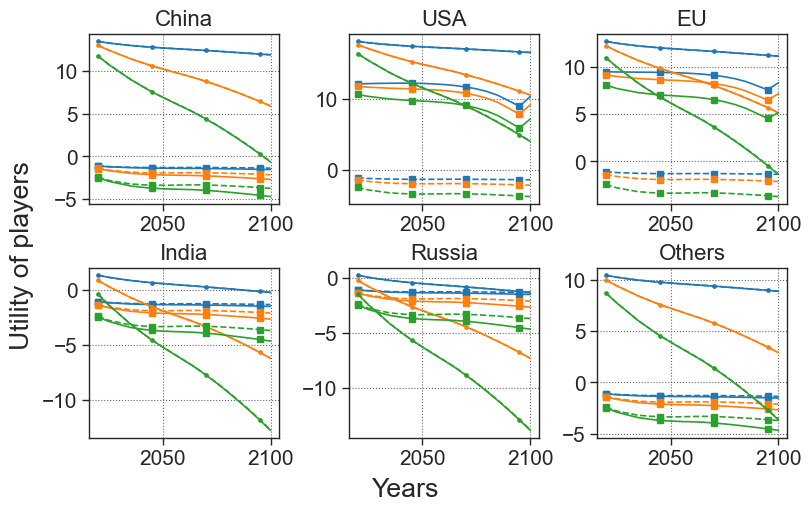

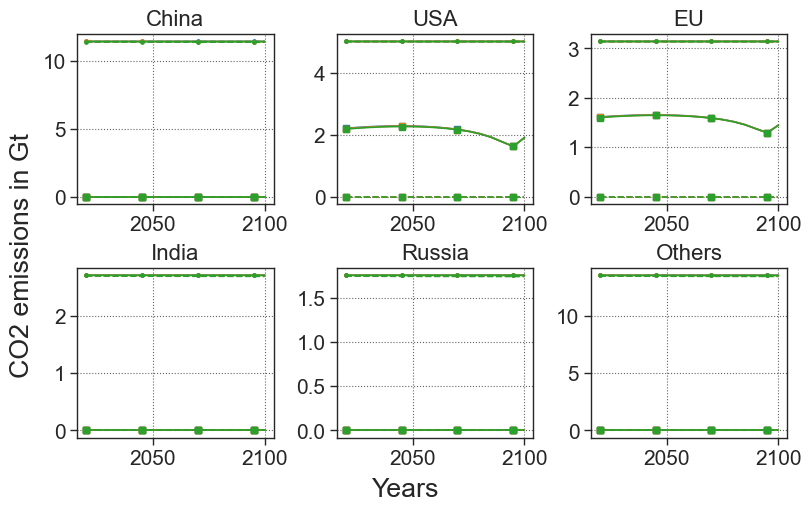

In [73]:
list_ne = []
list_so = []
list_ne_u = []
list_so_u = []
list_ne_planning_u = []
list_so_planning_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
list_ne_planning = []
list_so_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, temperature_target=temperature_target, final_multiplier = final_multiplier)

    X = 2020 + np.arange(game.T)*5
    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    game.reset()
    
    game.planning_BRD()
    game.planning_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_ne_planning_u.append(game.ne_u_planning_brd)
    
    list_so.append(game.so_a_p)

    list_so_u.append(game.so_u_p)
    list_so_planning_u.append(game.so_u_planning)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)

    list_ne_planning.append(game.ne_a_planning_brd)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd)
    list_temp_planning.append(game.ne_temp_planning_brd)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd)

    list_so_planning.append(game.so_a_planning)

    list_sum_action_planning_so.append(game.so_sum_a_planning)
    list_temp_planning_so.append(game.so_temp_planning)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning)

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne_u, list_so_u, list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne, list_so, list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

### Horizon = 2200

In [74]:
horizon = 2200

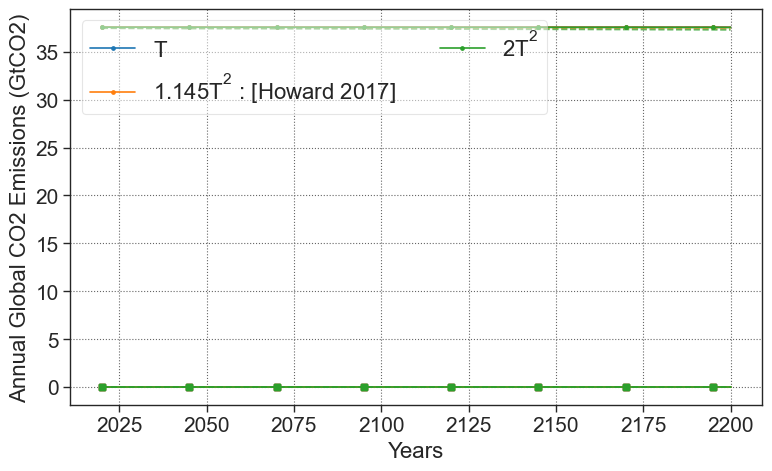

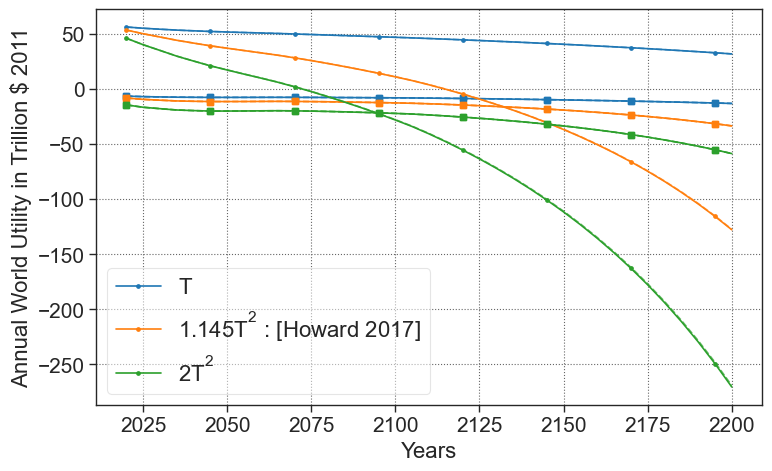

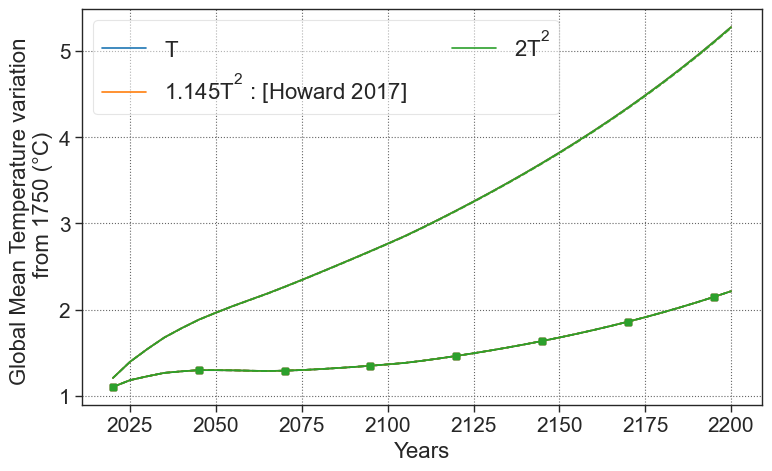

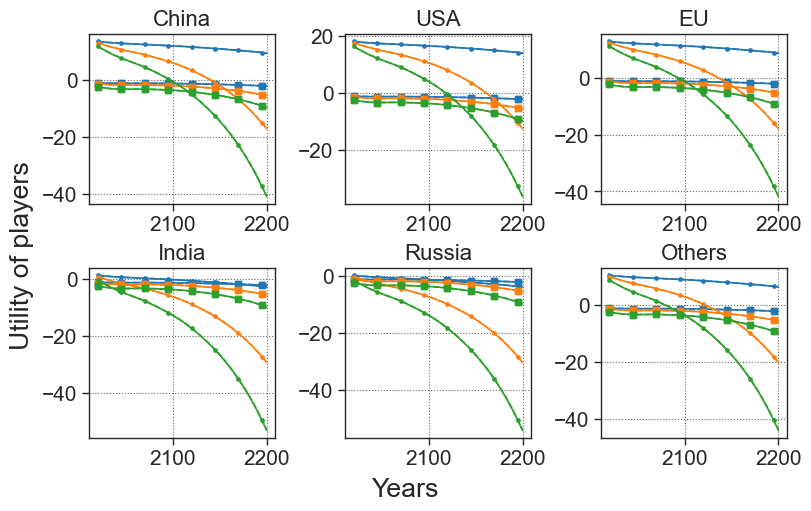

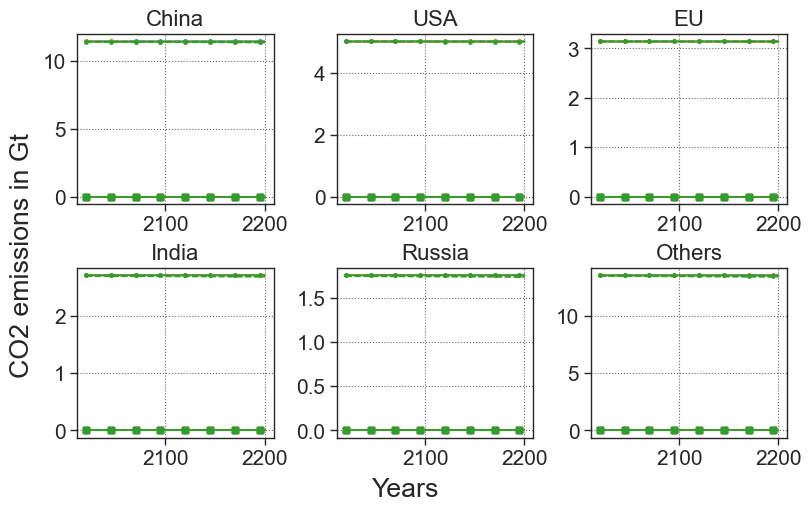

In [75]:
list_ne = []
list_so = []
list_ne_u = []
list_so_u = []
list_ne_planning_u = []
list_so_planning_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
list_ne_planning = []
list_so_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, temperature_target=temperature_target, final_multiplier = final_multiplier)

    X = 2020 + np.arange(game.T)*5
    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    game.reset()
    
    game.planning_BRD()
    game.planning_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_ne_planning_u.append(game.ne_u_planning_brd)
    
    list_so.append(game.so_a_p)

    list_so_u.append(game.so_u_p)
    list_so_planning_u.append(game.so_u_planning)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)

    list_ne_planning.append(game.ne_a_planning_brd)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd)
    list_temp_planning.append(game.ne_temp_planning_brd)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd)

    list_so_planning.append(game.so_a_planning)

    list_sum_action_planning_so.append(game.so_sum_a_planning)
    list_temp_planning_so.append(game.so_temp_planning)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning)

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne_u, list_so_u, list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne, list_so, list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

## Concave Log

In [76]:
list_benefit_functions=BENEFITS_LOG
case = 'log_temp_target'

### Horizon = 2100

In [77]:
horizon = 2100

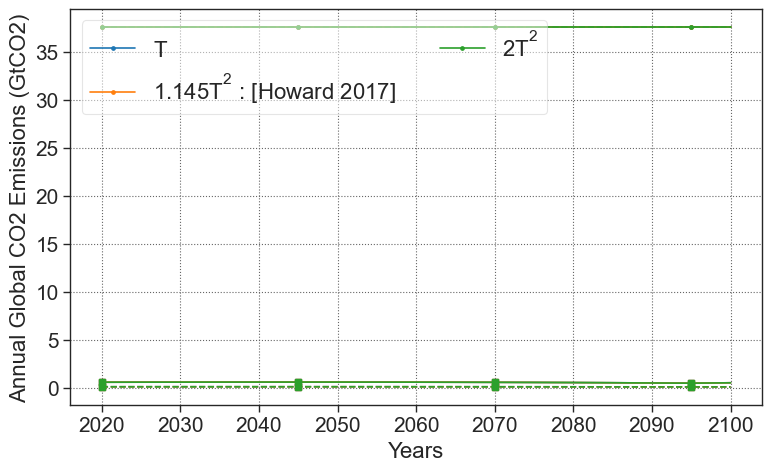

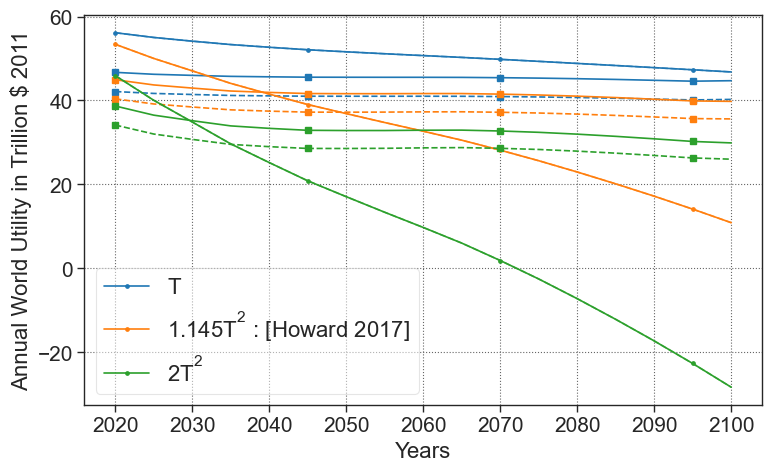

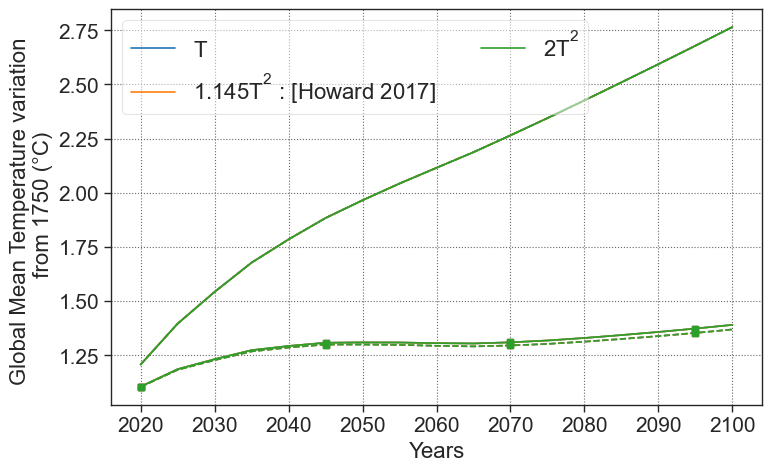

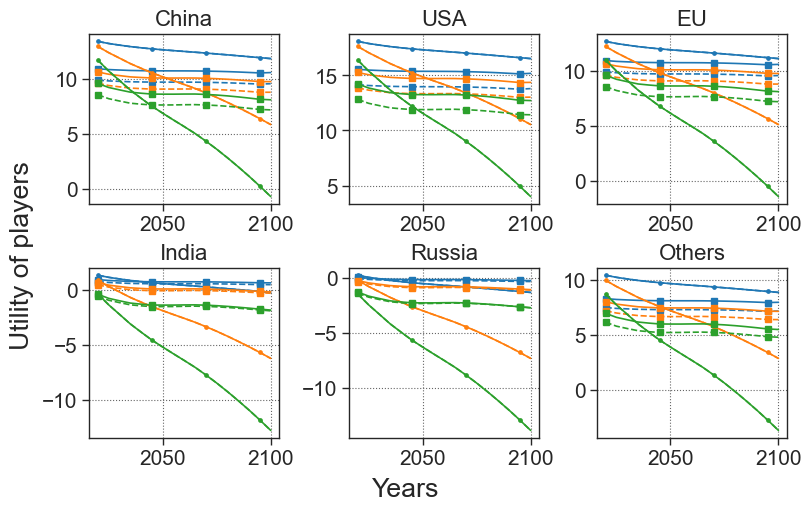

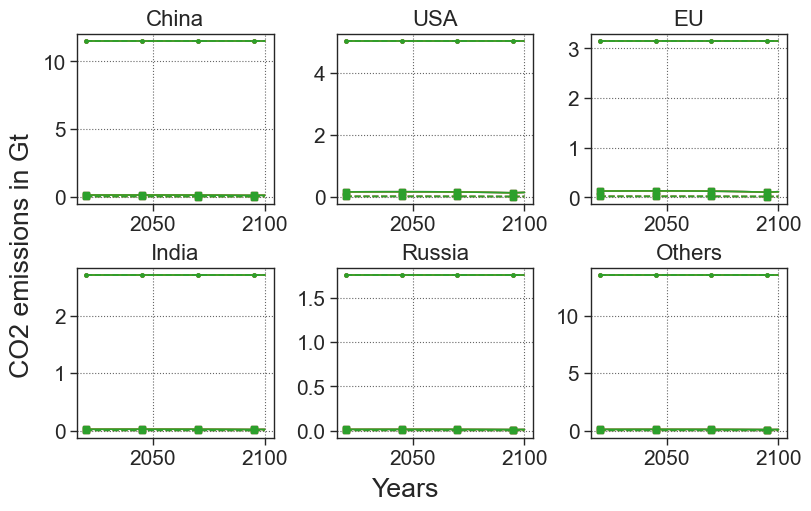

In [78]:
list_ne = []
list_so = []
list_ne_u = []
list_so_u = []
list_ne_planning_u = []
list_so_planning_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
list_ne_planning = []
list_so_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, temperature_target=temperature_target, final_multiplier = final_multiplier)

    X = 2020 + np.arange(game.T)*5
    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    game.reset()
    
    game.planning_BRD()
    game.planning_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_ne_planning_u.append(game.ne_u_planning_brd)
    
    list_so.append(game.so_a_p)

    list_so_u.append(game.so_u_p)
    list_so_planning_u.append(game.so_u_planning)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)

    list_ne_planning.append(game.ne_a_planning_brd)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd)
    list_temp_planning.append(game.ne_temp_planning_brd)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd)

    list_so_planning.append(game.so_a_planning)

    list_sum_action_planning_so.append(game.so_sum_a_planning)
    list_temp_planning_so.append(game.so_temp_planning)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning)

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne_u, list_so_u, list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne, list_so, list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

### Horizon = 2200

In [79]:
horizon = 2200

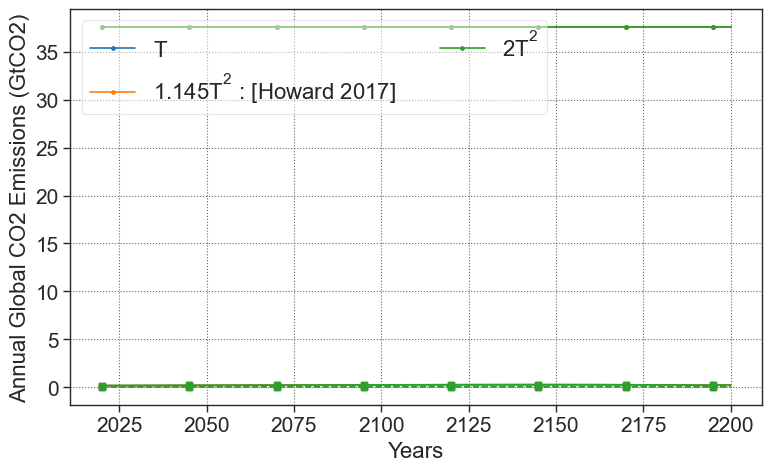

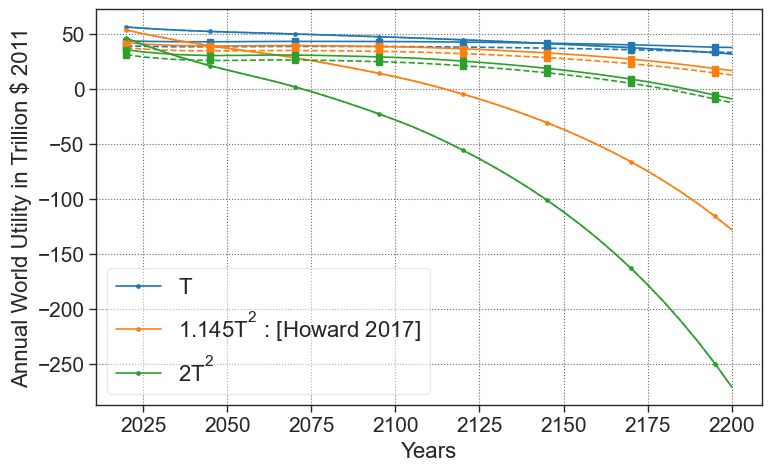

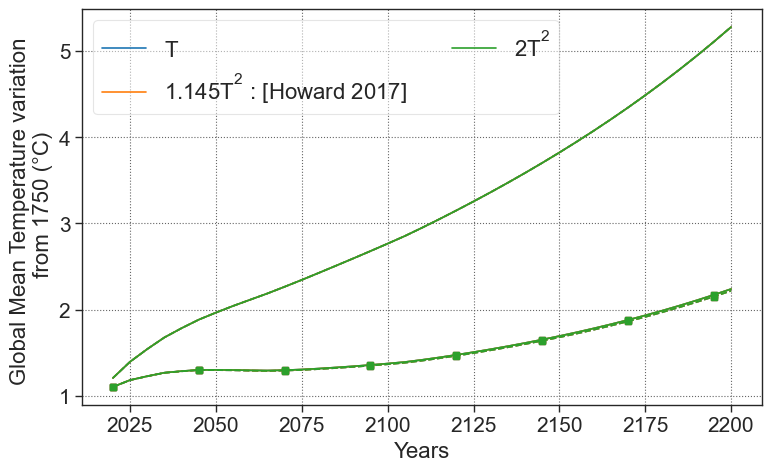

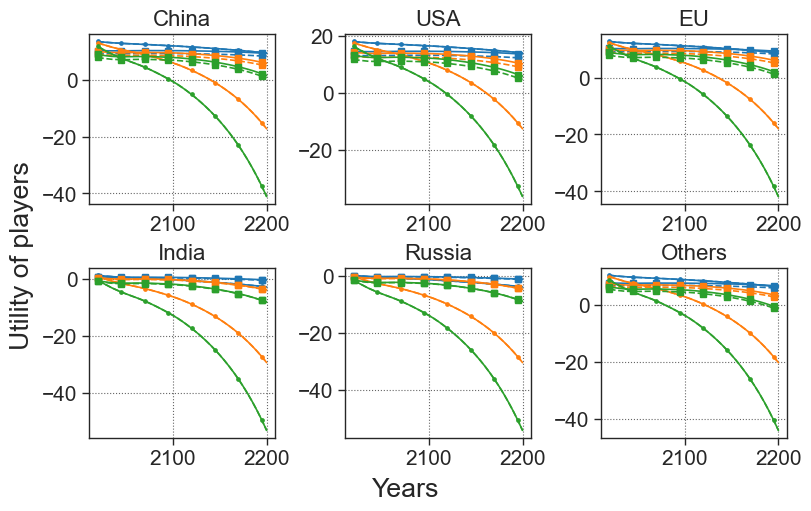

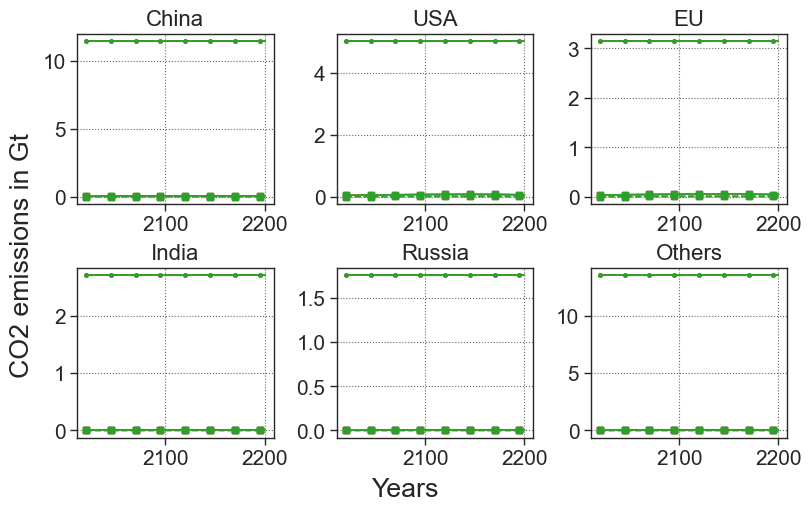

In [80]:
list_ne = []
list_so = []
list_ne_u = []
list_so_u = []
list_ne_planning_u = []
list_so_planning_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
list_ne_planning = []
list_so_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, temperature_target=temperature_target, final_multiplier = final_multiplier)

    X = 2020 + np.arange(game.T)*5
    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    game.reset()
    
    game.planning_BRD()
    game.planning_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_ne_planning_u.append(game.ne_u_planning_brd)
    
    list_so.append(game.so_a_p)

    list_so_u.append(game.so_u_p)
    list_so_planning_u.append(game.so_u_planning)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)

    list_ne_planning.append(game.ne_a_planning_brd)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd)
    list_temp_planning.append(game.ne_temp_planning_brd)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd)

    list_so_planning.append(game.so_a_planning)

    list_sum_action_planning_so.append(game.so_sum_a_planning)
    list_temp_planning_so.append(game.so_temp_planning)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning)

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne_u, list_so_u, list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne, list_so, list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

## Convex

In [81]:
list_benefit_functions=BENEFITS_CONVEX
case = 'convex_temp_target'

### Horizon = 2100

In [82]:
horizon = 2100

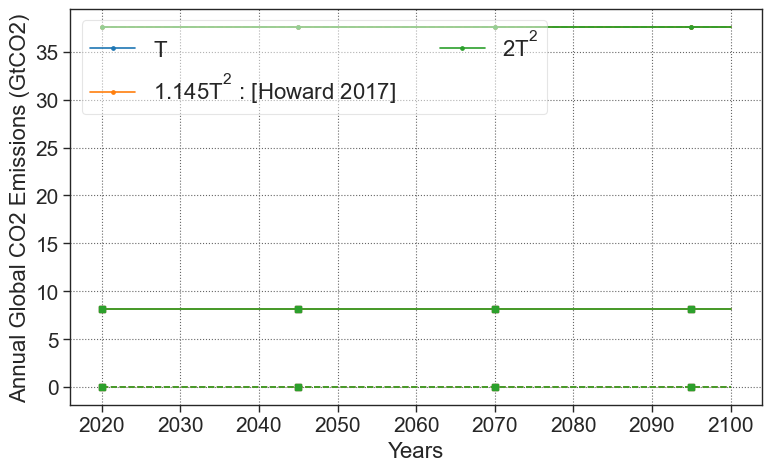

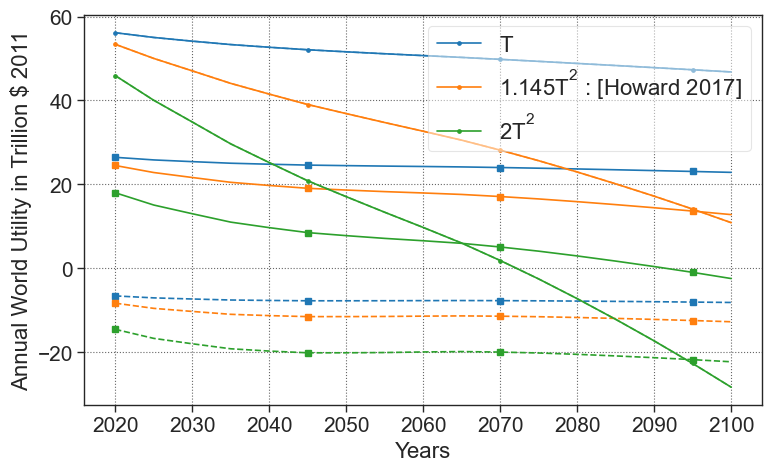

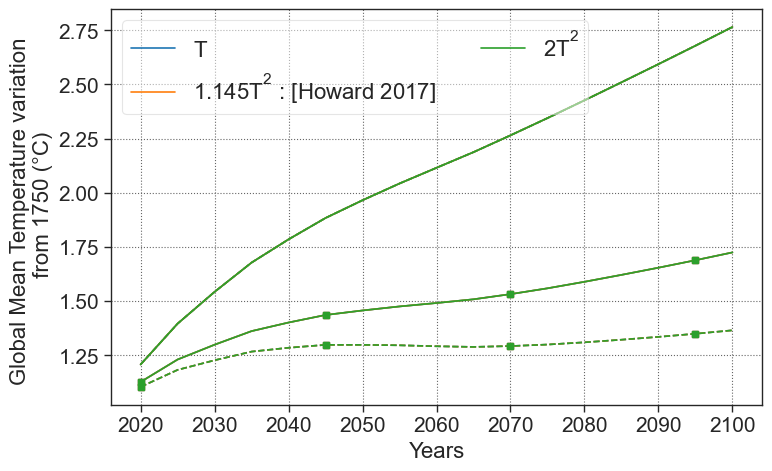

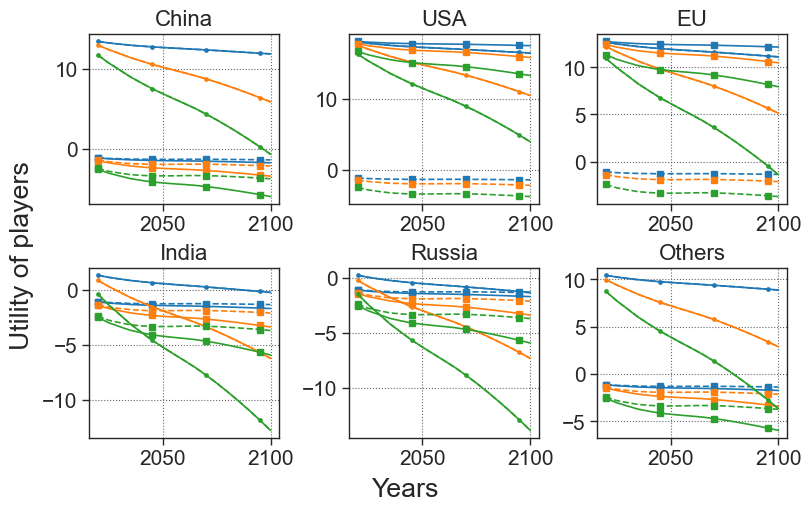

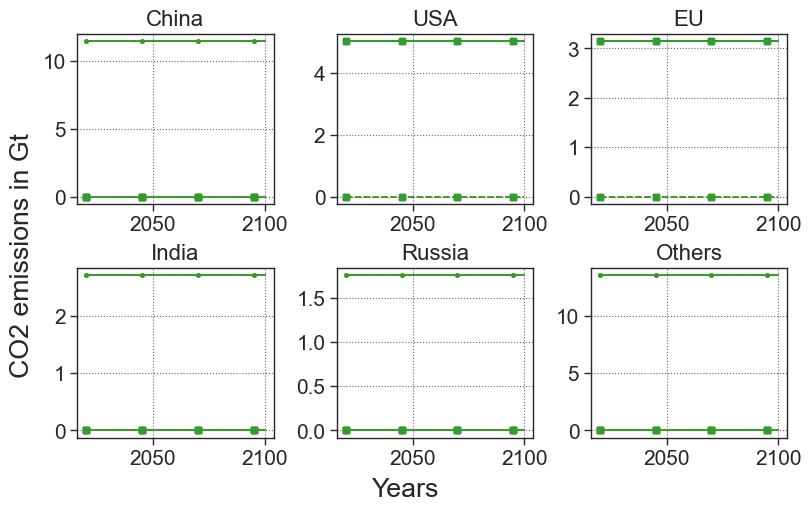

In [83]:
list_ne = []
list_so = []
list_ne_u = []
list_so_u = []
list_ne_planning_u = []
list_so_planning_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
list_ne_planning = []
list_so_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, temperature_target=temperature_target, final_multiplier = final_multiplier)

    X = 2020 + np.arange(game.T)*5
    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    game.reset()
    
    game.planning_BRD()
    game.planning_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_ne_planning_u.append(game.ne_u_planning_brd)
    
    list_so.append(game.so_a_p)

    list_so_u.append(game.so_u_p)
    list_so_planning_u.append(game.so_u_planning)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)

    list_ne_planning.append(game.ne_a_planning_brd)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd)
    list_temp_planning.append(game.ne_temp_planning_brd)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd)

    list_so_planning.append(game.so_a_planning)

    list_sum_action_planning_so.append(game.so_sum_a_planning)
    list_temp_planning_so.append(game.so_temp_planning)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning)

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne_u, list_so_u, list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne, list_so, list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

### Horizon = 2200

In [84]:
horizon = 2200

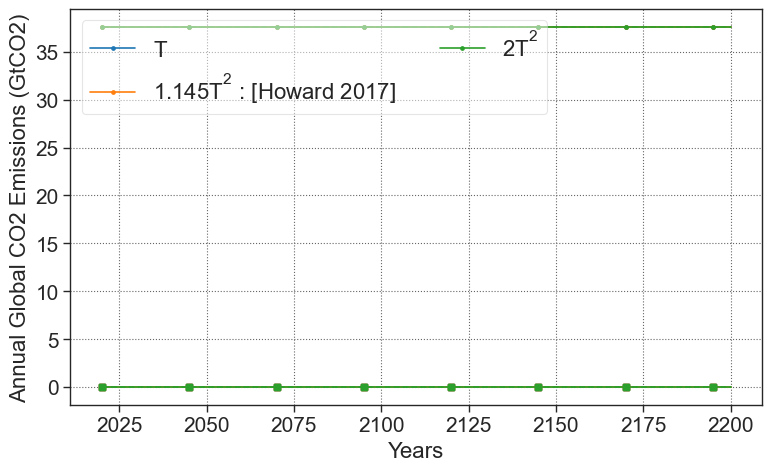

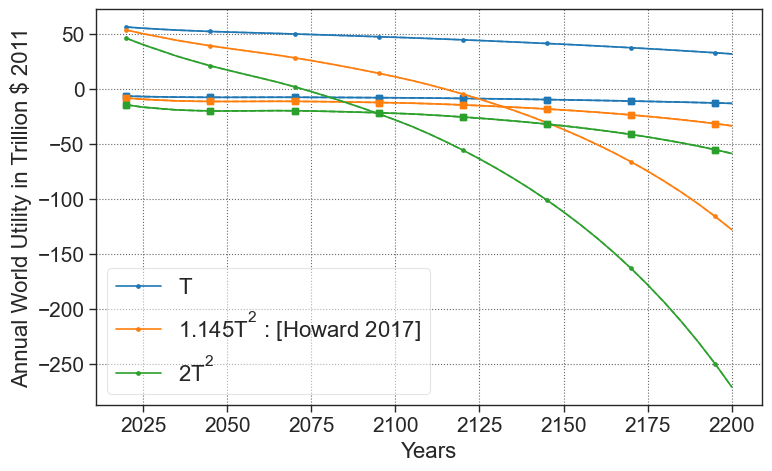

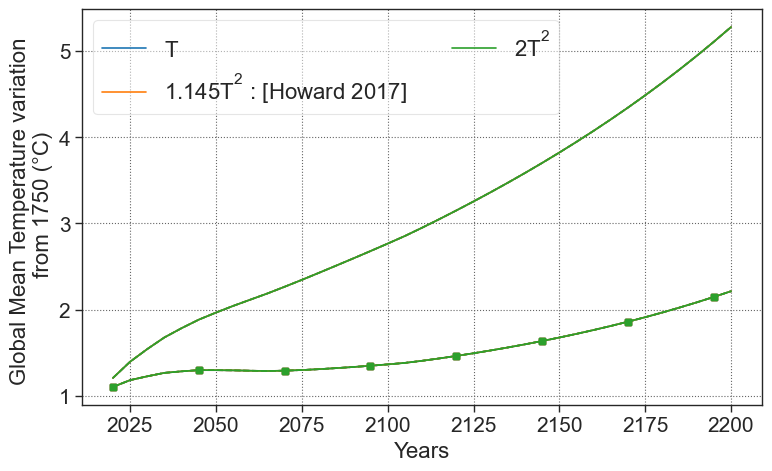

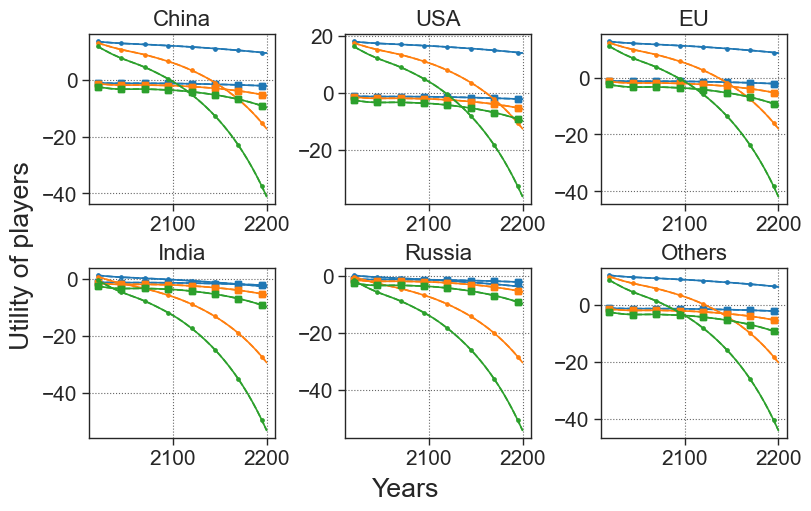

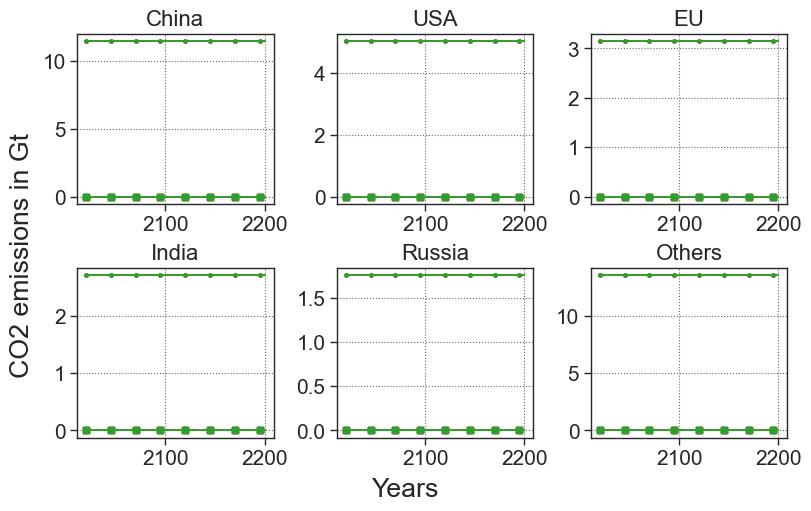

In [85]:
list_ne = []
list_so = []
list_ne_u = []
list_so_u = []
list_ne_planning_u = []
list_so_planning_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
list_ne_planning = []
list_so_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, temperature_target=temperature_target, final_multiplier = final_multiplier)

    X = 2020 + np.arange(game.T)*5
    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    game.reset()
    
    game.planning_BRD()
    game.planning_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_ne_planning_u.append(game.ne_u_planning_brd)
    
    list_so.append(game.so_a_p)

    list_so_u.append(game.so_u_p)
    list_so_planning_u.append(game.so_u_planning)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)

    list_ne_planning.append(game.ne_a_planning_brd)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd)
    list_temp_planning.append(game.ne_temp_planning_brd)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd)

    list_so_planning.append(game.so_a_planning)

    list_sum_action_planning_so.append(game.so_sum_a_planning)
    list_temp_planning_so.append(game.so_temp_planning)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning)

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne_u, list_so_u, list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne, list_so, list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

## Sigmoid


In [86]:
list_benefit_functions=BENEFITS_SIGMOID
case = 'sigmoid_temp_target'

### Horizon = 2100

In [87]:
horizon = 2100

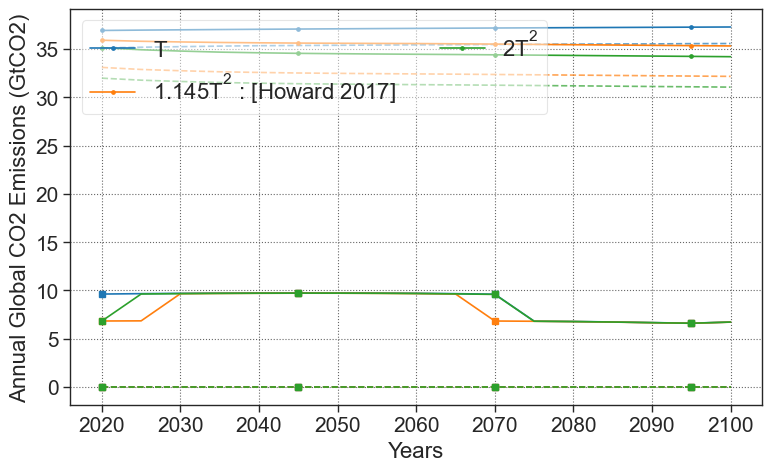

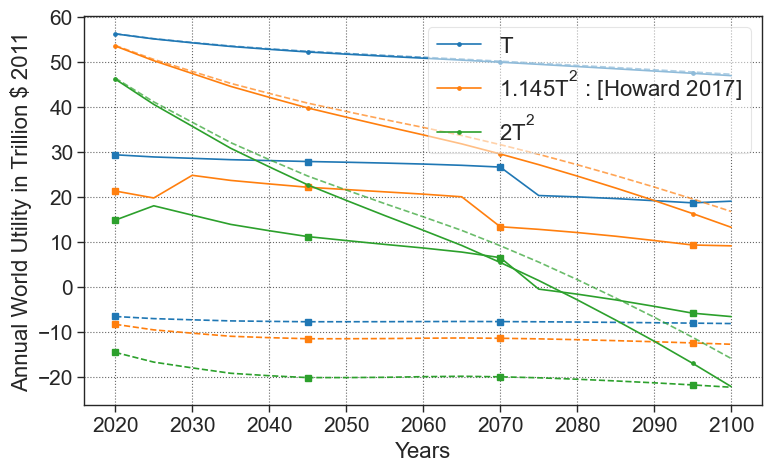

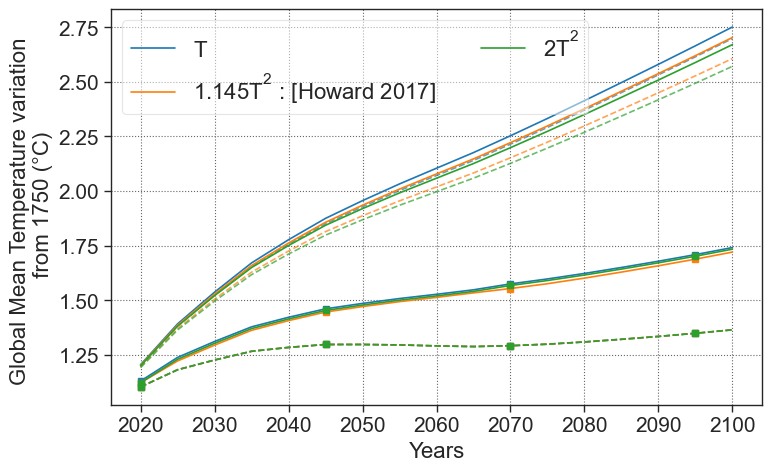

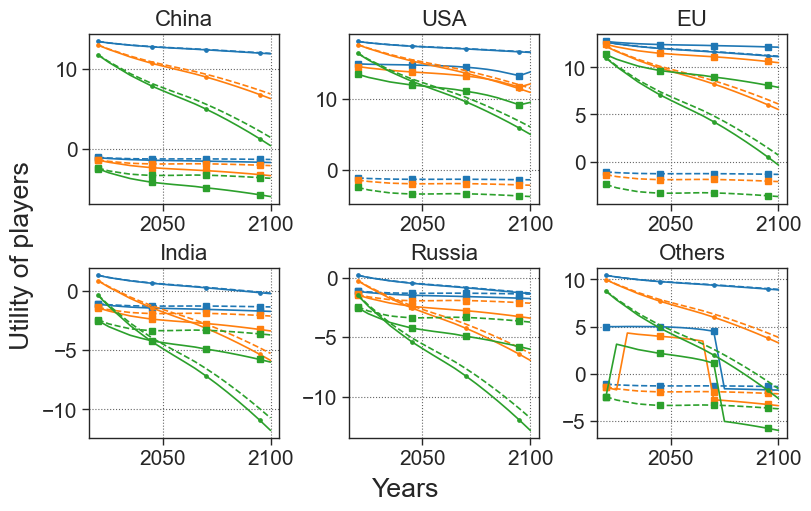

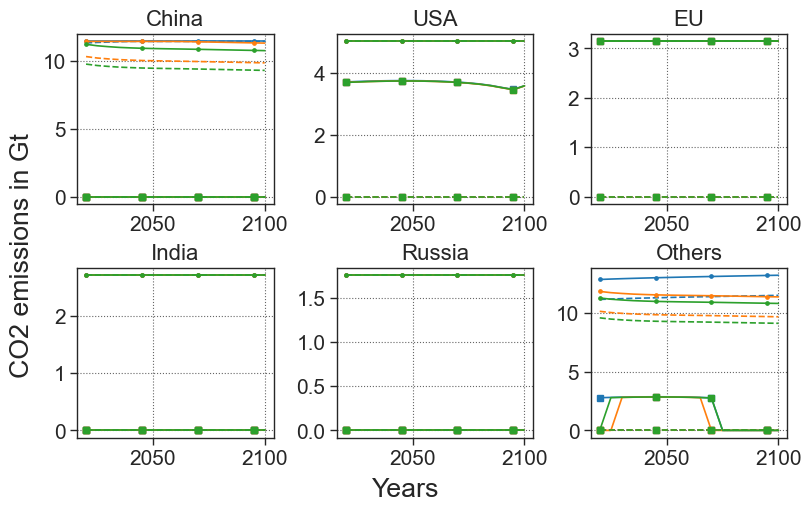

In [88]:
list_ne = []
list_so = []
list_ne_u = []
list_so_u = []
list_ne_planning_u = []
list_so_planning_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
list_ne_planning = []
list_so_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, temperature_target=temperature_target, final_multiplier = final_multiplier)

    X = 2020 + np.arange(game.T)*5
    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    game.reset()
    
    game.planning_BRD()
    game.planning_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_ne_planning_u.append(game.ne_u_planning_brd)
    
    list_so.append(game.so_a_p)

    list_so_u.append(game.so_u_p)
    list_so_planning_u.append(game.so_u_planning)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)

    list_ne_planning.append(game.ne_a_planning_brd)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd)
    list_temp_planning.append(game.ne_temp_planning_brd)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd)

    list_so_planning.append(game.so_a_planning)

    list_sum_action_planning_so.append(game.so_sum_a_planning)
    list_temp_planning_so.append(game.so_temp_planning)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning)

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne_u, list_so_u, list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne, list_so, list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

### Horizon = 2200

In [89]:
horizon = 2200

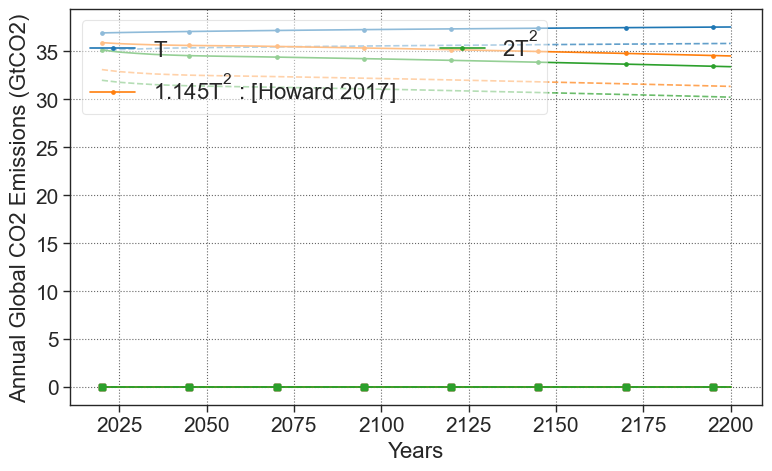

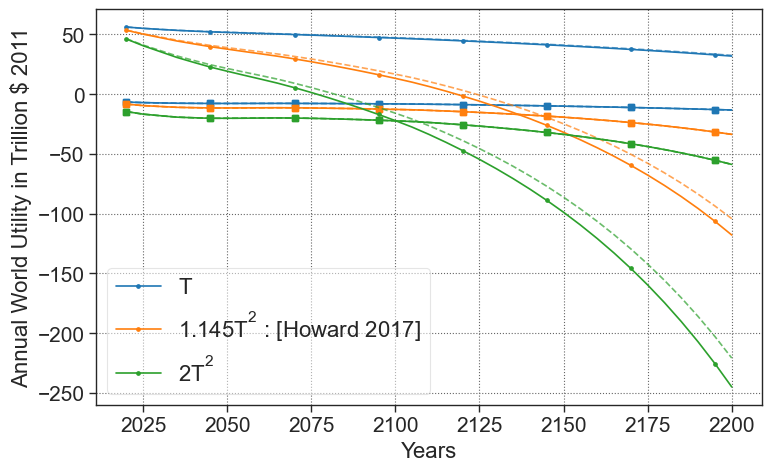

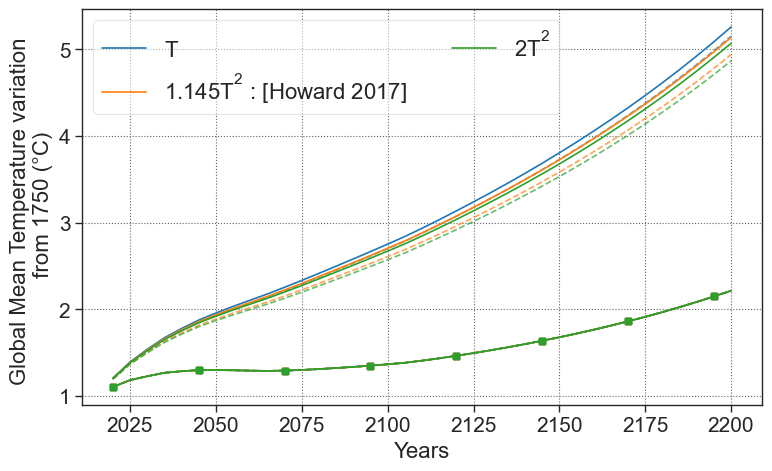

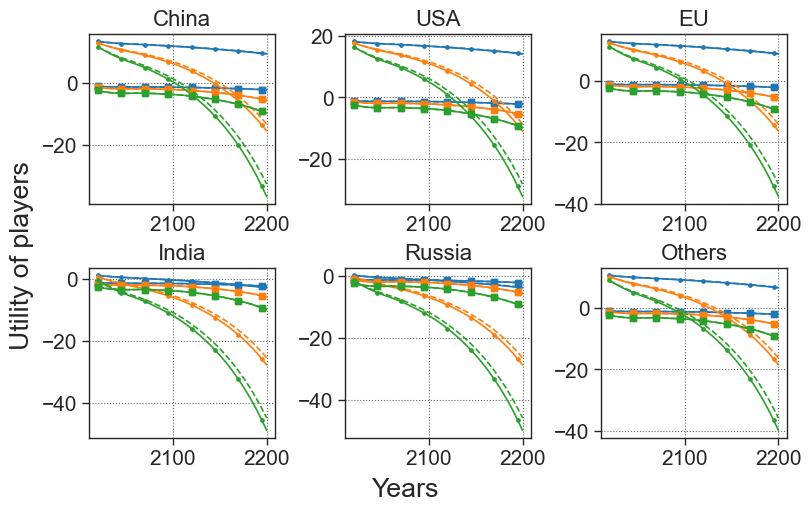

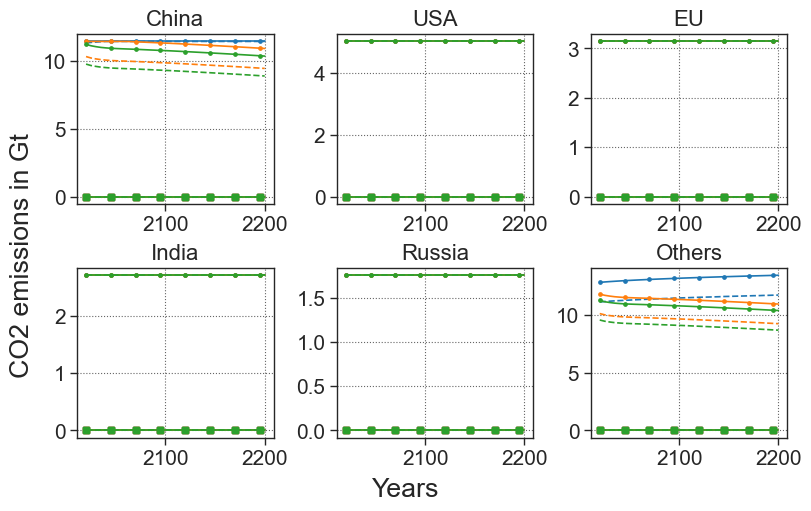

In [90]:
list_ne = []
list_so = []
list_ne_u = []
list_so_u = []
list_ne_planning_u = []
list_so_planning_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
list_ne_planning = []
list_so_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, temperature_target=temperature_target, final_multiplier = final_multiplier)

    X = 2020 + np.arange(game.T)*5
    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    game.reset()
    
    game.planning_BRD()
    game.planning_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_ne_planning_u.append(game.ne_u_planning_brd)
    
    list_so.append(game.so_a_p)

    list_so_u.append(game.so_u_p)
    list_so_planning_u.append(game.so_u_planning)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)

    list_ne_planning.append(game.ne_a_planning_brd)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd)
    list_temp_planning.append(game.ne_temp_planning_brd)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd)

    list_so_planning.append(game.so_a_planning)

    list_sum_action_planning_so.append(game.so_sum_a_planning)
    list_temp_planning_so.append(game.so_temp_planning)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning)

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne_u, list_so_u, list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne, list_so, list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

# Receeding Horizon

## Concave

In [91]:
list_benefit_functions=BENEFITS_CONCAVE
case = 'concave_receeeding'

In [92]:
damage_coef = np.array([0,0,1.1450])

In [93]:
horizon = 2100

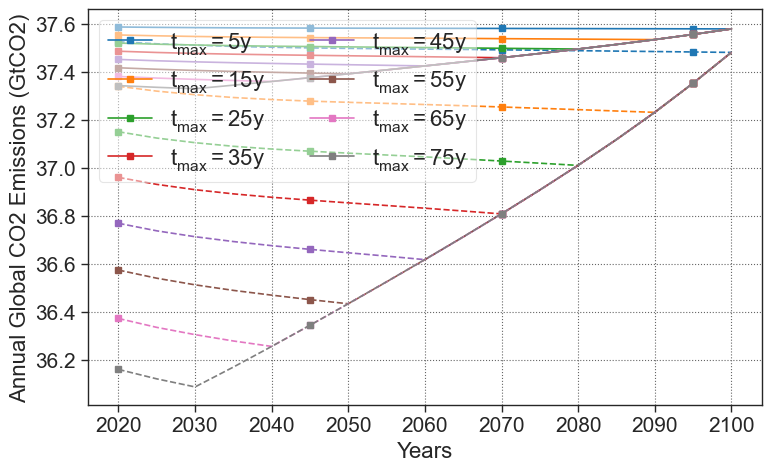

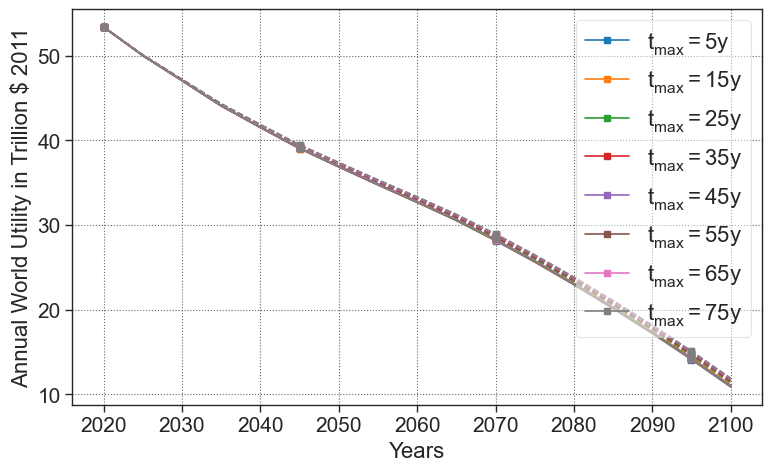

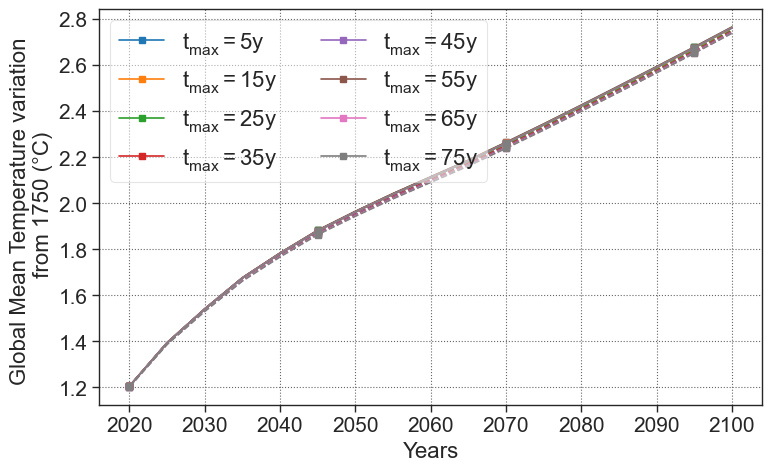

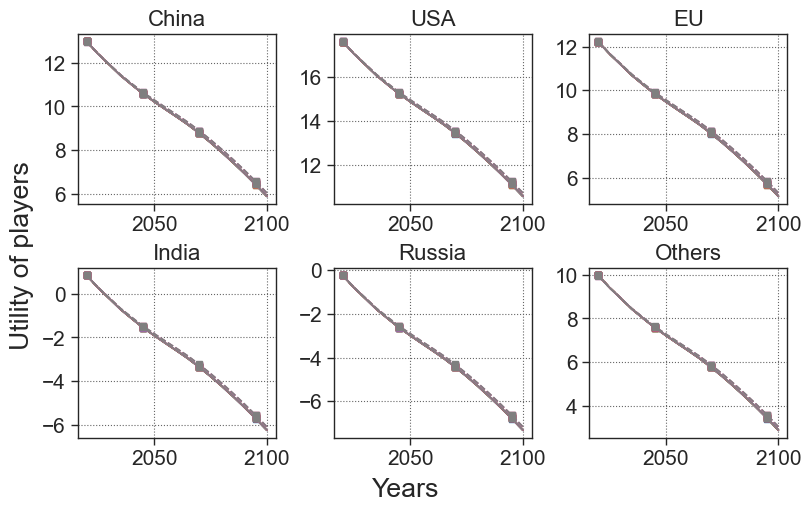

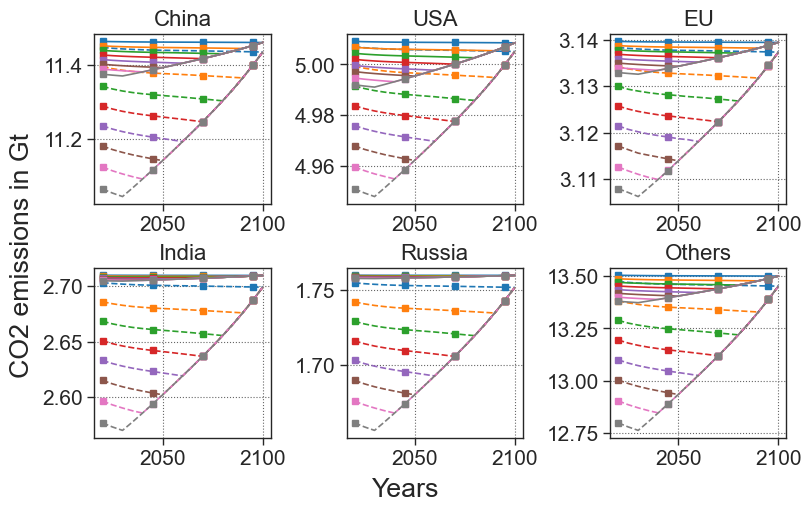

In [94]:


# damage_coef = np.flip(np.array([-0.02,0.31,0.1,1.94,-2.0]))

list_ne = []
list_so = []
list_ne_u = []
list_so_u = []
list_ne_planning_u = []
list_so_planning_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
list_ne_planning = []
list_so_planning = []

list_t_max = range(1,T,2)
for t_max in list_t_max :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, temperature_target= None)

    X = 2020 + np.arange(game.T)*5

    game.planning_BRD_by_piece(t_max=t_max)
    game.reset()


    list_ne_planning.append(game.ne_a_planning_brd_piece)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd_piece)
    list_temp_planning.append(game.ne_temp_planning_brd_piece)
    list_ne_planning_u.append(game.ne_u_planning_brd_piece)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd_piece)

    game.planning_SO_by_piece(t_max=t_max)
    game.reset()

    list_so_planning.append(game.so_a_planning_piece)
    list_sum_action_planning_so.append(game.so_sum_a_planning_piece)
    list_temp_planning_so.append(game.so_temp_planning_piece)
    list_so_planning_u.append(game.so_u_planning_piece)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning_piece)
    # 
    #  # list_so_planning.append(game.so_a_planning)
    # list_sum_action_planning_so.append(game.so_sum_a_planning)
    # list_temp_planning_so.append(game.so_temp_planning)
    # list_so_planning_u.append(game.so_u_planning)
    # list_sum_utilities_planning_so.append(game.so_sum_u_planning)



plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_sum_action_planning[idx], **planning_style, label='$t_{{max}} = {}$y'.format(list_t_max[idx]*5) )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_sum_utilities_planning[idx],**planning_style , label='$t_{{max}} = {}$y'.format(list_t_max[idx]*5) )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_temp_planning[idx],**planning_style, label='$t_{{max}} = {}$y'.format(list_t_max[idx]*5) )
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_planning_u, so_planning_u in zip(list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_planning_u[k],**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

# plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_planning_u, so_planning_u in zip(list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_planning_u[k],**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

# plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

## Concave log

In [104]:
list_benefit_functions=BENEFITS_LOG
case = 'concave_lo_receeding'

In [105]:
horizon = 2100

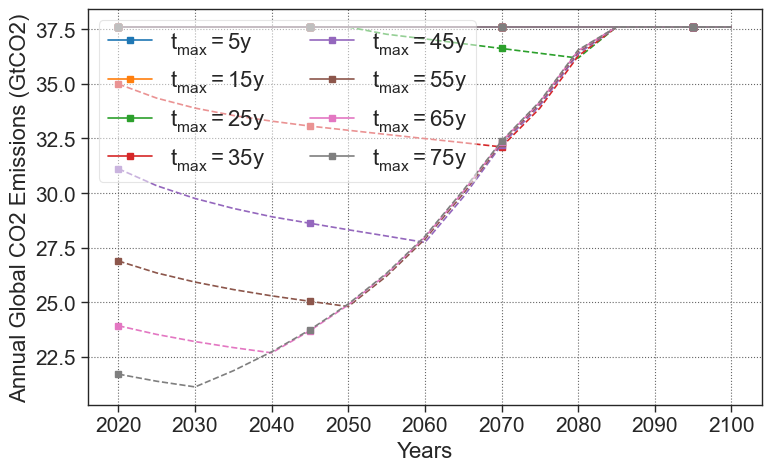

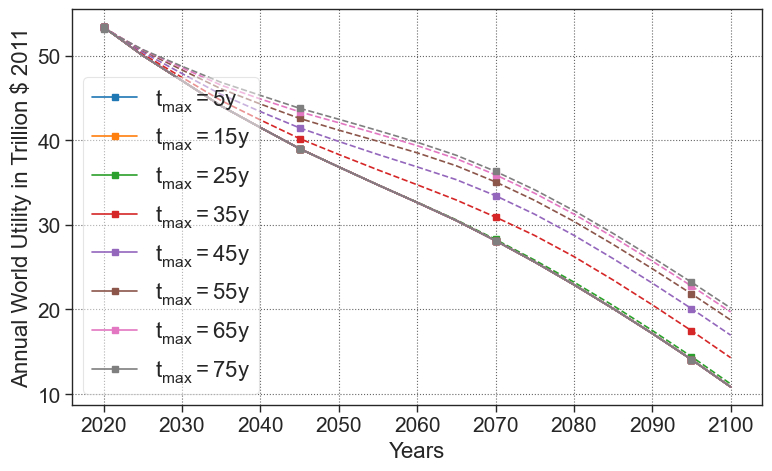

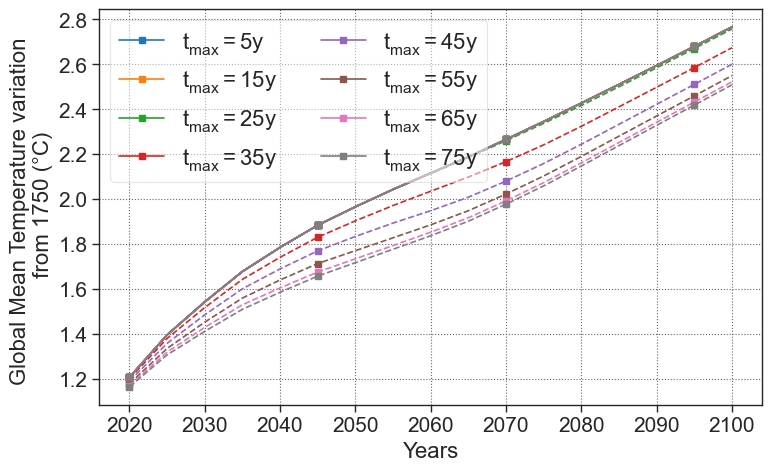

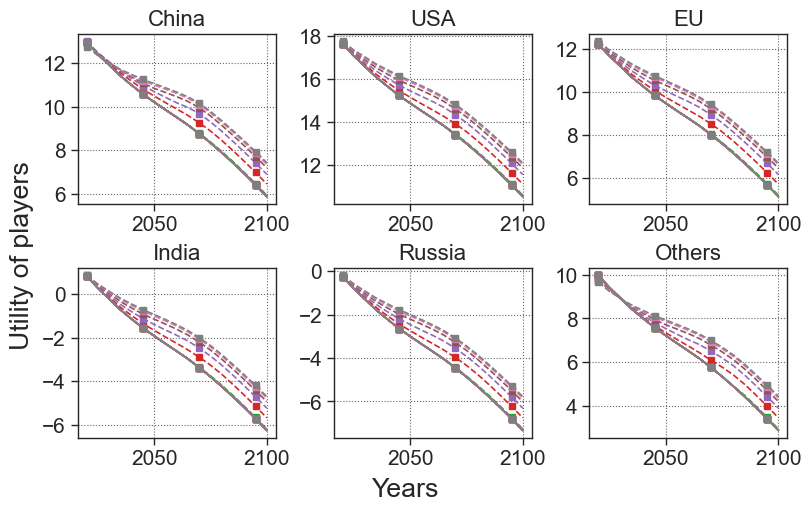

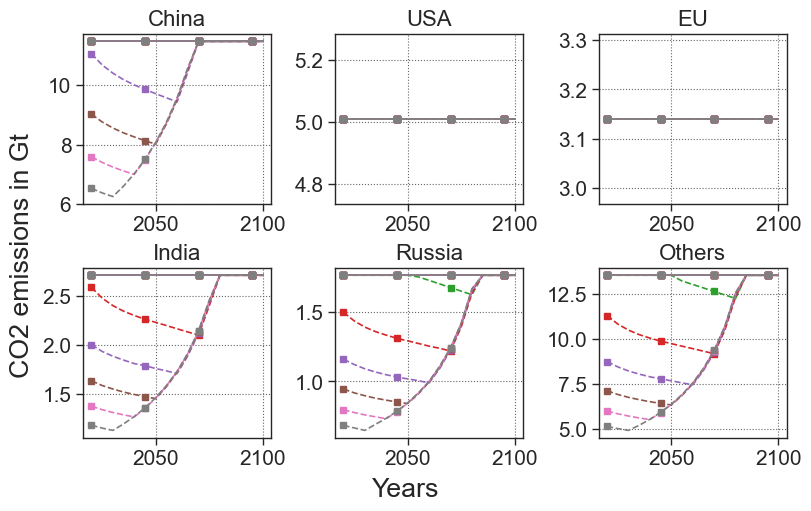

In [106]:


damage_coef = np.flip(np.array([-0.02,0.31,0.1,1.94,-2.0]))
damage_coef = np.array([0,0,1.145])


list_ne = []
list_so = []
list_ne_u = []
list_so_u = []
list_ne_planning_u = []
list_so_planning_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
list_ne_planning = []
list_so_planning = []

list_t_max = range(1,T,2)
for t_max in list_t_max :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, temperature_target= None)

    X = 2020 + np.arange(game.T)*5

    game.planning_BRD_by_piece(t_max=t_max)
    game.reset()


    list_ne_planning.append(game.ne_a_planning_brd_piece)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd_piece)
    list_temp_planning.append(game.ne_temp_planning_brd_piece)
    list_ne_planning_u.append(game.ne_u_planning_brd_piece)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd_piece)

    game.planning_SO_by_piece(t_max=t_max)
    game.reset()

    list_so_planning.append(game.so_a_planning_piece)
    list_sum_action_planning_so.append(game.so_sum_a_planning_piece)
    list_temp_planning_so.append(game.so_temp_planning_piece)
    list_so_planning_u.append(game.so_u_planning_piece)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning_piece)
    # 
    #  # list_so_planning.append(game.so_a_planning)
    # list_sum_action_planning_so.append(game.so_sum_a_planning)
    # list_temp_planning_so.append(game.so_temp_planning)
    # list_so_planning_u.append(game.so_u_planning)
    # list_sum_utilities_planning_so.append(game.so_sum_u_planning)



plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_sum_action_planning[idx], **planning_style, label='$t_{{max}} = {}$y'.format(list_t_max[idx]*5) )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_sum_utilities_planning[idx],**planning_style , label='$t_{{max}} = {}$y'.format(list_t_max[idx]*5) )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_temp_planning[idx],**planning_style, label='$t_{{max}} = {}$y'.format(list_t_max[idx]*5) )
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_planning_u, so_planning_u in zip(list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_planning_u[k],**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

# plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_planning_u, so_planning_u in zip(list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_planning_u[k],**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

# plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

## Soigmoid

In [98]:
list_benefit_functions=BENEFITS_SIGMOID
case = 'sigmoid_receeding'

In [99]:
horizon = 2100

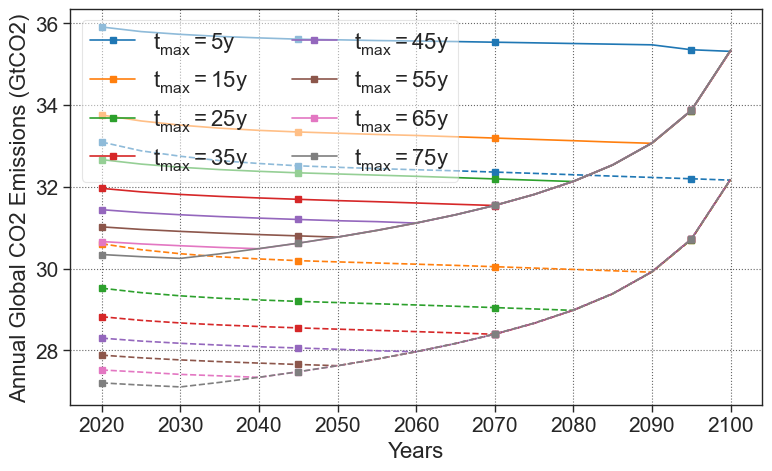

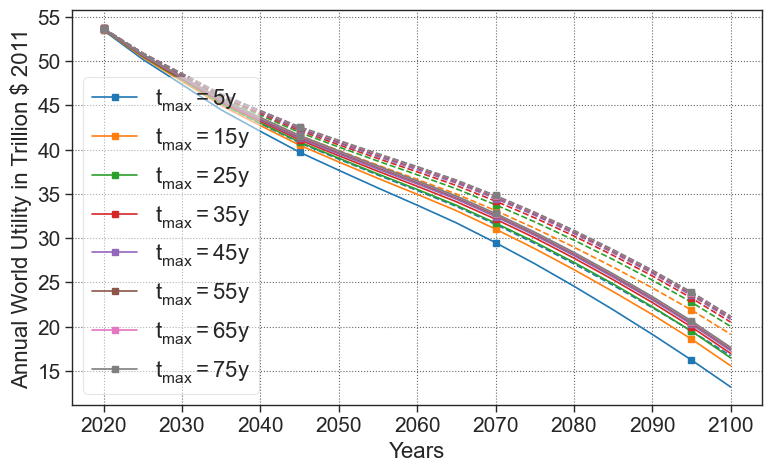

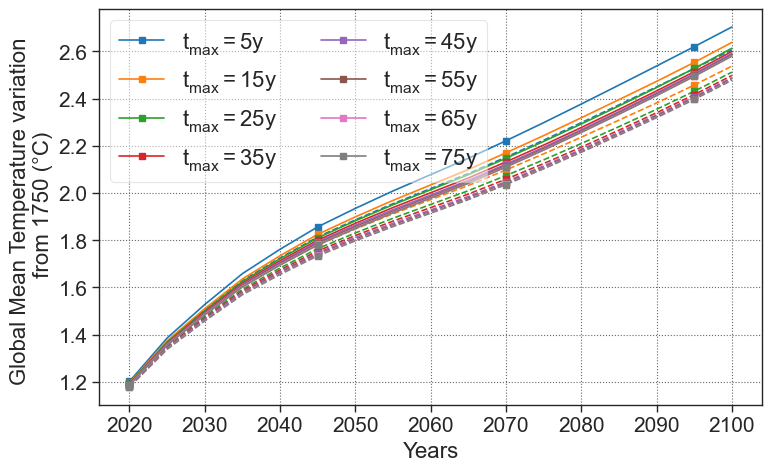

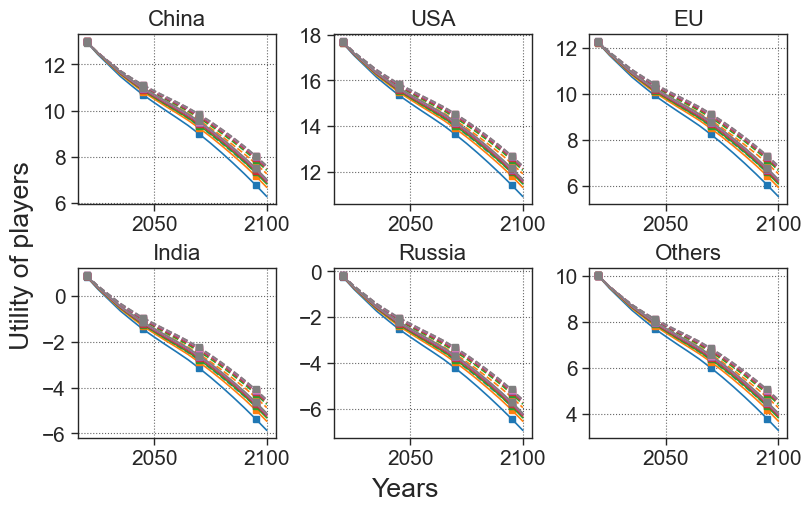

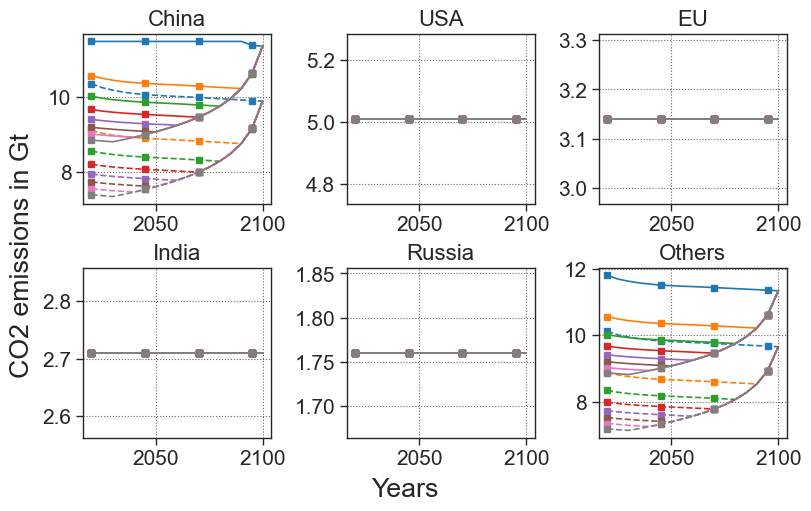

In [102]:


# damage_coef = np.flip(np.array([-0.02,0.31,0.1,1.94,-2.0]))

damage_coef = np.array([0,0,1.145])


list_ne = []
list_so = []
list_ne_u = []
list_so_u = []
list_ne_planning_u = []
list_so_planning_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
list_ne_planning = []
list_so_planning = []

list_t_max = range(1,T,2)
for t_max in list_t_max :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, temperature_target= None)

    X = 2020 + np.arange(game.T)*5

    game.planning_BRD_by_piece(t_max=t_max)
    game.reset()


    list_ne_planning.append(game.ne_a_planning_brd_piece)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd_piece)
    list_temp_planning.append(game.ne_temp_planning_brd_piece)
    list_ne_planning_u.append(game.ne_u_planning_brd_piece)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd_piece)

    game.planning_SO_by_piece(t_max=t_max)
    game.reset()

    list_so_planning.append(game.so_a_planning_piece)
    list_sum_action_planning_so.append(game.so_sum_a_planning_piece)
    list_temp_planning_so.append(game.so_temp_planning_piece)
    list_so_planning_u.append(game.so_u_planning_piece)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning_piece)
    # 
    #  # list_so_planning.append(game.so_a_planning)
    # list_sum_action_planning_so.append(game.so_sum_a_planning)
    # list_temp_planning_so.append(game.so_temp_planning)
    # list_so_planning_u.append(game.so_u_planning)
    # list_sum_utilities_planning_so.append(game.so_sum_u_planning)



plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_sum_action_planning[idx], **planning_style, label='$t_{{max}} = {}$y'.format(list_t_max[idx]*5) )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_sum_utilities_planning[idx],**planning_style , label='$t_{{max}} = {}$y'.format(list_t_max[idx]*5) )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_temp_planning[idx],**planning_style, label='$t_{{max}} = {}$y'.format(list_t_max[idx]*5) )
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_planning_u, so_planning_u in zip(list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_planning_u[k],**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

# plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_planning_u, so_planning_u in zip(list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_planning_u[k],**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

# plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

# horizon

In [1]:
import numpy as np 
from scipy.optimize import *

import matplotlib.pyplot as plt
import seaborn as sns

from parameters import *
from models.game_theory_model import *
from models.game import *
from plot_function import *

sns.set_style('ticks',  {"axes.grid" : "True", "grid.color": ".4", "grid.linestyle": ":"})
sns.set_context('paper')
plt.rcParams.update({'mathtext.default':  'regular' })
plt.rcParams['xtick.direction'] = 'out'
figsize = (8,5)

In [2]:
import pandas as pd

data = pd.read_csv('data/rcp_data.csv')
RCP_26 = data.loc[data['Scenario'] == 'RCP-2.6'].to_numpy()[0][8:] * co2_to_C**-1
RCP_85 = data.loc[data['Scenario'] == 'RCP-8.5'].to_numpy()[0][8:] * co2_to_C**-1
RCP_60 = data.loc[data['Scenario'] == 'RCP-6.0'].to_numpy()[0][8:] * co2_to_C**-1

temp_RCP26 = SCM.evaluate_trajectory(RCP_26)[-1]
temp_RCP85 = SCM.evaluate_trajectory(RCP_85)[-1]
temp_RCP60 = SCM.evaluate_trajectory(RCP_60)[-1]

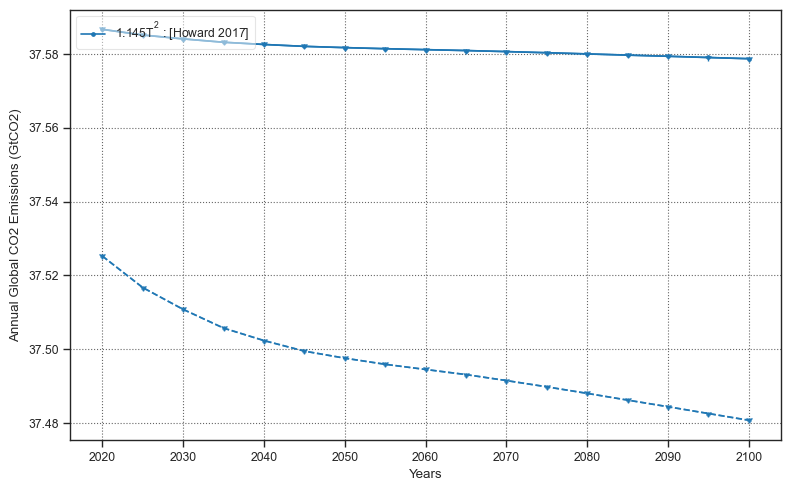

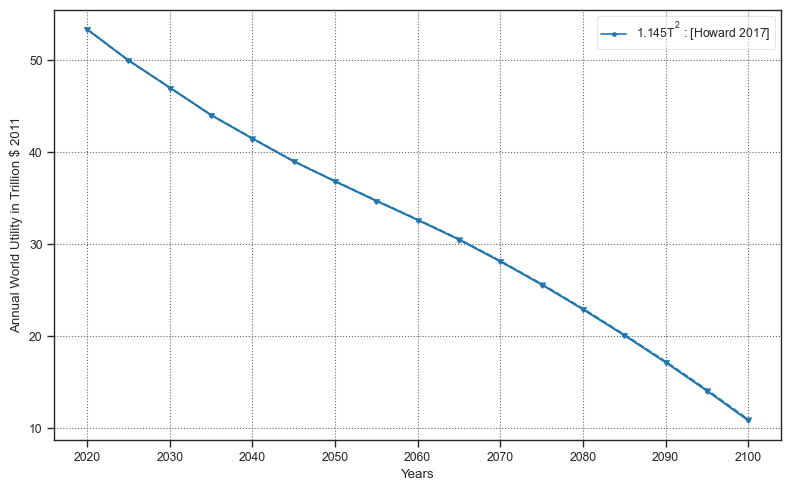

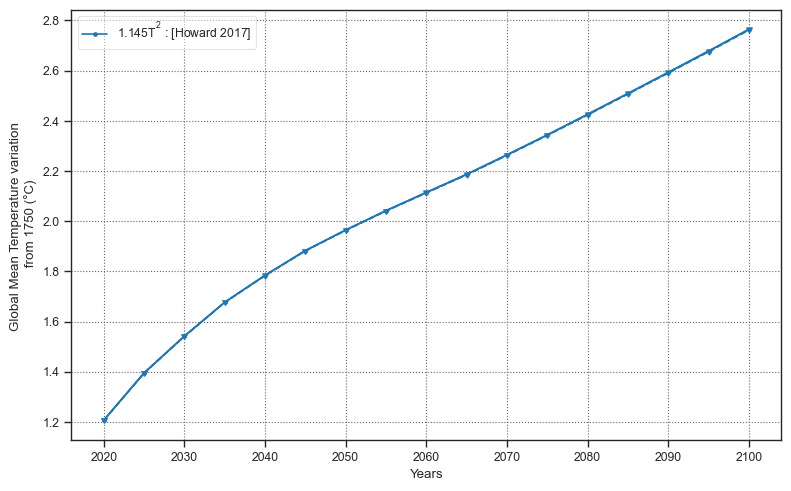

In [6]:
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, temperature_target=None)

    X = 2020 + np.arange(game.T)*5


    game.reset()
    game.planning_BRD_by_piece(t_max = 1)
    game.reset()
    # game.planning_gradient_descent()
    game.reset()

    game.planning_SO_by_piece(t_max=1)
    game.reset()

    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()

    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)

    list_sum_action_planning.append(game.ne_sum_a_planning_brd_piece)
    list_temp_planning.append(game.ne_temp_planning_brd_piece)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd_piece)

    # list_sum_action_planning.append(game.ne_sum_a_planning_gd)
    # list_temp_planning.append(game.ne_temp_planning_gd)
    # list_sum_utilities_planning.append(game.ne_sum_u_planning_gd)

    list_sum_action_planning_so.append(game.so_sum_a_planning_piece)
    list_temp_planning_so.append(game.so_temp_planning_piece)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning_piece)


plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, **one_shot_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**so_style, **planning_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="Annual_Global_CO2_Emission_{}_RCP.pdf", format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, **one_shot_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**so_style, **planning_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
# plt.savefig(fname="Annual_World_Utility_sigmoid.pdf", format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, **one_shot_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(), **planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(), **so_style, **planning_style )


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="Global_Mean_Temperature_{}_RCP.pdf", format='pdf')
plt.show()

In [7]:
np.array(list_sum_utilities_so) - np.array(list_sum_utilities_planning_so)

array([[ 0.00000000e+00,  0.00000000e+00,  7.92745766e-07,
        -5.52048306e-07, -2.36775885e-06, -3.39599890e-06,
        -2.83086524e-06, -2.75779898e-06, -3.34692427e-06,
        -2.86658366e-06, -2.65254562e-06, -1.01631067e-06,
        -8.05662342e-07, -1.28128907e-06, -1.98262120e-06,
        -2.07347694e-06,  3.38244108e-07]])

In [8]:
np.array(list_temp_so) - np.array(list_temp_planning_so)

array([[ 0.00000000e+00,  0.00000000e+00, -4.18617279e-08,
         3.20684510e-08,  1.03296889e-07,  1.34435439e-07,
         1.02077665e-07,  9.91544327e-08,  1.17740625e-07,
         9.31370128e-08,  8.51730952e-08,  2.56034483e-08,
         2.47407059e-08,  3.83754983e-08,  5.74055252e-08,
         5.60436058e-08, -1.64919083e-08]])

AttributeError: 'Game' object has no attribute 'ne_u_planning_brd'

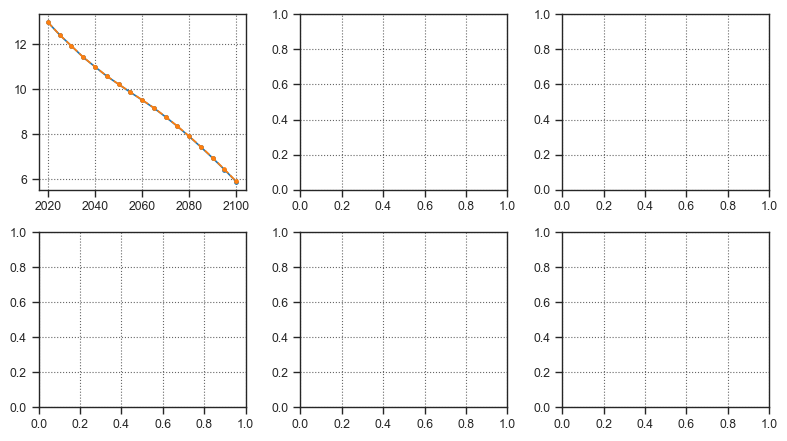

In [16]:
fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,4.5))
fig.tight_layout()
for k in range(N):

    axes[k//3, k%3].plot(X, game.ne_u_p[k], **one_shot_style)
    axes[k//3, k%3].plot(X, game.so_u_p[k], **one_shot_style, **so_style)
    axes[k//3, k%3].plot(X, game.ne_u_planning_brd[k],**planning_style)
    axes[k//3, k%3].plot(X, game.so_u_planning[k], ls = '--',**planning_style)

    axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
    # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

    if k%3==0:
        axes[k//3, k%3].set_ylabel('GDP')
    if k//3 ==1:
        axes[k//3, k%3].set_xlabel('Years')

In [ ]:
game.so_sum_u_planning

array([ -2.53358987,  -2.13918676,  -1.32959394,  -0.57619665,
         0.45370868,   1.4445447 ,   2.5728689 ,   3.62717612,
         4.62398055,   5.49367163,   6.1363977 ,   6.63136541,
         6.9776751 ,   7.20613788,   7.33325049,   7.35593727,
         7.27329112,   7.08440495,   6.65788537,   6.08193912,
         5.37520772,   4.53815866,   3.56591558,   2.45143301,
         1.18623089,  -0.23947544,  -0.74411515,  -0.83794192,
        -1.37725108,  -2.39433464,  -3.24306532,  -2.50165355,
        -3.00967283,  -5.07719132,  -8.89721091, -14.71957834,
       -22.88229054])

In [ ]:
game.ne_sum_u_planning_brd

array([  34.59700139,   33.34156926,   32.28621555,   30.98556321,
         29.92743127,   28.77684709,   27.71329815,   26.4815541 ,
         25.11336879,   23.51011647,   21.50689366,   19.20684367,
         16.59594413,   13.71290321,   10.57647692,    7.17267858,
          3.49085504,   -0.48066132,   -4.99304292,   -9.9055197 ,
        -15.19707906,  -20.87905717,  -26.97275215,  -33.50439915,
        -40.50351936,  -48.00289915,  -56.03865367,  -64.65052605,
        -73.88229919,  -83.78212757,  -94.40286643, -105.8026613 ,
       -118.04548868, -131.20201642, -145.35077383, -160.57988358,
       -176.98693995])

In [ ]:
sum_ = []
for idx,player in enumerate(game.list_players):
    sum_.append(player.utility_sum_over_t(game.ne_a_planning_brd[idx], game.ne_sum_a_planning_brd - game.ne_a_planning_brd[idx]))
print(sum_)
print(sum(sum_))

[-13122.676774793592, -13113.90616360864, -11751.018707141466, -7893.939150479122, -16009.420277546127, -13279.994430321967]
-75170.95550389092


In [ ]:
sum_ = []
for idx,player in enumerate(game.list_players):
    sum_.append(player.utility_sum_over_t(game.so_a_planning[idx], game.so_sum_a_planning - game.so_a_planning[idx]))
print(sum_)
print(sum(sum_))

[-12202.060615531149, -12004.781381205506, -10695.283096622785, -7204.99610051566, -14502.087794048313, -12253.314353941125]
-68862.52334186454


In [ ]:
game.list_players[0].damage_function(temp=game.so_temp_planning)

array([ 1.53940604,  2.10979526,  2.53840388,  2.98811743,  3.27396466,
        3.53790774,  3.67627264,  3.8018545 ,  3.90747164,  4.03691184,
        4.28833762,  4.63533436,  5.09764174,  5.7382012 ,  6.6763471 ,
        8.0420846 , 10.02080222])

In [ ]:
game.list_players[0].damage_function(temp=None, sum_action=game.so_sum_a_planning)

AttributeError: 'NoneType' object has no attribute 'five_years_atmospheric_temp'

In [ ]:
import numpy as np 
from scipy.optimize import *

import matplotlib.pyplot as plt
import seaborn as sns

from parameters import *
from models.game_theory_model import *
from models.game import *
from plot_function import *

sns.set_style('ticks',  {"axes.grid" : "True", "grid.color": ".4", "grid.linestyle": ":"})
sns.set_context('paper')
plt.rcParams.update({'mathtext.default':  'regular' })
plt.rcParams['xtick.direction'] = 'out'
plt.rcParams['ytick.labelsize']  =15
plt.rcParams['xtick.labelsize']  =13
plt.rcParams['legend.fontsize']  = 16
plt.rcParams['axes.labelsize' ] = 16
plt.rcParams['font.size'] = '16'
plt.rcParams['axes.titlesize'] = '16'

figsize = (8,5)

True
True
True


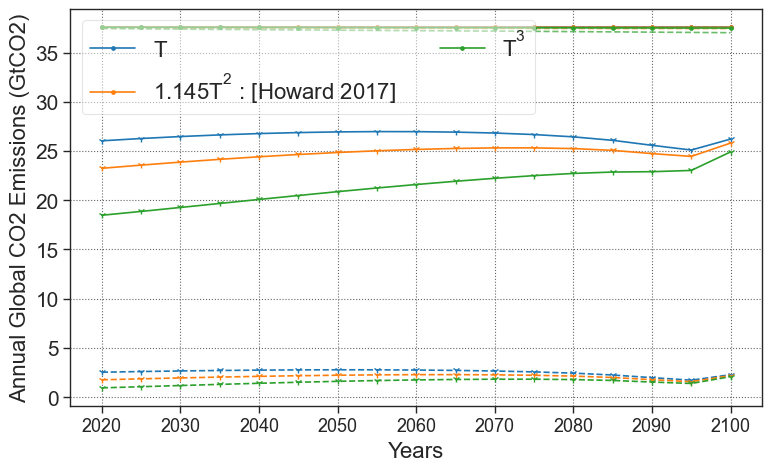

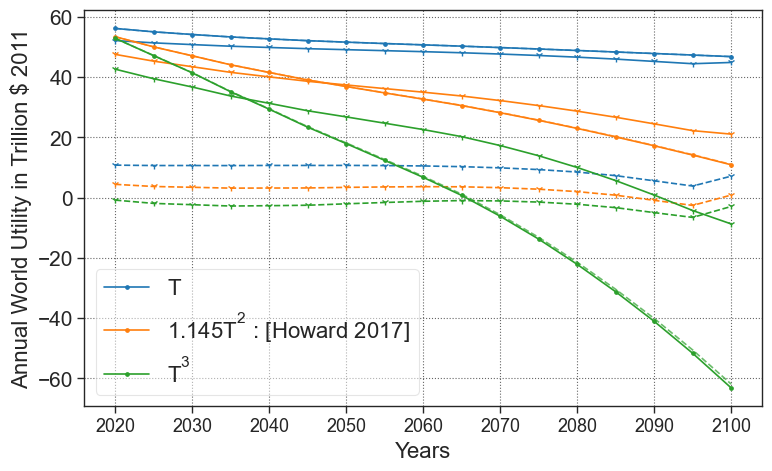

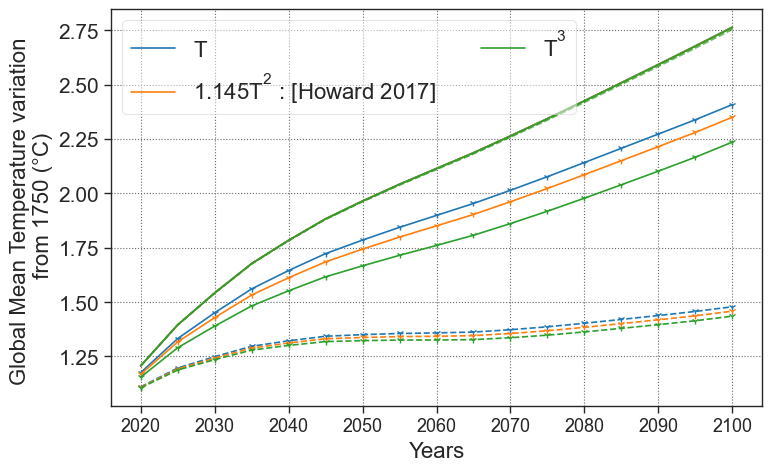

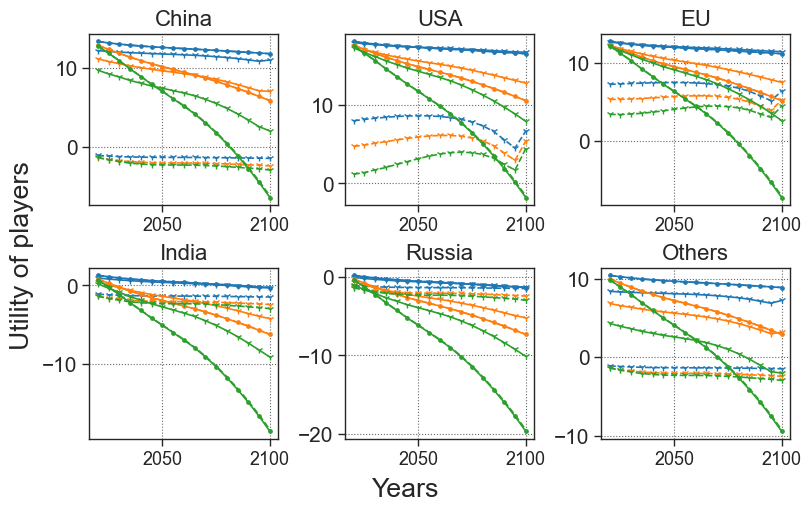

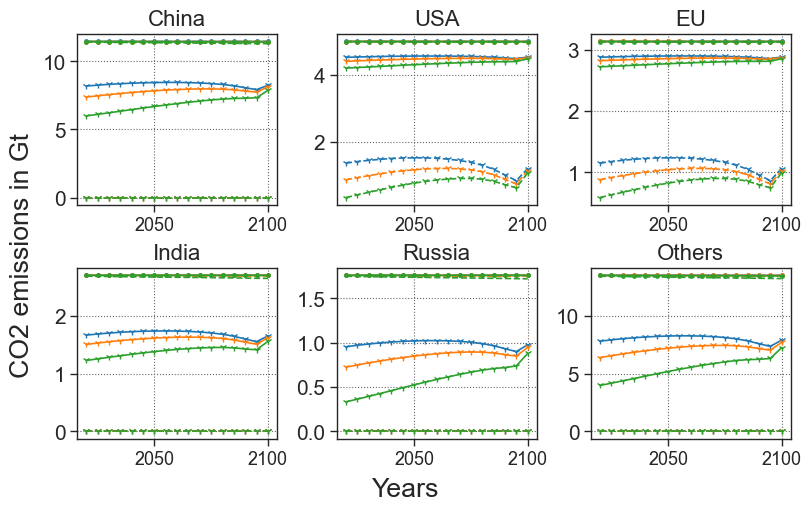

In [ ]:
# puissance de la fonction damage 

# Coefficients de la fonction dammage (pour un polynome de degré 2)

list_damage_coef = [ np.array([0,1]), np.array([0,0,1.1450]), np.array([0,0,0,1])] #, np.array([0,0,0,0,1])]
list_damage_label = [ '$T$', '$1.145T^2$ : [Howard 2017]', '$T^3$'] #,  '$T^4$']

list_ne = []
list_so = []
list_ne_u = []
list_so_u = []
list_ne_planning_u = []
list_so_planning_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
list_ne_planning = []
list_so_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players)

    X = 2020 + np.arange(game.T)*5
    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    game.reset()
    
    game.planning_BRD()
    game.planning_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_ne_planning_u.append(game.ne_u_planning_brd)
    
    list_so.append(game.so_a_p)

    list_so_u.append(game.so_u_p)
    list_so_planning_u.append(game.so_u_planning)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)

    list_ne_planning.append(game.ne_a_planning_brd)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd)
    list_temp_planning.append(game.ne_temp_planning_brd)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd)

    list_so_planning.append(game.so_a_planning)

    list_sum_action_planning_so.append(game.so_sum_a_planning)
    list_temp_planning_so.append(game.so_temp_planning)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning)

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne_u, list_so_u, list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

# plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne, list_so, list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

# plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

In [1]:
import numpy as np 
from scipy.optimize import *

import matplotlib.pyplot as plt
import seaborn as sns

from parameters import *
from models.game_theory_model import *
from models.game import *
from plot_function import *

sns.set_style('ticks',  {"axes.grid" : "True", "grid.color": ".4", "grid.linestyle": ":"})
sns.set_context('paper')
plt.rcParams.update({'mathtext.default':  'regular' })
plt.rcParams['xtick.direction'] = 'out'
plt.rcParams['ytick.labelsize']  =15
plt.rcParams['xtick.labelsize']  =13
plt.rcParams['legend.fontsize']  = 16
plt.rcParams['axes.labelsize' ] = 16
plt.rcParams['font.size'] = '16'
plt.rcParams['axes.titlesize'] = '16'

figsize = (8,5)

NameError: name 'planning_style' is not defined

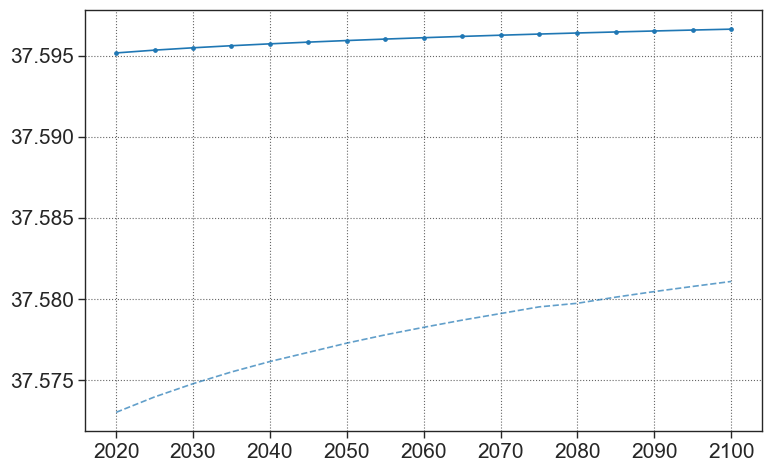

In [44]:
# puissance de la fonction damage 

# Coefficients de la fonction dammage (pour un polynome de degré 2)

list_damage_coef = [ np.array([0,1]), np.array([0,0,1.1450]), np.array([0,0,0,1])] #, np.array([0,0,0,0,1])]
list_damage_label = [ '$T$', '$1.145T^2$ : [Howard 2017]', '$T^3$'] #,  '$T^4$']

list_ne = []
list_so = []
list_ne_u = []
list_so_u = []
list_ne_planning_u = []
list_so_planning_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
list_ne_planning = []
list_so_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, temperature_target= None)

    X = 2020 + np.arange(game.T)*5
    game.repeated_one_shot_game_NE()
    game.reset()

    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)

    game.repeated_one_shot_game_SO()
    game.reset()
    
    game.planning_BRD_by_piece(t_max=5)
    game.reset()

    
    list_so.append(game.so_a_p)
    list_so_u.append(game.so_u_p)
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)

    list_ne_planning.append(game.ne_a_planning_brd_piece)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd_piece)
    list_temp_planning.append(game.ne_temp_planning_brd_piece)
    list_ne_planning_u.append(game.ne_u_planning_brd_piece)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd_piece)

    game.planning_SO_by_piece(t_max=5)


    list_so_planning.append(game.so_a_planning_piece)
    list_sum_action_planning_so.append(game.so_sum_a_planning_piece)
    list_temp_planning_so.append(game.so_temp_planning_piece)
    list_so_planning_u.append(game.so_u_planning_piece)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning_piece)
    # 
    #  # list_so_planning.append(game.so_a_planning)
    # list_sum_action_planning_so.append(game.so_sum_a_planning)
    # list_temp_planning_so.append(game.so_temp_planning)
    # list_so_planning_u.append(game.so_u_planning)
    # list_sum_utilities_planning_so.append(game.so_sum_u_planning)

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne_u, list_so_u, list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

# plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne, list_so, list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

# plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

In [22]:
game.ne_temp_planning_brd_piece

array([1.20100167, 1.38358726, 1.52428095, 1.65329991, 1.75454546,
       1.84728883, 1.92324069, 1.99452429, 2.06102553, 2.12706929,
       2.19847113, 2.27165106, 2.34704876, 2.42345561, 2.50035177,
       2.57812546, 2.65700906])

In [23]:
game.ne_temp_p[-1]/game.ne_temp_planning_brd_piece[-1]

1.0398767964665026

In [24]:
game.ne_sum_u_p[-1]/game.ne_sum_u_planning_brd_piece[-1]

1.2639597892395544

In [25]:
game.ne_sum_u_planning_brd_piece[-1]/game.so_sum_u_planning_piece[-1]

2.930206434165183

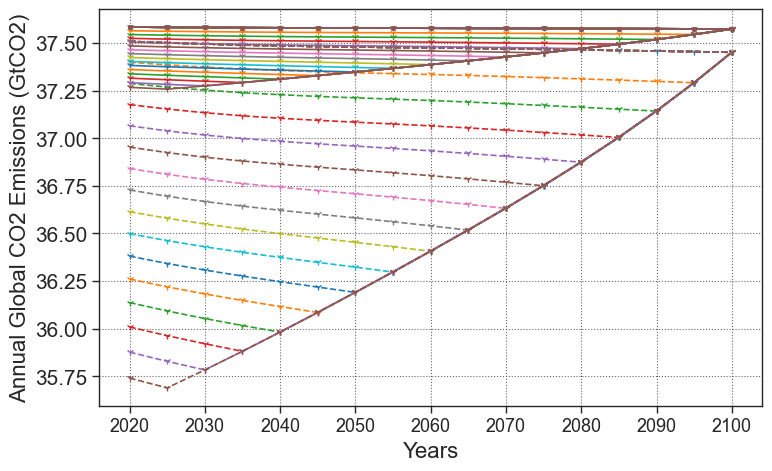

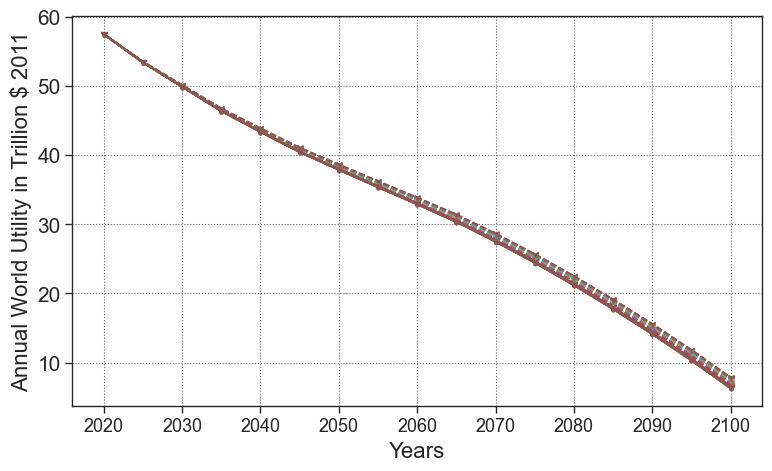

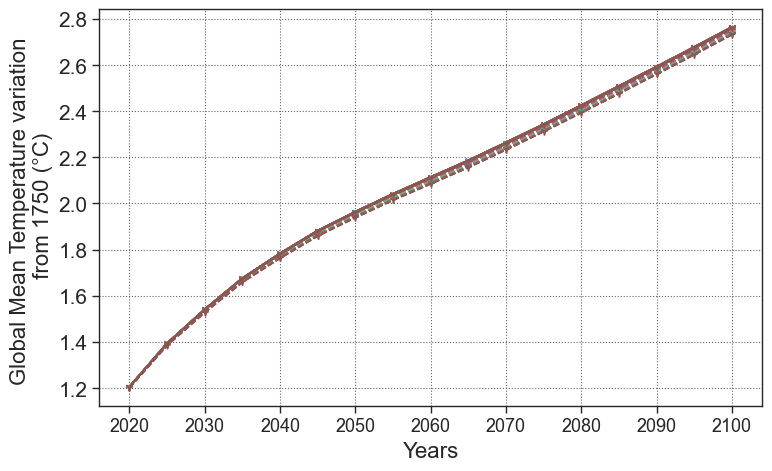

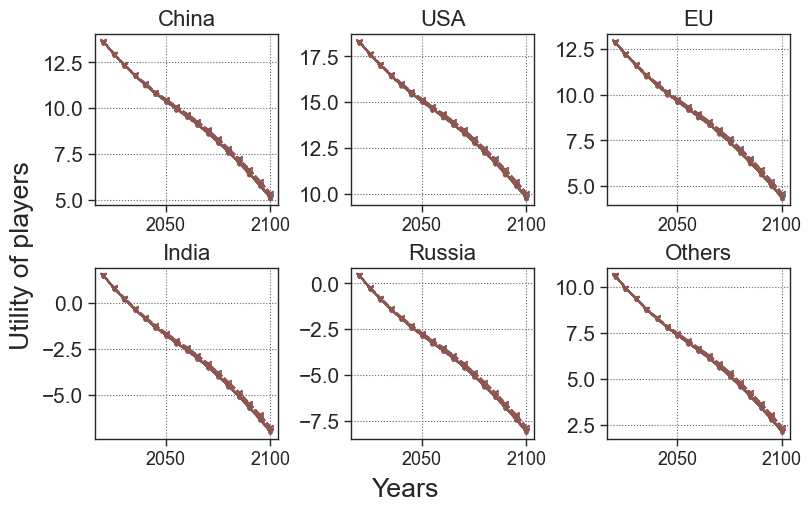

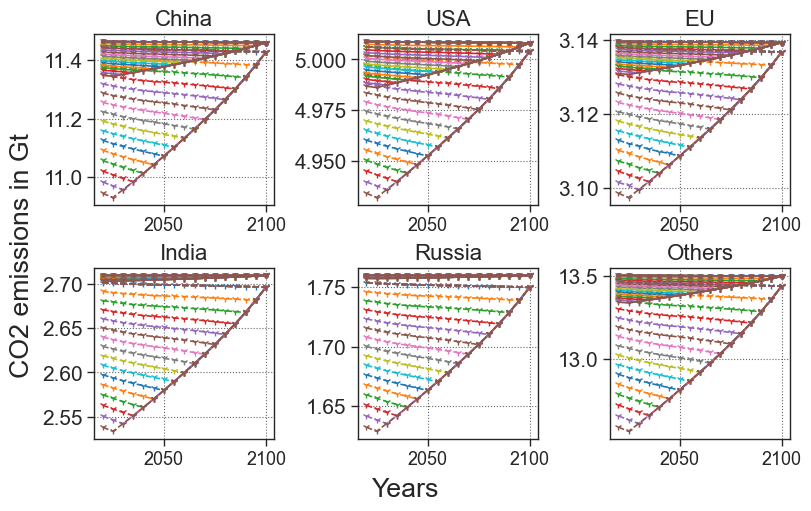

In [4]:
# puissance de la fonction damage 

# Coefficients de la fonction dammage (pour un polynome de degré 2)

list_damage_coef = [ np.array([0,1]), np.array([0,0,1.1450]), np.array([0,0,0,1])] #, np.array([0,0,0,0,1])]
list_damage_label = [ '$T$', '$1.145T^2$ : [Howard 2017]', '$T^3$'] #,  '$T^4$']

damage_coef = np.flip(np.array([-0.02,0.31,0.1,1.94,-2.0]))

list_ne = []
list_so = []
list_ne_u = []
list_so_u = []
list_ne_planning_u = []
list_so_planning_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
list_ne_planning = []
list_so_planning = []
for t_max in range(1,T) :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, temperature_target= None)

    X = 2020 + np.arange(game.T)*5
    game.repeated_one_shot_game_NE()
    game.reset()

    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)

    game.repeated_one_shot_game_SO()
    game.reset()
    
    game.planning_BRD_by_piece(t_max=t_max)
    game.reset()

    
    list_so.append(game.so_a_p)
    list_so_u.append(game.so_u_p)
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)

    list_ne_planning.append(game.ne_a_planning_brd_piece)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd_piece)
    list_temp_planning.append(game.ne_temp_planning_brd_piece)
    list_ne_planning_u.append(game.ne_u_planning_brd_piece)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd_piece)

    game.planning_SO_by_piece(t_max=t_max)


    list_so_planning.append(game.so_a_planning_piece)
    list_sum_action_planning_so.append(game.so_sum_a_planning_piece)
    list_temp_planning_so.append(game.so_temp_planning_piece)
    list_so_planning_u.append(game.so_u_planning_piece)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning_piece)
    # 
    #  # list_so_planning.append(game.so_a_planning)
    # list_sum_action_planning_so.append(game.so_sum_a_planning)
    # list_temp_planning_so.append(game.so_temp_planning)
    # list_so_planning_u.append(game.so_u_planning)
    # list_sum_utilities_planning_so.append(game.so_sum_u_planning)

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[0], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
# plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_sum_utilities[idx], label=idx, **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
# plt.legend(fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_temp[idx], label=idx)
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
# plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne_u, list_so_u, list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

# plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne, list_so, list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

# plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

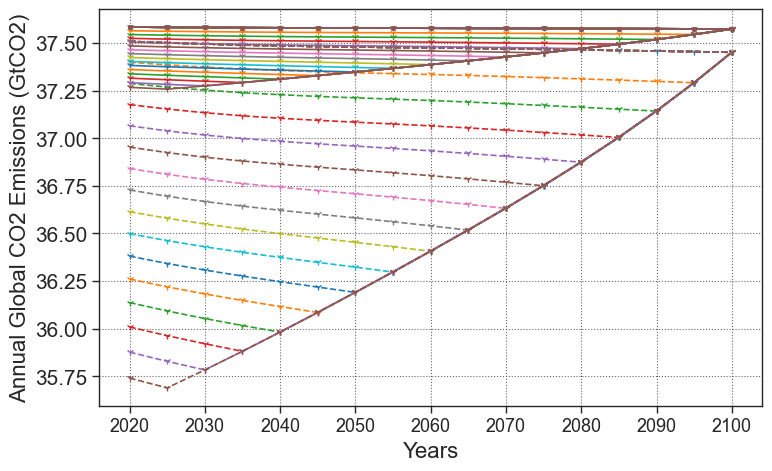

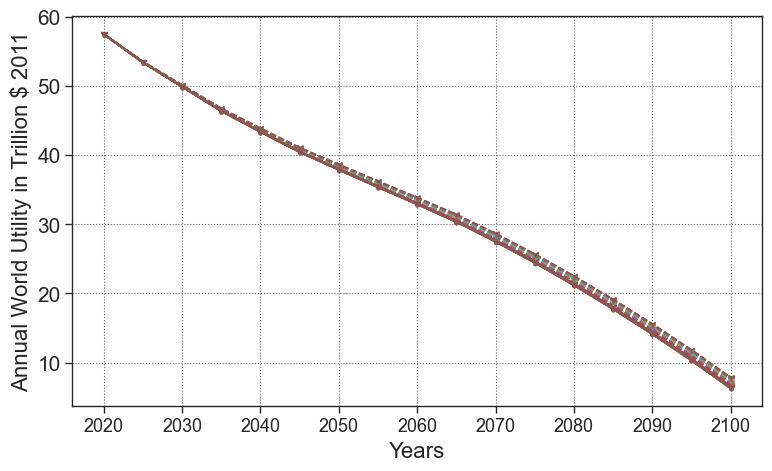

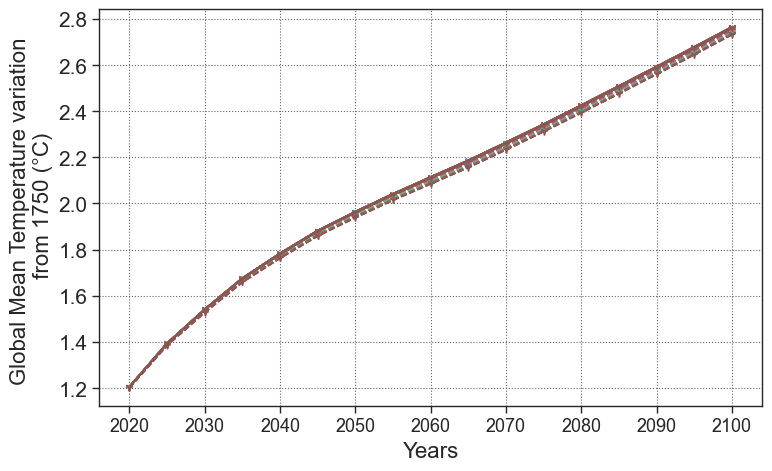

In [3]:
plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[0], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
# plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_sum_utilities[idx], label=idx, **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
# plt.legend(fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_temp[idx], label=idx)
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
# plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


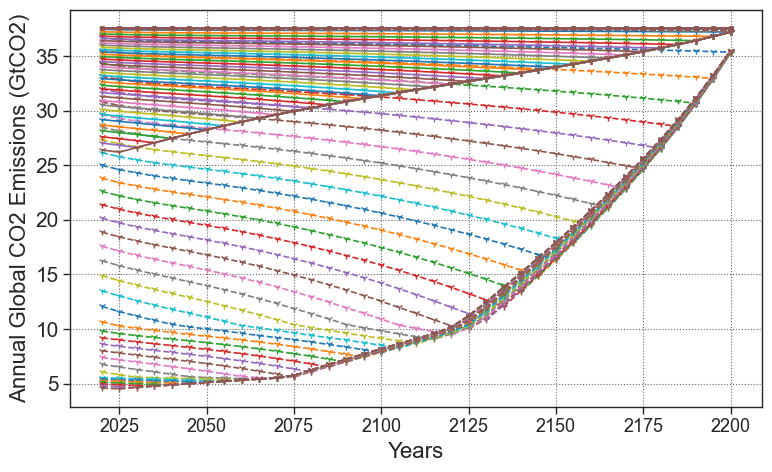

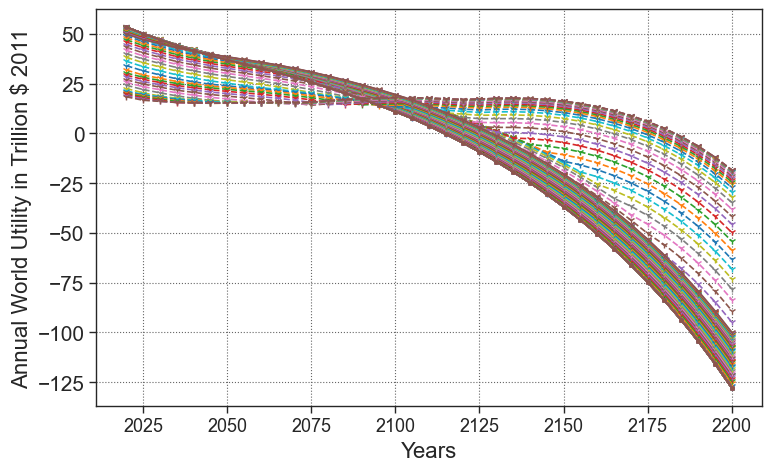

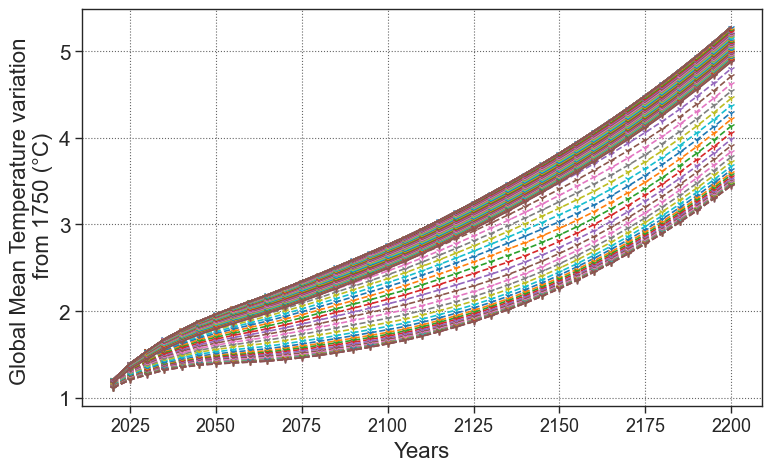

In [ ]:
plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[0], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
# plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_sum_utilities[idx], label=idx, **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
# plt.legend(fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_temp[idx], label=idx)
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
# plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


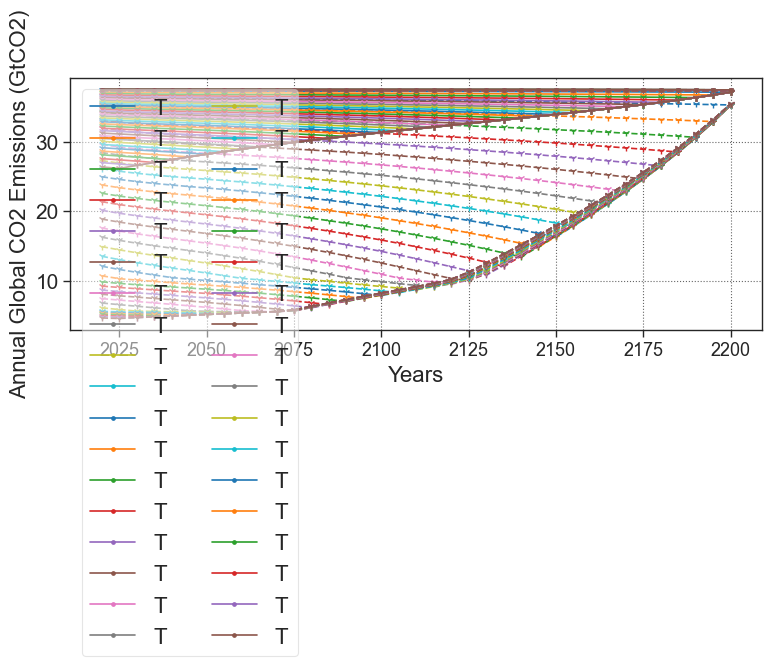

c:\ProgramData\Anaconda3\envs\CO2\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  fig.canvas.print_figure(bytes_io, **kw)


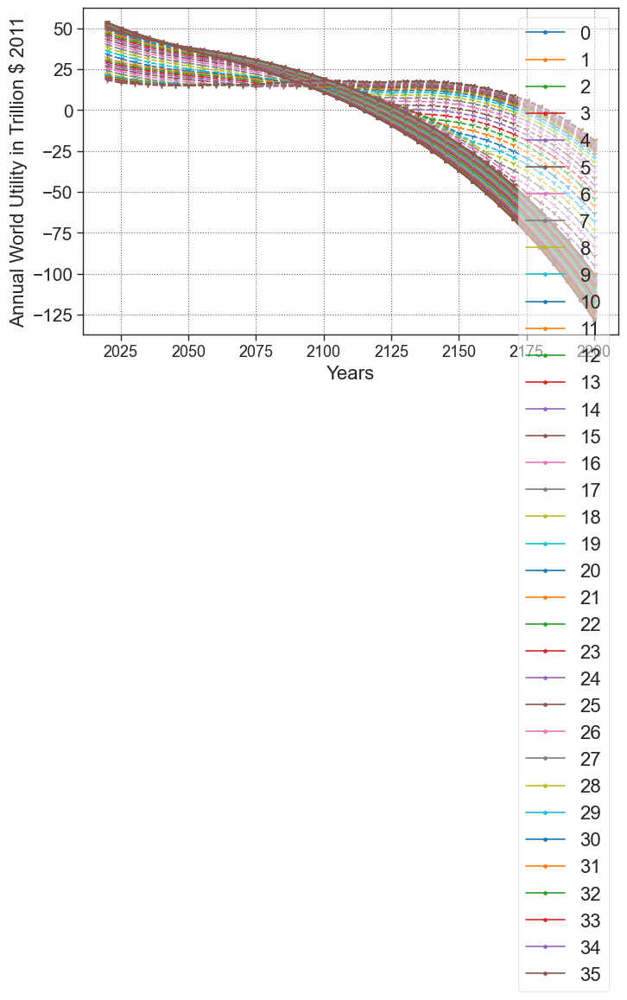

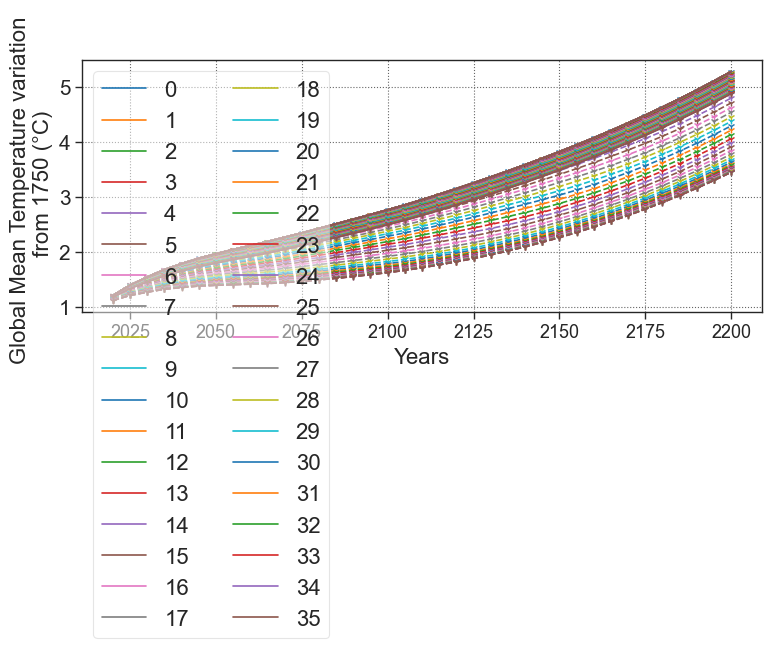

In [14]:
plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[0], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_sum_utilities[idx], label=idx, **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_temp[idx], label=idx)
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


In [35]:
1/sum(list_sum_utilities_planning_so[0]) / (1/sum(list_sum_utilities_planning[0]))

1.2124529434729907

In [40]:
[(list_temp_planning_so[i][-1]/list_temp_planning[i][-1])**-1  for i in range(37-1)]

[1.0149941525788293,
 1.0321629646177426,
 1.049468966476457,
 1.0667080410525713,
 1.0839623393431805,
 1.101385311097751,
 1.1190788329066814,
 1.137073023333798,
 1.1554433255084327,
 1.1742031572095077,
 1.193391565390549,
 1.2130203302507072,
 1.2330928850682341,
 1.253608092380453,
 1.2744685503252777,
 1.2952856797641619,
 1.3153535216226075,
 1.3342299048202817,
 1.351511537216412,
 1.3667722764290422,
 1.3793151444453011,
 1.3886543700499996,
 1.395273720664883,
 1.4010271737653122,
 1.4065070910555746,
 1.4117866673061055,
 1.4163192081839329,
 1.4195106849898125,
 1.4209327354150356,
 1.4203091999523987,
 1.4190625030671264,
 1.417909216338075,
 1.4168442638583658,
 1.4159365039999536,
 1.4151972869322436,
 1.4146544835301338]

In [37]:
sum(list_sum_utilities_planning_so[-1])

467.6822684616374

In [29]:
[np.sum(list_sum_utilities_planning_so[i])/np.sum(list_sum_utilities_planning[i]) for i in range(37-1)]

[0.8247742771241627,
 0.6318469439485457,
 0.4443775431152338,
 0.26350037390151565,
 0.08742150453997796,
 -0.08617975325797271,
 -0.25892721389473367,
 -0.4320796765648348,
 -0.6070063825354903,
 -0.784873915178665,
 -0.9670676777431794,
 -1.1550445878852573,
 -1.3504952239187789,
 -1.5552514485607531,
 -1.7718623158986706,
 -2.003727693132926,
 -2.255717700908122,
 -2.53127163984665,
 -2.8339195785146813,
 -3.166935892131587,
 -3.53306126234922,
 -3.935291378392517,
 -4.386602864294612,
 -4.921346039089715,
 -5.5732535926388245,
 -6.385182554008244,
 -7.424544401866694,
 -8.793979826584453,
 -10.65773662318855,
 -13.278459288727591,
 -17.214814336095515,
 -23.51179007784001,
 -34.81886788125724,
 -58.65392332904165,
 -129.6391987355273,
 -917.2544857661204]

In [22]:
PoA = [ sum(list_sum_utilities_planning_so[i])/sum(list_sum_utilities_planning[i]) for i in range(37-1)]

In [23]:
sum(list_sum_utilities_planning_so[-1]) / sum(list_sum_utilities_planning[-1])

-917.2544857665295

In [24]:
PoA

[0.8247742771241634,
 0.6318469439485453,
 0.4443775431152346,
 0.2635003739015152,
 0.08742150453997813,
 -0.08617975325797225,
 -0.2589272138947332,
 -0.4320796765648346,
 -0.6070063825354903,
 -0.7848739151786652,
 -0.9670676777431803,
 -1.1550445878852562,
 -1.3504952239187782,
 -1.5552514485607536,
 -1.7718623158986713,
 -2.0037276931329275,
 -2.2557177009081237,
 -2.5312716398466484,
 -2.8339195785146782,
 -3.166935892131587,
 -3.53306126234922,
 -3.9352913783925123,
 -4.386602864294607,
 -4.921346039089715,
 -5.5732535926388245,
 -6.385182554008236,
 -7.4245444018666955,
 -8.793979826584474,
 -10.657736623188535,
 -13.278459288727506,
 -17.214814336095664,
 -23.511790077840548,
 -34.818867881257525,
 -58.653923329040815,
 -129.6391987355293,
 -917.2544857665295]

In [7]:
import matplotlib.pyplot as plt
import numpy as np
import ipywidgets
from ipywidgets import interactive

x = np.linspace(0, 8,200)

def damage(x, coef0, coef1, coef2, coef3, coef4):
    return np.polyval(np.array([coef0, coef1, coef2, coef3, coef4]),x)


def plot_fct(coef0=-0.02, coef1=0.31, coef2=0.10, coef3=1.94, coef4=2.76):
#     print((eta* c1 -g1)/g2 -temp_fct(x.reshape((1,200)),y0=[[y_at],[0.0068]], z0 = z0))
    plt.figure(dpi=90)

    plt.plot(x,np.polyval(np.array([coef0, coef1, coef2, coef3, coef4]),x))
    plt.ylim(-5, 100)
    plt.xlabel("Temperature")
    plt.ylabel("Damage of the temperature")
    print('[{},{},{},{},{}]'.format(coef0, coef1, coef2, coef3, coef4))

    

In [8]:
interactive_plot = interactive(plot_fct,  coef0=(-2,10,.01), coef1=(-2,10,.01), coef2=(-2,10,.01), coef3=(-2,10,.01), coef4=(-2,10,.01))
output = interactive_plot.children[-1]
output.layout.height = '350px'
interactive_plot

interactive(children=(FloatSlider(value=-0.02, description='coef0', max=10.0, min=-2.0, step=0.01), FloatSlide…

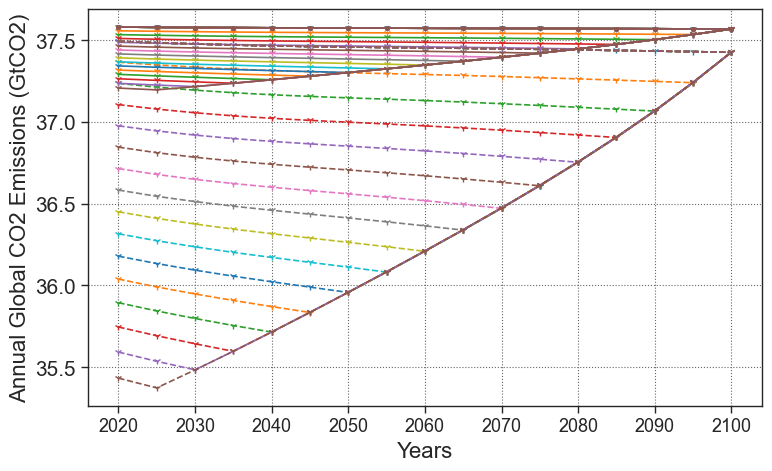

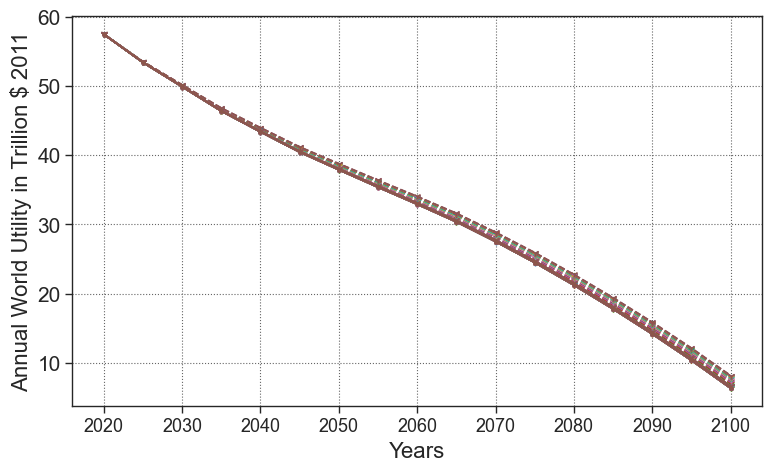

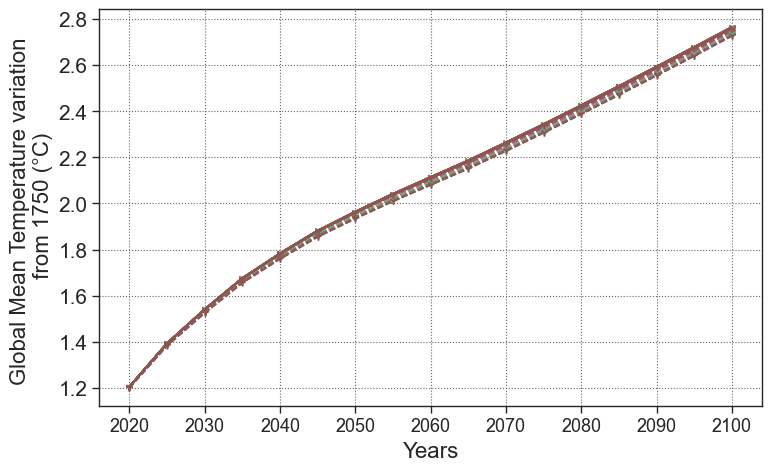

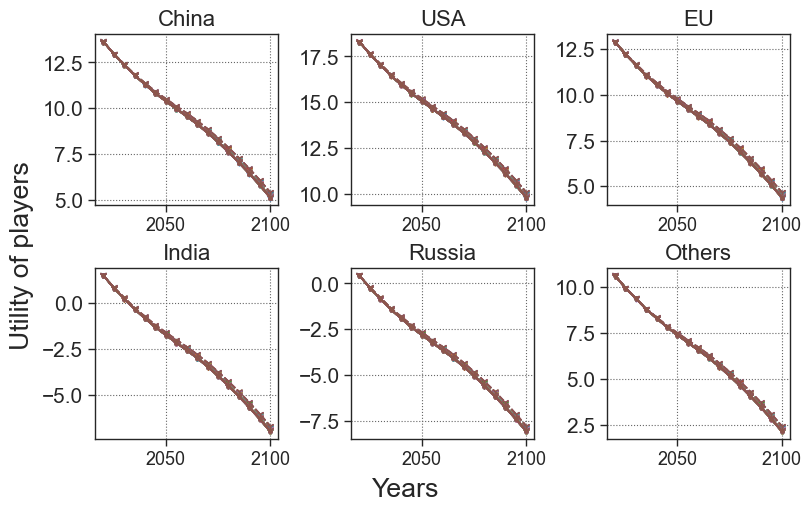

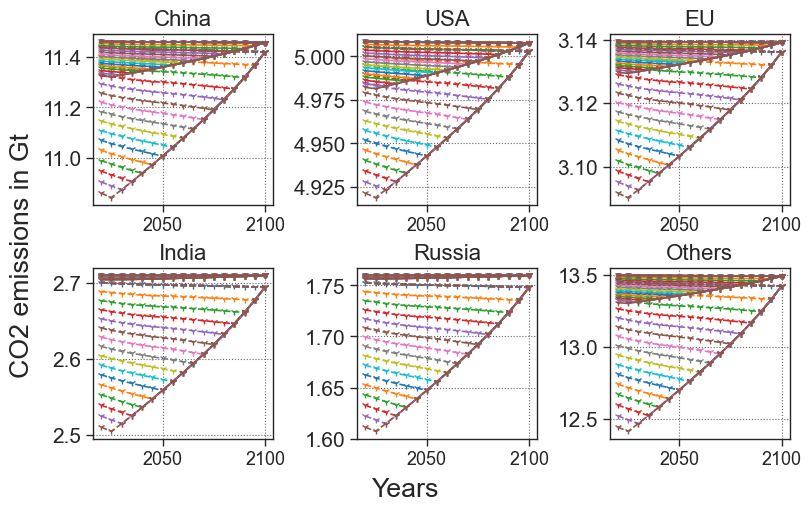

In [25]:
# puissance de la fonction damage 

# Coefficients de la fonction dammage (pour un polynome de degré 2)

list_damage_coef = [ np.array([0,1]), np.array([0,0,1.1450]), np.array([0,0,0,1])] #, np.array([0,0,0,0,1])]
list_damage_label = [ '$T$', '$1.145T^2$ : [Howard 2017]', '$T^3$'] #,  '$T^4$']

damage_coef = np.flip(np.array([-0.02,0.31,0.1,1.94,-2.0]))

list_ne = []
list_so = []
list_ne_u = []
list_so_u = []
list_ne_planning_u = []
list_so_planning_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
list_ne_planning = []
list_so_planning = []
for t_max in range(1,T) :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, temperature_target= None)

    X = 2020 + np.arange(game.T)*5
    game.repeated_one_shot_game_NE()
    game.reset()

    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)

    game.repeated_one_shot_game_SO()
    game.reset()
    
    game.planning_BRD_by_piece(t_max=t_max)
    game.reset()

    
    list_so.append(game.so_a_p)
    list_so_u.append(game.so_u_p)
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)

    list_ne_planning.append(game.ne_a_planning_brd_piece)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd_piece)
    list_temp_planning.append(game.ne_temp_planning_brd_piece)
    list_ne_planning_u.append(game.ne_u_planning_brd_piece)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd_piece)

    game.planning_SO_by_piece(t_max=t_max)


    list_so_planning.append(game.so_a_planning_piece)
    list_sum_action_planning_so.append(game.so_sum_a_planning_piece)
    list_temp_planning_so.append(game.so_temp_planning_piece)
    list_so_planning_u.append(game.so_u_planning_piece)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning_piece)
    # 
    #  # list_so_planning.append(game.so_a_planning)
    # list_sum_action_planning_so.append(game.so_sum_a_planning)
    # list_temp_planning_so.append(game.so_temp_planning)
    # list_so_planning_u.append(game.so_u_planning)
    # list_sum_utilities_planning_so.append(game.so_sum_u_planning)

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[0], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
# plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_sum_utilities[idx], label=idx, **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
# plt.legend(fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_temp[idx], label=idx)
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
# plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne_u, list_so_u, list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

# plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne, list_so, list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

# plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

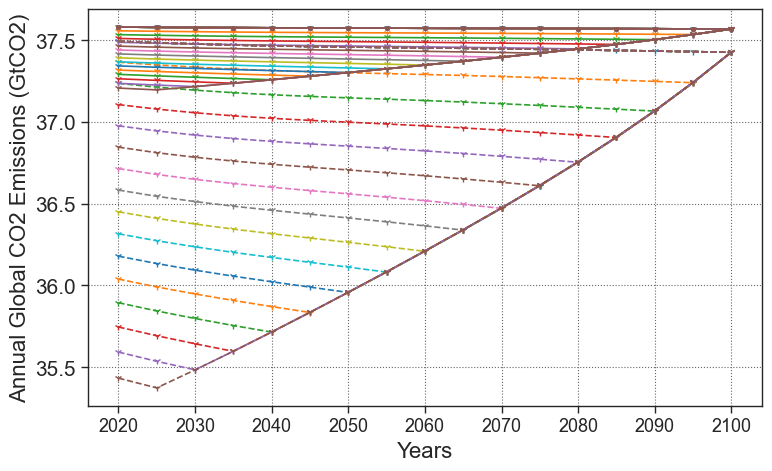

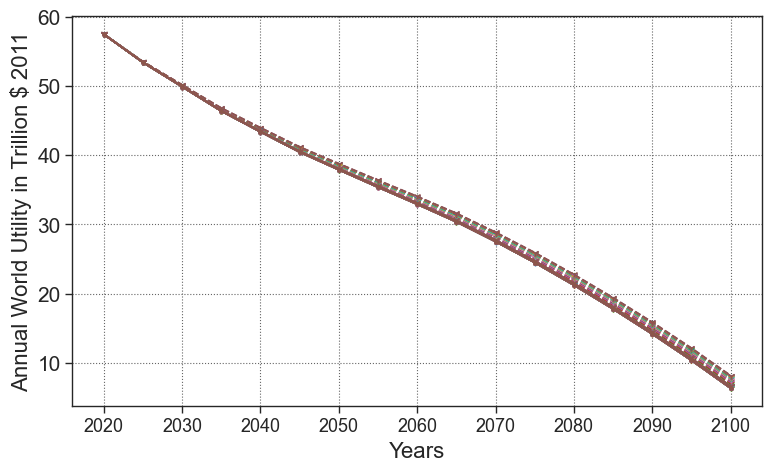

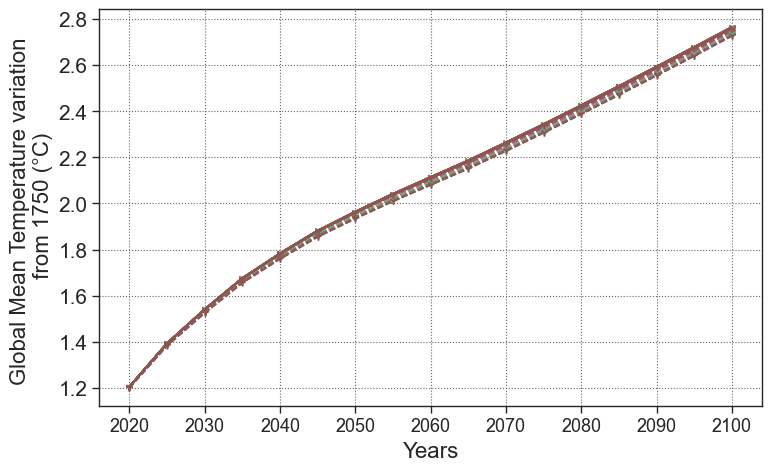

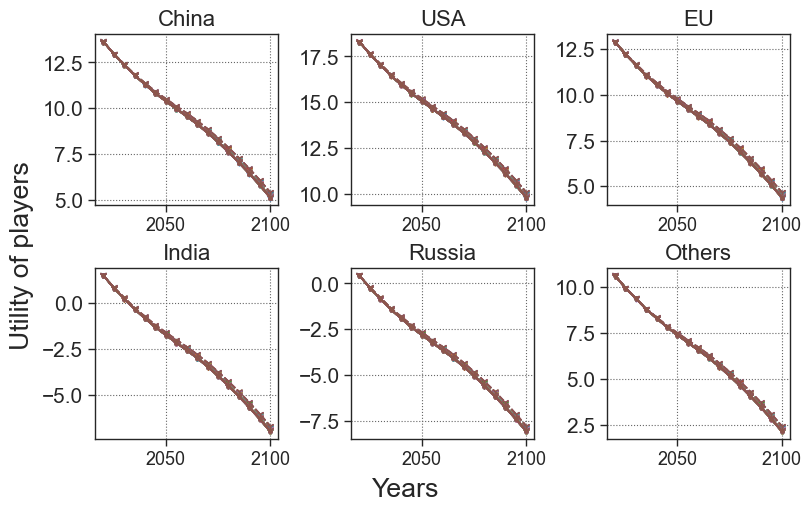

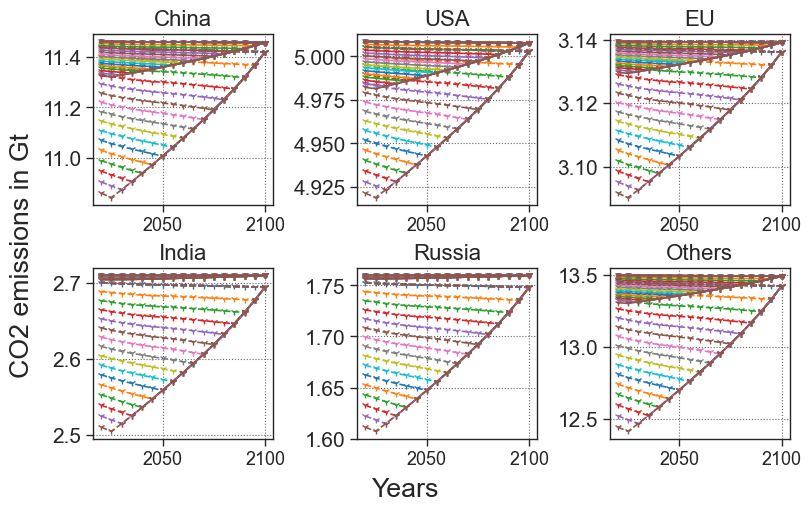

In [ ]:
# puissance de la fonction damage 

# Coefficients de la fonction dammage (pour un polynome de degré 2)

list_damage_coef = [ np.array([0,1]), np.array([0,0,1.1450]), np.array([0,0,0,1])] #, np.array([0,0,0,0,1])]
list_damage_label = [ '$T$', '$1.145T^2$ : [Howard 2017]', '$T^3$'] #,  '$T^4$']

damage_coef = np.flip(np.array([-0.02,0.31,0.1,1.94,-2.0]))

list_ne = []
list_so = []
list_ne_u = []
list_so_u = []
list_ne_planning_u = []
list_so_planning_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
list_ne_planning = []
list_so_planning = []
for t_max in range(1,T) :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, temperature_target= None)

    X = 2020 + np.arange(game.T)*5
    game.repeated_one_shot_game_NE()
    game.reset()

    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)

    game.repeated_one_shot_game_SO()
    game.reset()
    
    game.planning_BRD_by_piece(t_max=t_max)
    game.reset()

    
    list_so.append(game.so_a_p)
    list_so_u.append(game.so_u_p)
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)

    list_ne_planning.append(game.ne_a_planning_brd_piece)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd_piece)
    list_temp_planning.append(game.ne_temp_planning_brd_piece)
    list_ne_planning_u.append(game.ne_u_planning_brd_piece)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd_piece)

    game.planning_SO_by_piece(t_max=t_max)


    list_so_planning.append(game.so_a_planning_piece)
    list_sum_action_planning_so.append(game.so_sum_a_planning_piece)
    list_temp_planning_so.append(game.so_temp_planning_piece)
    list_so_planning_u.append(game.so_u_planning_piece)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning_piece)
    # 
    #  # list_so_planning.append(game.so_a_planning)
    # list_sum_action_planning_so.append(game.so_sum_a_planning)
    # list_temp_planning_so.append(game.so_temp_planning)
    # list_so_planning_u.append(game.so_u_planning)
    # list_sum_utilities_planning_so.append(game.so_sum_u_planning)

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[0], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
# plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_sum_utilities[idx], label=idx, **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
# plt.legend(fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_temp[idx], label=idx)
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
# plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne_u, list_so_u, list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

# plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne, list_so, list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

# plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

In [1]:
import numpy as np 
from scipy.optimize import *

import matplotlib.pyplot as plt
import seaborn as sns

from parameters import *
from models.game_theory_model import *
from models.game import *
from plot_function import *

sns.set_style('ticks',  {"axes.grid" : "True", "grid.color": ".4", "grid.linestyle": ":"})
sns.set_context('paper')
plt.rcParams.update({'mathtext.default':  'regular' })
plt.rcParams['xtick.direction'] = 'out'
plt.rcParams['ytick.labelsize']  =15
plt.rcParams['xtick.labelsize']  =13
plt.rcParams['legend.fontsize']  = 16
plt.rcParams['axes.labelsize' ] = 16
plt.rcParams['font.size'] = '16'
plt.rcParams['axes.titlesize'] = '16'

figsize = (8,5)

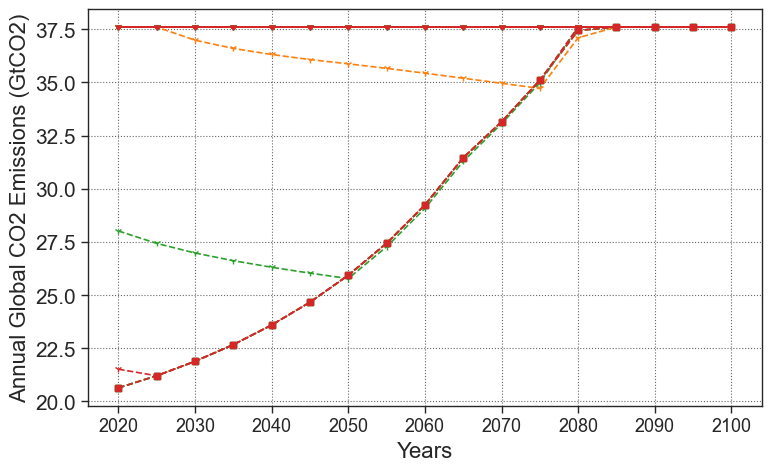

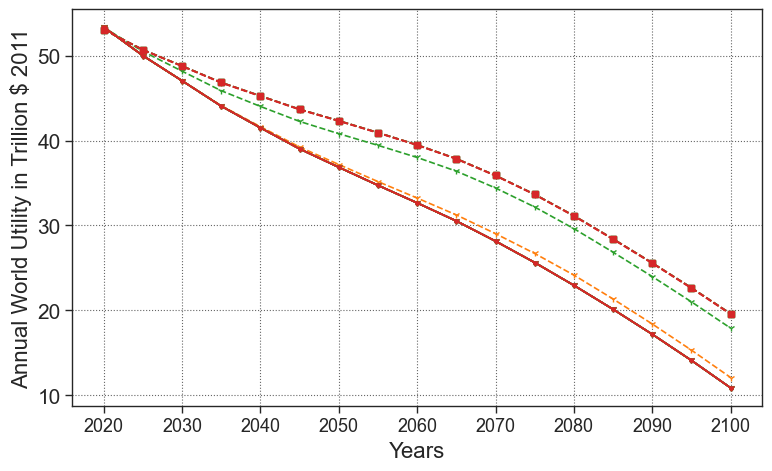

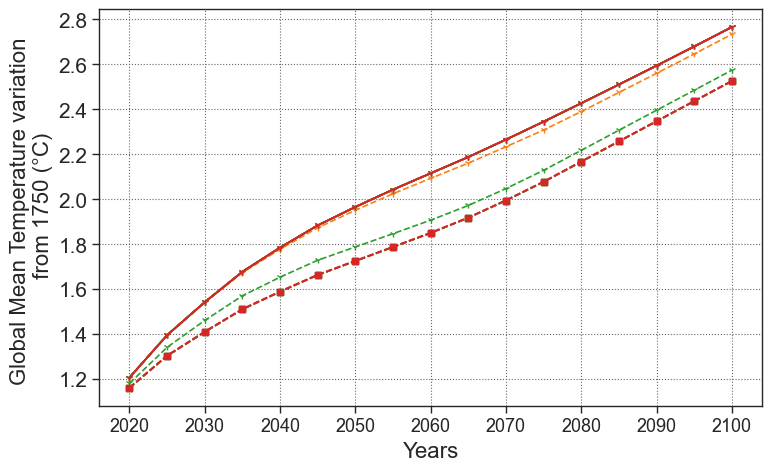

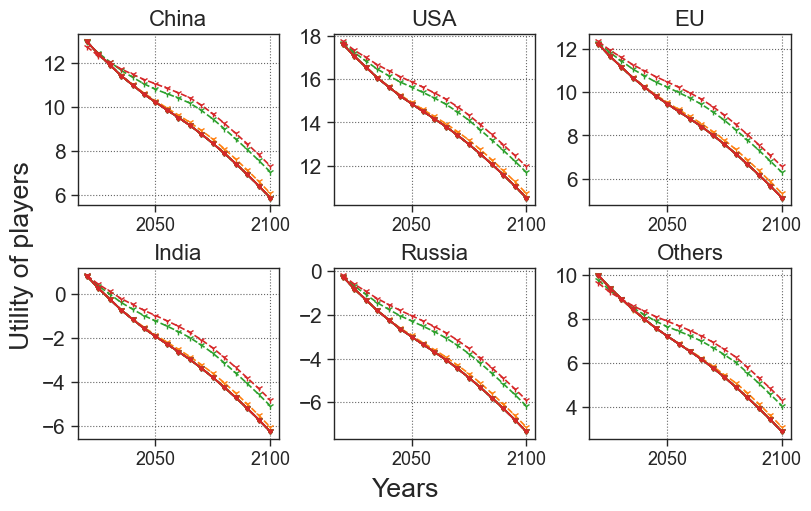

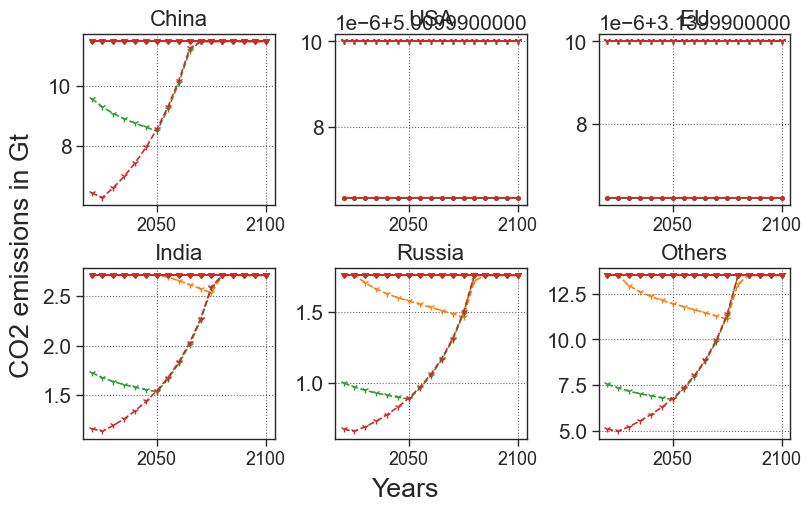

In [2]:
# puissance de la fonction damage 

# Coefficients de la fonction dammage (pour un polynome de degré 2)

list_damage_coef = [ np.array([0,1]), np.array([0,0,1.1450]), np.array([0,0,0,1])] #, np.array([0,0,0,0,1])]
list_damage_label = [ '$T$', '$1.145T^2$ : [Howard 2017]', '$T^3$'] #,  '$T^4$']

damage_coef = np.flip(np.array([0,0,1.145,0,0]))

list_ne = []
list_ne_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []

list_so = []
list_so_u = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []

list_ne_planning = []
list_ne_planning_u = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []

list_so_planning = []
list_so_planning_u = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []

old_list_so_planning = []
old_list_so_planning_u = []
old_list_sum_action_planning_so = []
old_list_sum_utilities_planning_so = []
old_list_temp_planning_so = []

for t_max in range(1,T,5) :
    list_players = create_players(list_benefit_functions=BENEFITS_ROOT,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, temperature_target= None)

    X = 2020 + np.arange(game.T)*5
    game.repeated_one_shot_game_NE()
    game.reset()

    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)

    game.repeated_one_shot_game_SO()
    game.reset()
    
    game.planning_BRD_by_piece(t_max=t_max)
    game.reset()


    
    list_so.append(game.so_a_p)
    list_so_u.append(game.so_u_p)
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)

    list_ne_planning.append(game.ne_a_planning_brd_piece)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd_piece)
    list_temp_planning.append(game.ne_temp_planning_brd_piece)
    list_ne_planning_u.append(game.ne_u_planning_brd_piece)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd_piece)

    game.planning_SO_by_piece(t_max=t_max)
    game.reset()

    game.planning_SO()


    list_so_planning.append(game.so_a_planning_piece)
    list_sum_action_planning_so.append(game.so_sum_a_planning_piece)
    list_temp_planning_so.append(game.so_temp_planning_piece)
    list_so_planning_u.append(game.so_u_planning_piece)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning_piece)
    
    
    old_list_so_planning.append(game.so_a_planning)
    old_list_sum_action_planning_so.append(game.so_sum_a_planning)
    old_list_temp_planning_so.append(game.so_temp_planning)
    old_list_so_planning_u.append(game.so_u_planning)
    old_list_sum_utilities_planning_so.append(game.so_sum_u_planning)
    # 
    #  # list_so_planning.append(game.so_a_planning)
    # list_sum_action_planning_so.append(game.so_sum_a_planning)
    # list_temp_planning_so.append(game.so_temp_planning)
    # list_so_planning_u.append(game.so_u_planning)
    # list_sum_utilities_planning_so.append(game.so_sum_u_planning)

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[0], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )
    plt.plot(X, old_list_sum_action_planning_so[idx], color= p[0].get_color(),marker='s', **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
# plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_sum_utilities[idx], label=idx, **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )
    plt.plot(X, old_list_sum_utilities_planning_so[idx], color= p[0].get_color(),marker='s',**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
# plt.legend(fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_sum_utilities_planning_so) :   
    p = plt.plot(X, list_temp[idx], label=idx)
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)
    plt.plot(X, old_list_temp_planning_so[idx], color= p[0].get_color(),marker='s', **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
# plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
# plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne_u, list_so_u, list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

# plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne, list_so, list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

# plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

In [20]:
def plot_distance(ne, so):
    return so - ne

In [32]:
table = np.zeros((3,T-1))
for idx, sum_utilities in enumerate(list_sum_utilities) :   
    table[0,idx] = np.sum(list_sum_utilities_planning[idx]) 
    table[1,idx] = np.sum(list_sum_utilities_planning_so[idx])
    table[2,idx] = np.sum(list_sum_utilities_planning_so[idx]) - table[0,idx]
    

In [33]:
import pandas as pd

table = pd.DataFrame(table)

In [34]:
table

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,548.760160,549.775661,550.522609,550.922770,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,549.655762,555.091122,558.949012,560.964313,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.895602,5.315461,8.426404,10.041543,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [66]:
[1.81, -1.28, 1.54, -0.53, 0.07]

[1.81, -1.28, 1.54, -0.53, 0.07]

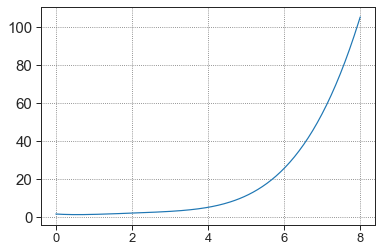

In [9]:
plt.plot(x, damage_polynome(np.array([1.81, -1.28, 1.54, -0.53, 0.07]))(x))


In [4]:
def benefit_root(GDP_max, e_max, percentage_green = 0,s=.5, deg=1):
    x = np.array([1e-10, e_max])
    y = np.array([GDP_max * percentage_green, GDP_max])
    fit = np.poly1d(np.polyfit(x**s, y,deg))
    def benef(x):
        return fit(x**s)
    return benef

In [8]:
f = benefit_root(20,15,s=.05)

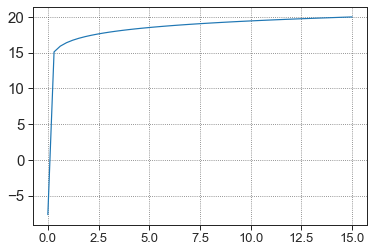

In [9]:
x = np.linspace(0,15)
plt.plot(x,f(x))

In [14]:
def benefit_econmical_shape_( GDP_max, e_max, saving_rate = 0.25,  sigma = 0.16):
    x = np.linspace(0, e_max)
    rho = (sigma -1)/sigma
    capital =  GDP_max * saving_rate
    CO2_intensity = GDP_max/e_max
    plt.plot(x, (capital**rho + (CO2_intensity * x + 0.01)**rho)**(1/rho) )
    print(CO2_intensity)

In [15]:
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets



In [16]:
interact(benefit_econmical_shape_,  GDP_max=50, e_max =11, saving_rate=(0,1,0.02),sigma=(0.01,0.98,0.01))

interactive(children=(IntSlider(value=50, description='GDP_max', max=150, min=-50), IntSlider(value=11, descri…

<function __main__.benefit_econmical_shape_(GDP_max, e_max, saving_rate=0.25, sigma=0.16)>

# TEST

In [1]:
import numpy as np 
from scipy.optimize import *

import matplotlib.pyplot as plt
import seaborn as sns

from parameters import *
from models.game_theory_model import *
from models.game import *
from plot_function import *

sns.set_style('ticks',  {"axes.grid" : "True", "grid.color": ".4", "grid.linestyle": ":"})
sns.set_context('paper')
plt.rcParams.update({'mathtext.default':  'regular' })
plt.rcParams['xtick.direction'] = 'out'
figsize = (8,5)

one_shot_style = { 'marker' : '.' ,'markevery' : 5}
so_style = { 'ls' : '--' }
planning_style = { 'marker' : 's' ,'markevery' : 5}
alpha = 0.7

# puissance de la fonction damage 

# Coefficients de la fonction dammage (pour un polynome de degré 2)


list_damage_coef = [np.array([0,1]), np.array([0,0,1.1450])] #, np.array([0,0.9,0.5,0])] #, np.array([0,0,0,0,1])]
list_damage_label = ['$T$', '$1.145T^2$ : [Howard 2017]'] #, '$2T^2$'] #,  '$T^4$']

In [6]:
def benefit_econmical_shape(GDP_max, e_max, percentage_green):
    sigma = 0.16
    rho = (sigma -1)/sigma
    capital =  GDP_max *0.27
    CO2_intensity = GDP_max / e_max
    def benef(x):
        return ((capital + 0.01)**rho + (CO2_intensity * x + 0.01)**rho)**(1/rho) 
    return benef

BENEFITS_ECOt = [benefit_econmical_shape for i in range(N)]


list_benefit_functions=BENEFITS_ECOt
case = 'eco'
update_allowed = False
horizon = 2100

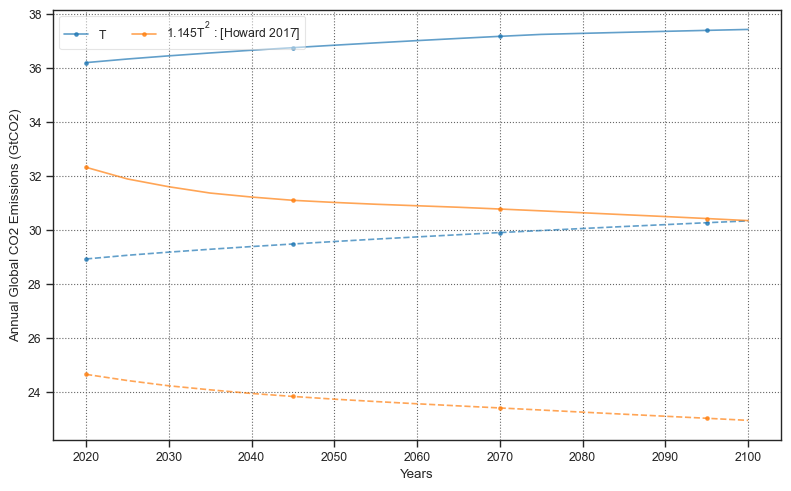

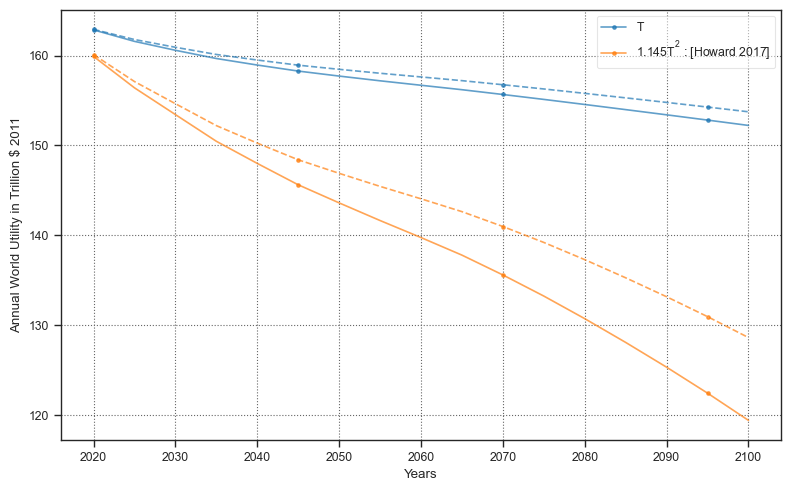

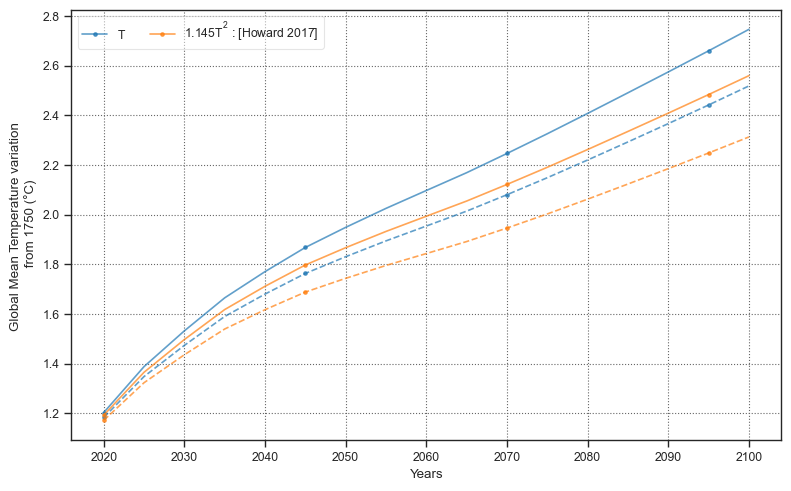

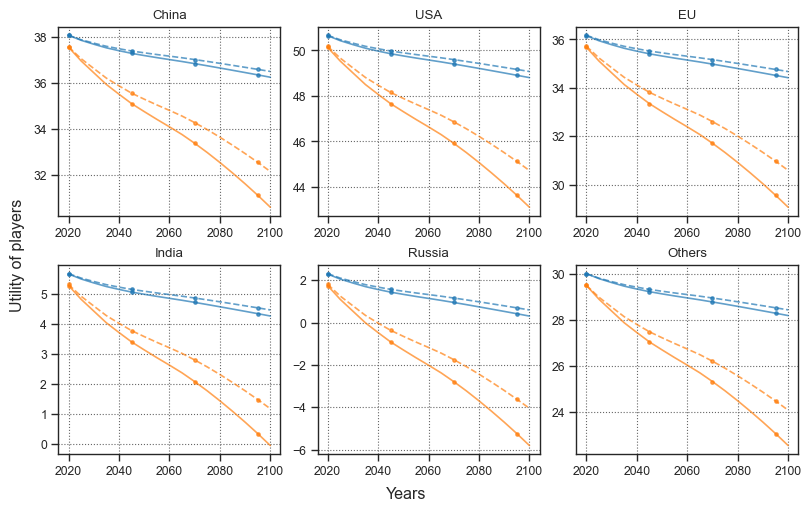

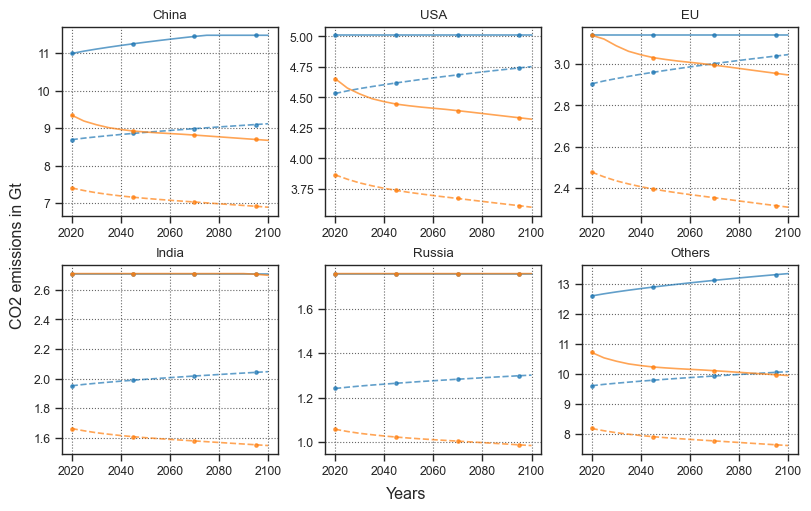

In [7]:
list_ne = []
list_ne_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_so = []
list_so_u = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []


for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, update_allowed=update_allowed)

    X = 2020 + np.arange(game.T)*5
    game.reset()

    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    game.reset()

    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    list_so.append(game.so_a_p)
    list_so_u.append(game.so_u_p)
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)


plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style , alpha = alpha, **one_shot_style)

# plt.plot(X[:len(RCP_26)], RCP_26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(RCP_26)], RCP_60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha, **one_shot_style)

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx], alpha = alpha, **one_shot_style)
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha, **one_shot_style)
# plt.plot(X[:len(temp_RCP26)], temp_RCP26, label="RCP - 2.6", marker="*", color='green', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP85, label="RCP - 8.5",marker="*", color='red', alpha = alpha)
# plt.plot(X[:len(temp_RCP26)], temp_RCP60, label="RCP - 6.0",marker="*", color='blue', alpha = alpha)
plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_{}_RCP_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne_u, list_so_u):
        p = axes[k//3, k%3].plot(X, ne_u[k], alpha = alpha, **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style,alpha = alpha, **one_shot_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')

plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u in zip(list_ne, list_so):
        p = axes[k//3, k%3].plot(X, ne_u[k], alpha = alpha, **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style,alpha = alpha, **one_shot_style)
        # axes[k//3, k%3].plot(X, game.ne_u_val_planning_brd[k],**planning_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
        # axes[k//3, k%3].set_ylim(bottom=-0.2,top=ACTION_SETS[k,1]*1.05, auto=True)

        # if k%3==0:
        #     axes[k//3, k%3].set_ylabel('')
        # if k//3 ==1:
        #     axes[k//3, k%3].set_xlabel('')
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_OS_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

In [4]:
temperature_target = None
final_multiplier = 0

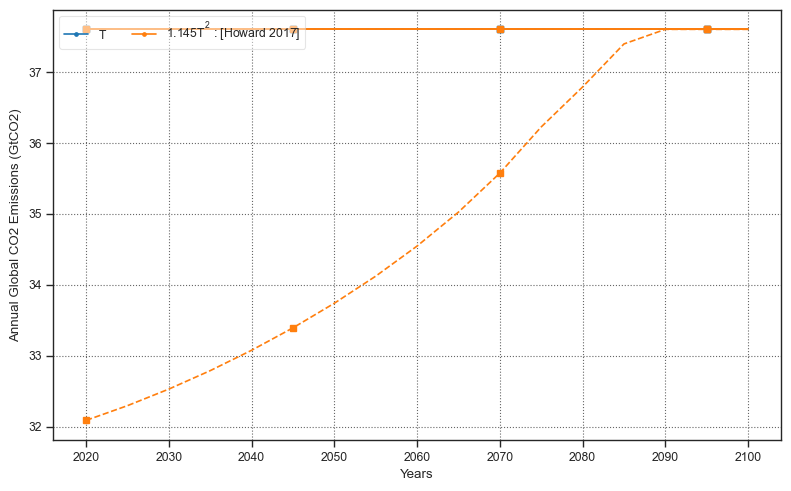

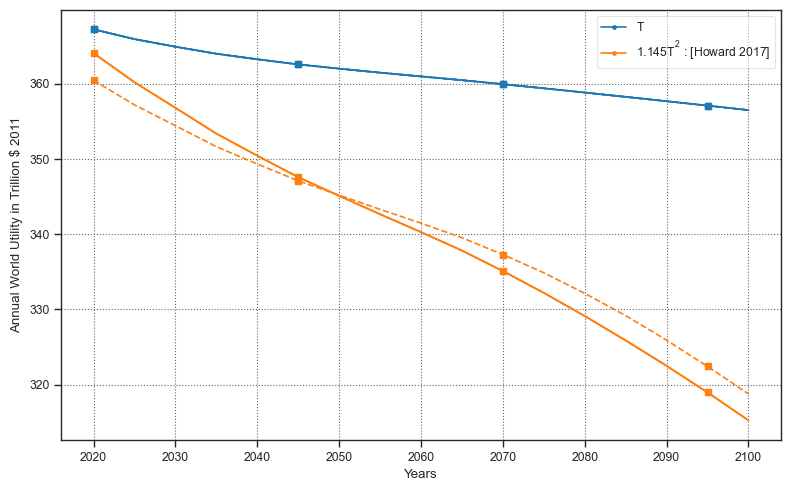

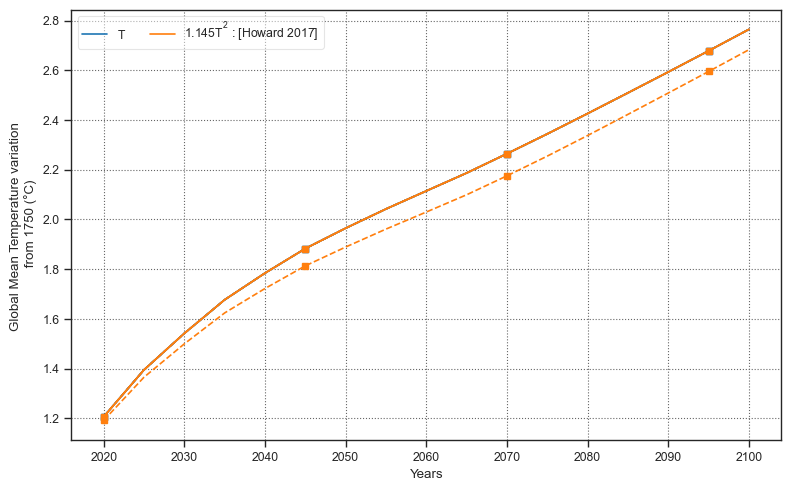

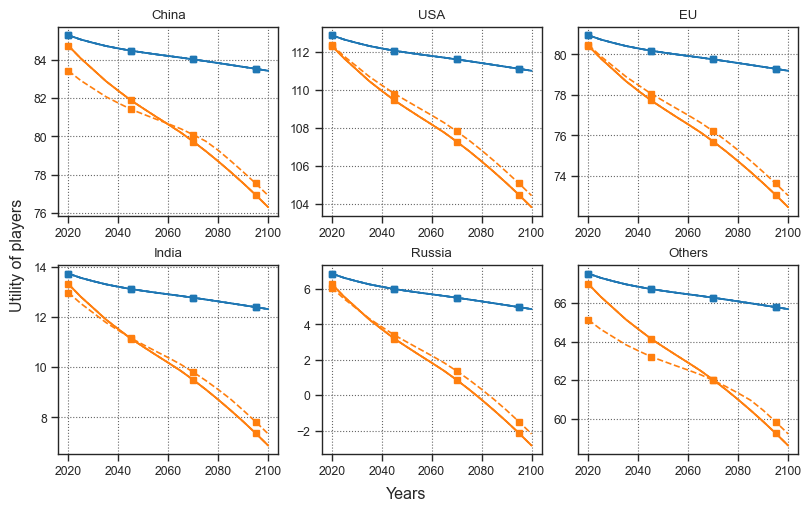

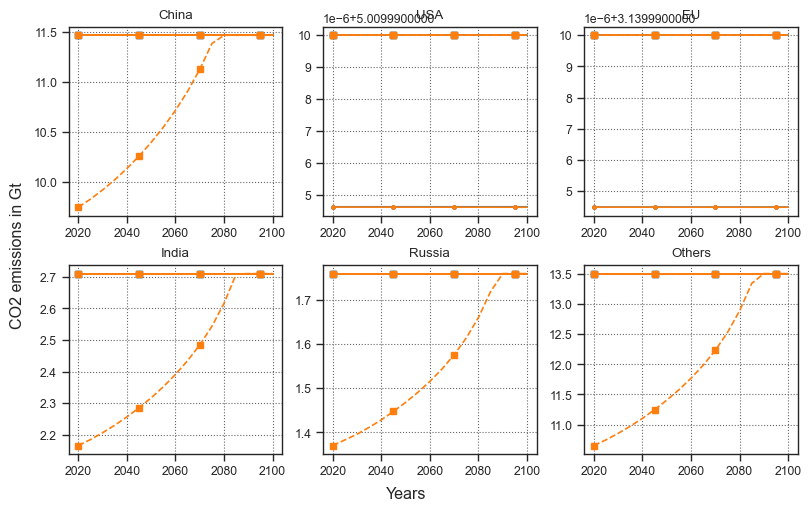

In [5]:
list_ne = []
list_so = []
list_ne_u = []
list_so_u = []
list_ne_planning_u = []
list_so_planning_u = []
list_sum_action = []
list_sum_utilities = []
list_temp = []
list_sum_action_so = []
list_sum_utilities_so = []
list_temp_so = []
list_sum_action_planning = []
list_sum_utilities_planning = []
list_temp_planning = []
list_sum_action_planning_so = []
list_sum_utilities_planning_so = []
list_temp_planning_so = []
list_ne_planning = []
list_so_planning = []
for damage_coef in list_damage_coef :
    list_players = create_players(list_benefit_functions=list_benefit_functions,  damage_function=damage_polynome(damage_coef), discount=1)

    game = Game(list_players, horizon=horizon, temperature_target=temperature_target, final_multiplier = final_multiplier)

    X = 2020 + np.arange(game.T)*5
    game.repeated_one_shot_game_NE()
    game.reset()

    game.repeated_one_shot_game_SO()
    game.reset()
    
    game.planning_BRD()
    game.planning_SO()
    list_ne.append(game.ne_a_p)
    list_ne_u.append(game.ne_u_p)
    list_ne_planning_u.append(game.ne_u_planning_brd)
    
    list_so.append(game.so_a_p)

    list_so_u.append(game.so_u_p)
    list_so_planning_u.append(game.so_u_planning)
    list_sum_action.append(game.ne_sum_a_p)
    list_temp.append(game.ne_temp_p)
    list_sum_utilities.append(game.ne_sum_u_p)
    
    list_sum_action_so.append(game.so_sum_a_p)
    list_temp_so.append(game.so_temp_p)
    list_sum_utilities_so.append(game.so_sum_u_p)

    list_ne_planning.append(game.ne_a_planning_brd)
    list_sum_action_planning.append(game.ne_sum_a_planning_brd)
    list_temp_planning.append(game.ne_temp_planning_brd)
    list_sum_utilities_planning.append(game.ne_sum_u_planning_brd)

    list_so_planning.append(game.so_a_planning)

    list_sum_action_planning_so.append(game.so_sum_a_planning)
    list_temp_planning_so.append(game.so_temp_planning)
    list_sum_utilities_planning_so.append(game.so_sum_u_planning)

plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_action[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_action_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_action_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_action_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style )

plt.ylabel('Annual Global CO2 Emissions (GtCO2)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_Global_CO2_Emission_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

plt.figure(figsize=figsize, dpi=100, tight_layout=True)

for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_sum_utilities[idx], label=list_damage_label[idx], **one_shot_style)
    plt.plot(X, list_sum_utilities_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_sum_utilities_planning[idx], color= p[0].get_color(),**planning_style )
    plt.plot(X, list_sum_utilities_planning_so[idx], color= p[0].get_color(),**planning_style,**so_style )

plt.ylabel('Annual World Utility in Trillion $ 2011')
plt.xlabel('Years')
plt.legend(fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Annual_World_Utility_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()




plt.figure(figsize=figsize, dpi=100, tight_layout=True)
for idx, damage_coef in enumerate(list_damage_coef) :   
    p = plt.plot(X, list_temp[idx], label=list_damage_label[idx])
    plt.plot(X, list_temp_so[idx], color= p[0].get_color(), **so_style, alpha = alpha)
    plt.plot(X, list_temp_planning[idx], color= p[0].get_color(),**planning_style)
    plt.plot(X, list_temp_planning_so[idx], color= p[0].get_color(),**planning_style, **so_style)


plt.ylabel('Global Mean Temperature variation \n from 1750 (°C)')
plt.xlabel('Years')
plt.legend(ncol= 2,loc='upper left',fancybox=True, framealpha=0.5)
plt.savefig(fname="plots_paper/Global_Mean_Temperature_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()


fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)

for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne_u, list_so_u, list_ne_planning_u, list_so_planning_u ):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))

fig.supylabel('Utility of players')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Utilities_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()

fig, axes = plt.subplots(2, 3, dpi = 100, figsize=(8,5), constrained_layout=True)
# fig.tight_layout()
for k in range(N):
    for ne_u, so_u, ne_planning_u, so_planning_u in zip(list_ne, list_so, list_ne_planning, list_so_planning):
        p = axes[k//3, k%3].plot(X, ne_u[k], **one_shot_style)
        axes[k//3, k%3].plot(X, so_u[k], color=p[0].get_color(), **so_style)
        axes[k//3, k%3].plot(X, ne_planning_u[k],color=p[0].get_color(),**planning_style)
        axes[k//3, k%3].plot(X, so_planning_u[k],color=p[0].get_color(),**planning_style, **so_style)
        axes[k//3, k%3].set_title('{}'.format(NAMES[k]))
fig.supylabel('CO2 emissions in Gt')
fig.supxlabel('Years')

plt.savefig(fname="plots_paper/Actions_planning_{}_{}.pdf".format(case, game.horizon), format='pdf')
plt.show()